## Importing Required Libraries

In [14]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.preprocessing import image
from tensorflow.keras.optimizers import RMSprop
from tensorflow.keras import layers
import matplotlib.pyplot as plt
import tensorflow as tf
import numpy as np
import cv2
import os

## Checking Directories

In [16]:
cv2.imread('train1/white-glass/white-glass1.jpg').shape

(177, 285, 3)

## Generator

In [17]:
train = ImageDataGenerator(rescale = 1/255,shear_range = 0.2, zoom_range = 0.2, 
                           brightness_range = (0.1, 0.5), horizontal_flip=True)

In [18]:
train_dataset = train.flow_from_directory('train1',
                                         target_size = (200, 200),
                                         batch_size = 8,
                                         class_mode = 'categorical')

Found 5586 images belonging to 5 classes.


In [19]:
train_dataset.class_indices

{'compost': 0, 'metal': 1, 'paper': 2, 'plastic': 3, 'white-glass': 4}

## Model

In [20]:
vgg16 = VGG16(input_shape = (200, 200, 3), weights = "imagenet", include_top = False)

In [21]:
for layer in vgg16.layers:
    layer.trainable = False

In [22]:
x = layers.Flatten()(vgg16.output)

In [23]:
prediction = layers.Dense(units = 5, activation="sigmoid")(x)
model = tf.keras.models.Model(inputs = vgg16.input, outputs=prediction)
model.summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 200, 200, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 200, 200, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 200, 200, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 100, 100, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 100, 100, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 100, 100, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 50, 50, 128)       0   

## Compiling and Fitting Model

In [24]:
model.compile(optimizer="adam", loss="categorical_crossentropy", metrics =["accuracy"])
result = model.fit_generator(train_dataset, epochs = 7, steps_per_epoch=256)

Epoch 1/7
256/256 [==============================] - 267s 1s/step - loss: 1.4177 - accuracy: 0.4760
Epoch 2/7
256/256 [==============================] - 301s 1s/step - loss: 1.0893 - accuracy: 0.5914
Epoch 3/7
256/256 [==============================] - 307s 1s/step - loss: 1.0254 - accuracy: 0.6197
Epoch 4/7
256/256 [==============================] - 287s 1s/step - loss: 0.8107 - accuracy: 0.7016
Epoch 5/7
256/256 [==============================] - 287s 1s/step - loss: 0.8455 - accuracy: 0.6980
Epoch 6/7
256/256 [==============================] - 286s 1s/step - loss: 0.8725 - accuracy: 0.6870
Epoch 7/7
256/256 [==============================] - 285s 1s/step - loss: 0.8209 - accuracy: 0.7034


## Prediction

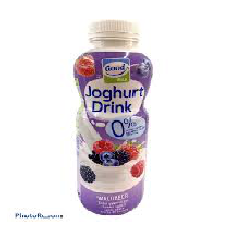

plastic  with  40.23  % accuracy
 Non - Biodegradable


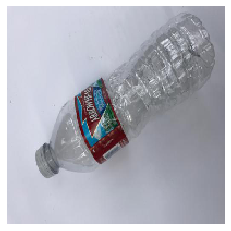

metal  with  21.59  % accuracy
 Non - Biodegradable


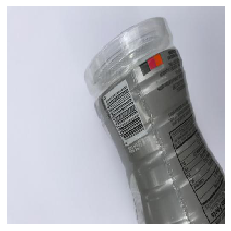

metal  with  91.14  % accuracy
 Non - Biodegradable


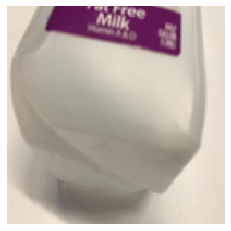

white-glass  with  7.63  % accuracy
 Non - Biodegradable


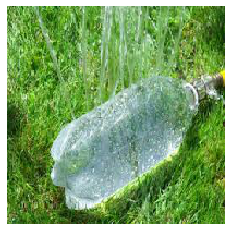

compost  with  99.92  % accuracy
 Biodegradable


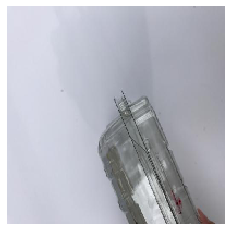

plastic  with  54.24  % accuracy
 Non - Biodegradable


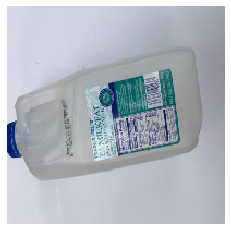

plastic  with  20.08  % accuracy
 Non - Biodegradable


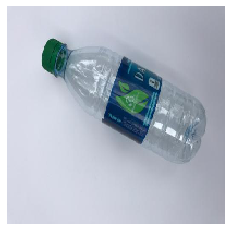

plastic  with  89.38  % accuracy
 Non - Biodegradable


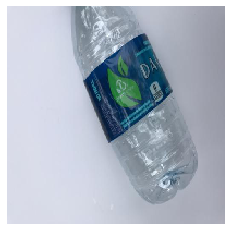

plastic  with  22.39  % accuracy
 Non - Biodegradable


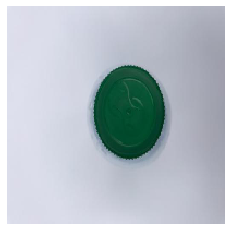

plastic  with  98.85  % accuracy
 Non - Biodegradable


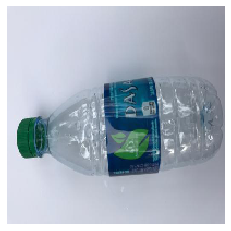

plastic  with  98.6  % accuracy
 Non - Biodegradable


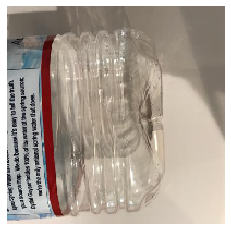

metal  with  13.11  % accuracy
 Non - Biodegradable


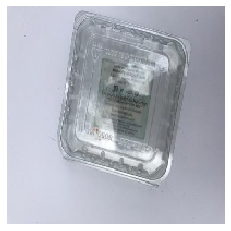

metal  with  68.72  % accuracy
 Non - Biodegradable


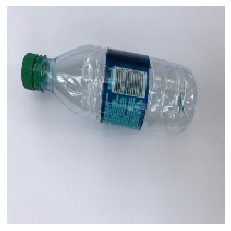

white-glass  with  60.6  % accuracy
 Non - Biodegradable


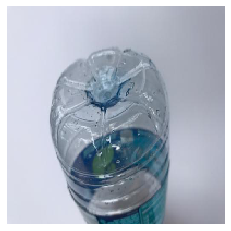

metal  with  27.38  % accuracy
 Non - Biodegradable


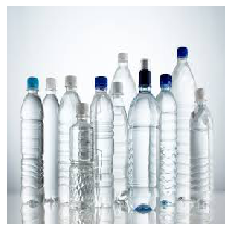

plastic  with  26.07  % accuracy
 Non - Biodegradable


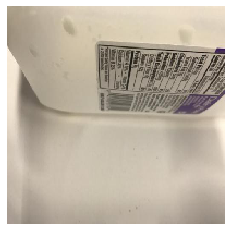

white-glass  with  55.01  % accuracy
 Non - Biodegradable


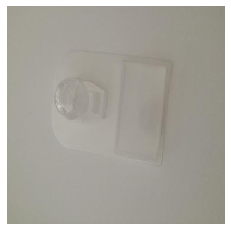

white-glass  with  82.51  % accuracy
 Non - Biodegradable


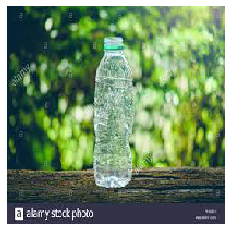

compost  with  56.3  % accuracy
 Biodegradable


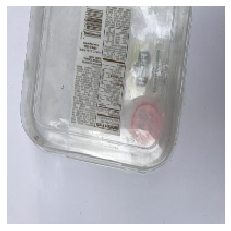

white-glass  with  14.27  % accuracy
 Non - Biodegradable


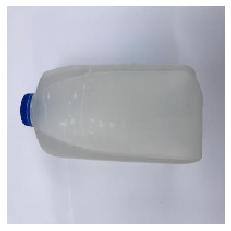

plastic  with  15.46  % accuracy
 Non - Biodegradable


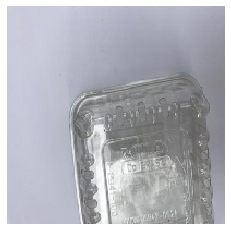

metal  with  71.99  % accuracy
 Non - Biodegradable


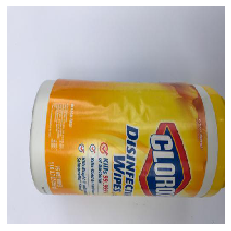

plastic  with  28.18  % accuracy
 Non - Biodegradable


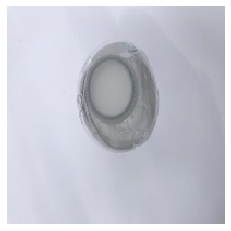

metal  with  95.49  % accuracy
 Non - Biodegradable


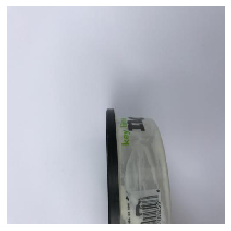

plastic  with  87.08  % accuracy
 Non - Biodegradable


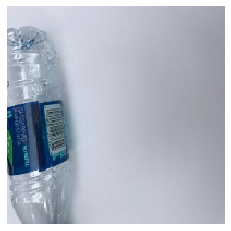

metal  with  42.76  % accuracy
 Non - Biodegradable


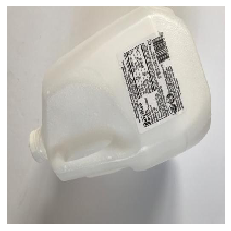

white-glass  with  90.86  % accuracy
 Non - Biodegradable


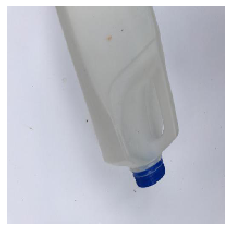

white-glass  with  86.66  % accuracy
 Non - Biodegradable


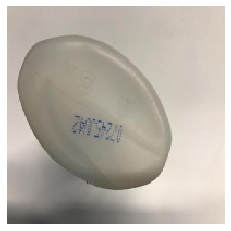

metal  with  63.4  % accuracy
 Non - Biodegradable


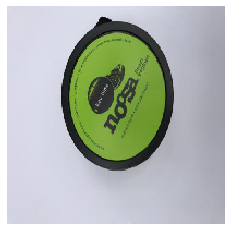

plastic  with  73.36  % accuracy
 Non - Biodegradable


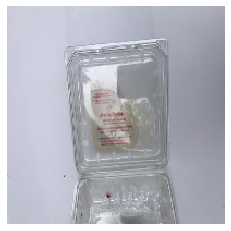

metal  with  93.76  % accuracy
 Non - Biodegradable


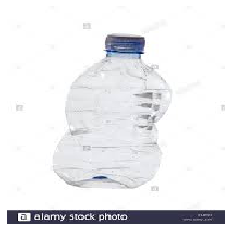

plastic  with  75.97  % accuracy
 Non - Biodegradable


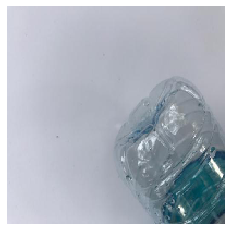

white-glass  with  63.94  % accuracy
 Non - Biodegradable


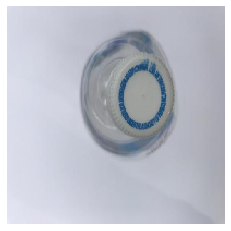

metal  with  69.98  % accuracy
 Non - Biodegradable


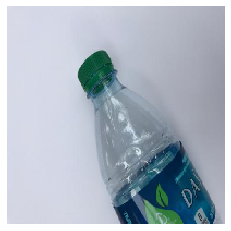

plastic  with  90.38  % accuracy
 Non - Biodegradable


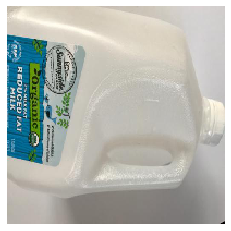

plastic  with  4.37  % accuracy
 Non - Biodegradable


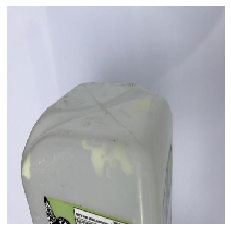

compost  with  13.7  % accuracy
 Biodegradable


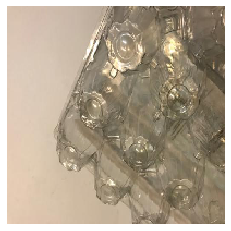

metal  with  71.37  % accuracy
 Non - Biodegradable


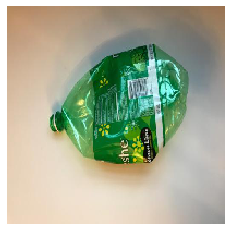

plastic  with  88.03  % accuracy
 Non - Biodegradable


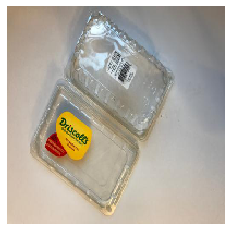

metal  with  49.03  % accuracy
 Non - Biodegradable


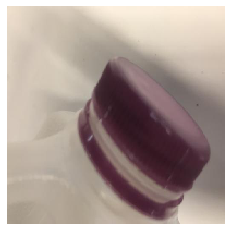

metal  with  39.8  % accuracy
 Non - Biodegradable


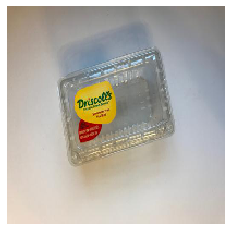

metal  with  96.26  % accuracy
 Non - Biodegradable


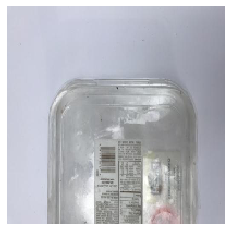

white-glass  with  87.72  % accuracy
 Non - Biodegradable


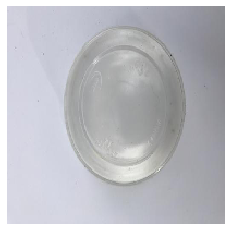

metal  with  90.52  % accuracy
 Non - Biodegradable


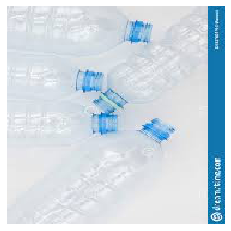

plastic  with  86.93  % accuracy
 Non - Biodegradable


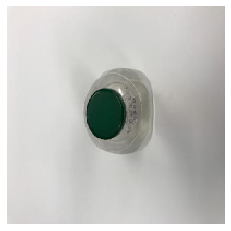

metal  with  83.61  % accuracy
 Non - Biodegradable


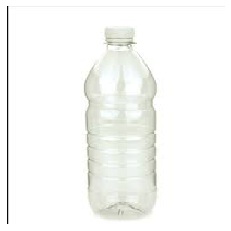

plastic  with  86.68  % accuracy
 Non - Biodegradable


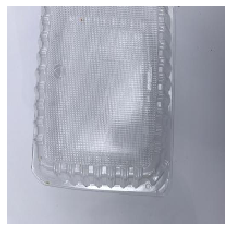

white-glass  with  74.09  % accuracy
 Non - Biodegradable


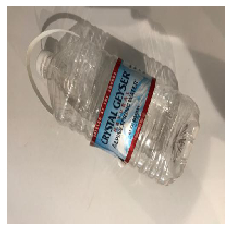

plastic  with  8.11  % accuracy
 Non - Biodegradable


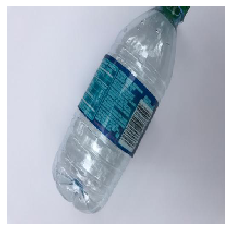

plastic  with  71.33  % accuracy
 Non - Biodegradable


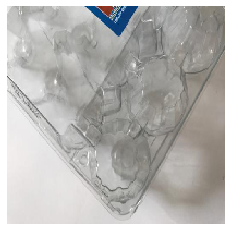

paper  with  11.92  % accuracy
 Biodegradable


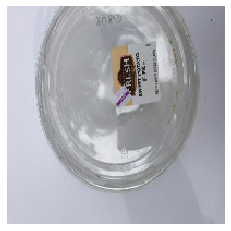

metal  with  38.7  % accuracy
 Non - Biodegradable


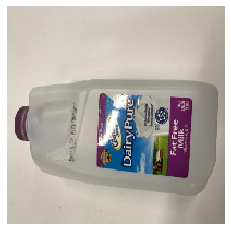

plastic  with  93.37  % accuracy
 Non - Biodegradable


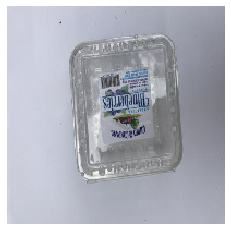

plastic  with  91.88  % accuracy
 Non - Biodegradable


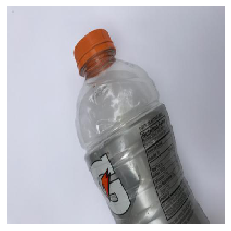

plastic  with  51.25  % accuracy
 Non - Biodegradable


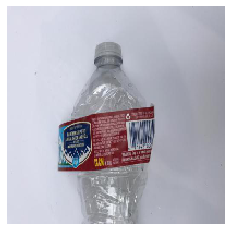

plastic  with  92.32  % accuracy
 Non - Biodegradable


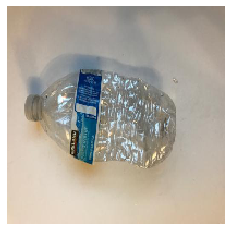

metal  with  31.08  % accuracy
 Non - Biodegradable


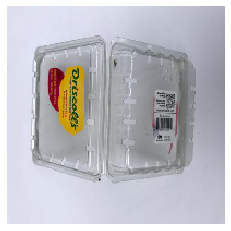

metal  with  61.1  % accuracy
 Non - Biodegradable


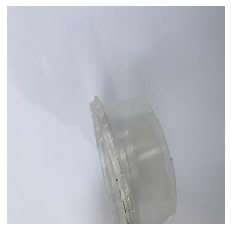

white-glass  with  82.63  % accuracy
 Non - Biodegradable


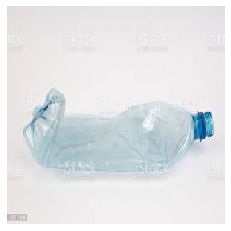

plastic  with  78.1  % accuracy
 Non - Biodegradable


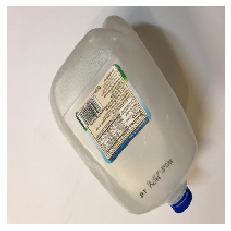

metal  with  4.88  % accuracy
 Non - Biodegradable


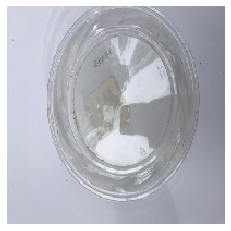

metal  with  83.61  % accuracy
 Non - Biodegradable


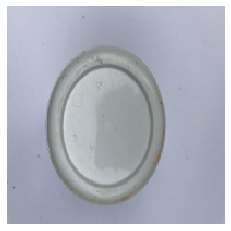

metal  with  93.05  % accuracy
 Non - Biodegradable


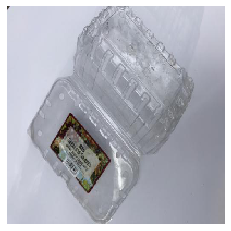

white-glass  with  22.46  % accuracy
 Non - Biodegradable


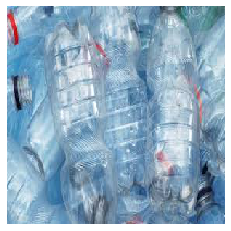

compost  with  4.38  % accuracy
 Biodegradable


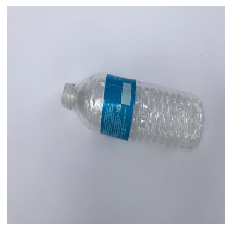

plastic  with  91.63  % accuracy
 Non - Biodegradable


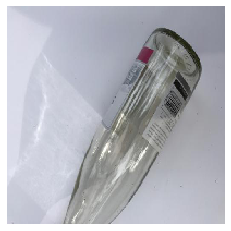

white-glass  with  99.14  % accuracy
 Non - Biodegradable


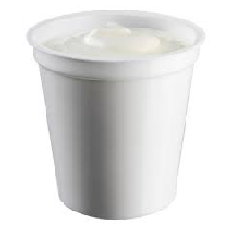

metal  with  97.03  % accuracy
 Non - Biodegradable


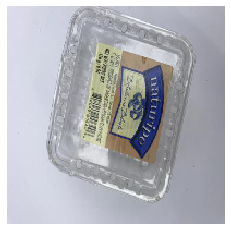

plastic  with  45.94  % accuracy
 Non - Biodegradable


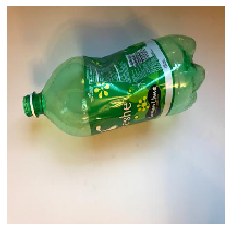

white-glass  with  94.68  % accuracy
 Non - Biodegradable


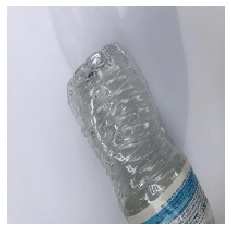

metal  with  81.15  % accuracy
 Non - Biodegradable


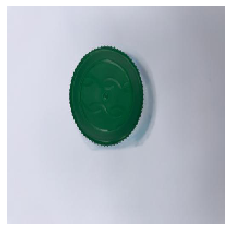

plastic  with  97.21  % accuracy
 Non - Biodegradable


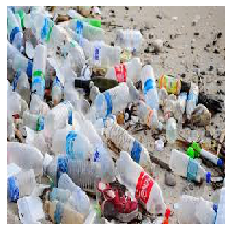

compost  with  82.12  % accuracy
 Biodegradable


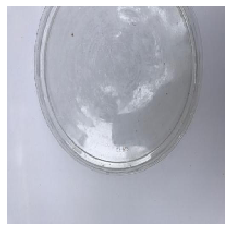

white-glass  with  64.08  % accuracy
 Non - Biodegradable


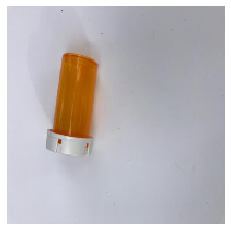

white-glass  with  25.15  % accuracy
 Non - Biodegradable


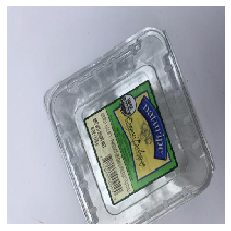

plastic  with  14.75  % accuracy
 Non - Biodegradable


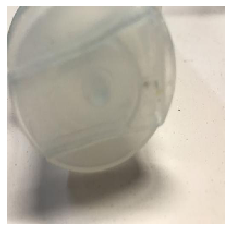

white-glass  with  49.96  % accuracy
 Non - Biodegradable


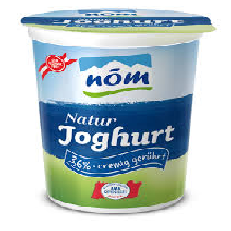

plastic  with  99.01  % accuracy
 Non - Biodegradable


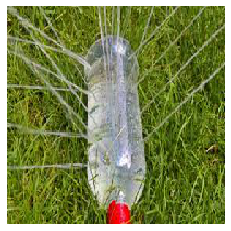

compost  with  92.61  % accuracy
 Biodegradable


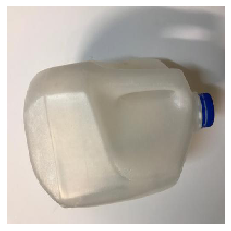

metal  with  74.85  % accuracy
 Non - Biodegradable


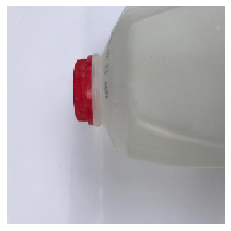

white-glass  with  30.0  % accuracy
 Non - Biodegradable


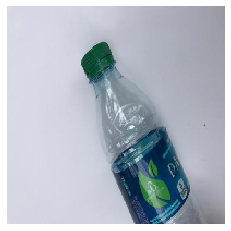

plastic  with  94.74  % accuracy
 Non - Biodegradable


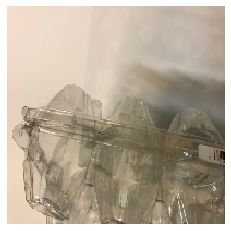

white-glass  with  41.62  % accuracy
 Non - Biodegradable


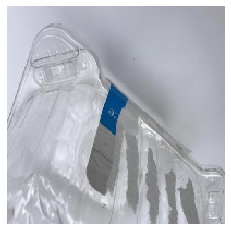

white-glass  with  1.94  % accuracy
 Non - Biodegradable


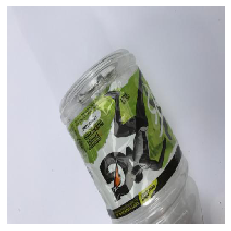

metal  with  93.43  % accuracy
 Non - Biodegradable


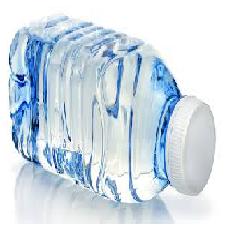

plastic  with  0.24  % accuracy
 Non - Biodegradable


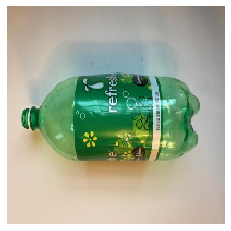

plastic  with  96.92  % accuracy
 Non - Biodegradable


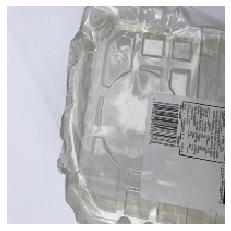

plastic  with  24.32  % accuracy
 Non - Biodegradable


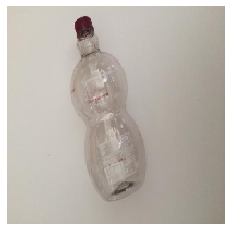

compost  with  41.14  % accuracy
 Biodegradable


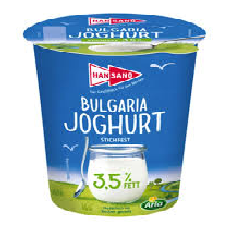

plastic  with  99.86  % accuracy
 Non - Biodegradable


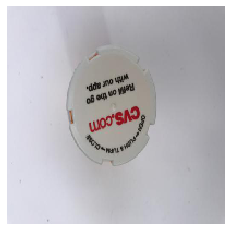

plastic  with  99.05  % accuracy
 Non - Biodegradable


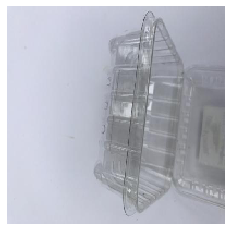

plastic  with  76.14  % accuracy
 Non - Biodegradable


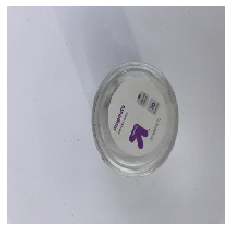

plastic  with  80.62  % accuracy
 Non - Biodegradable


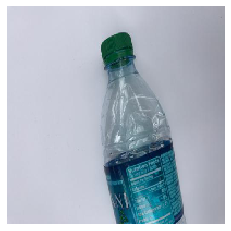

plastic  with  98.73  % accuracy
 Non - Biodegradable


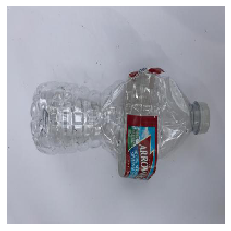

white-glass  with  69.06  % accuracy
 Non - Biodegradable


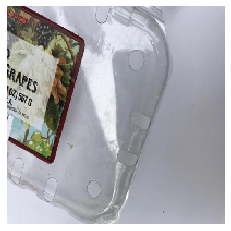

metal  with  6.68  % accuracy
 Non - Biodegradable


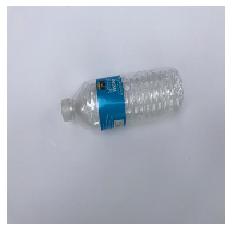

plastic  with  83.72  % accuracy
 Non - Biodegradable


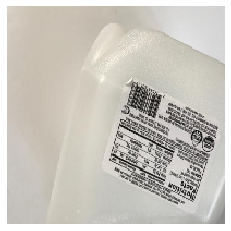

paper  with  80.76  % accuracy
 Biodegradable


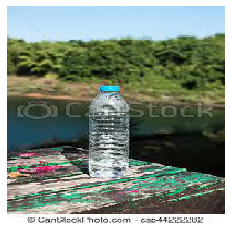

compost  with  0.46  % accuracy
 Biodegradable


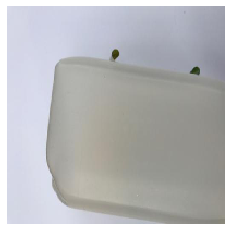

metal  with  18.69  % accuracy
 Non - Biodegradable


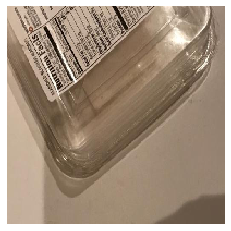

white-glass  with  84.8  % accuracy
 Non - Biodegradable


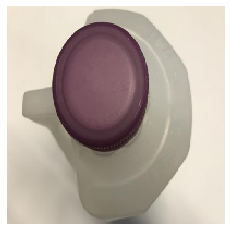

metal  with  76.31  % accuracy
 Non - Biodegradable


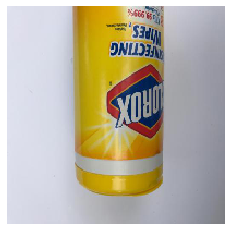

metal  with  86.14  % accuracy
 Non - Biodegradable


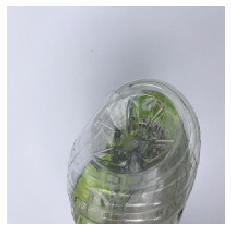

metal  with  96.97  % accuracy
 Non - Biodegradable


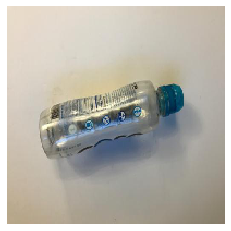

metal  with  41.73  % accuracy
 Non - Biodegradable


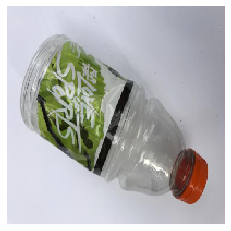

metal  with  1.51  % accuracy
 Non - Biodegradable


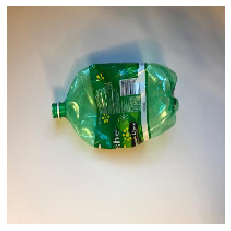

plastic  with  75.5  % accuracy
 Non - Biodegradable


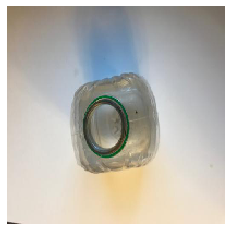

metal  with  95.56  % accuracy
 Non - Biodegradable


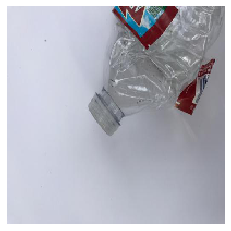

paper  with  7.36  % accuracy
 Biodegradable


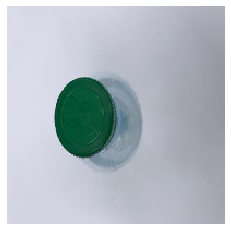

plastic  with  96.67  % accuracy
 Non - Biodegradable


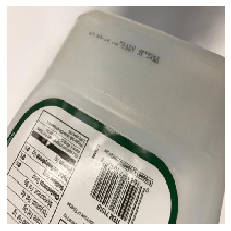

paper  with  2.51  % accuracy
 Biodegradable


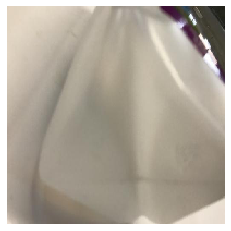

paper  with  63.9  % accuracy
 Biodegradable


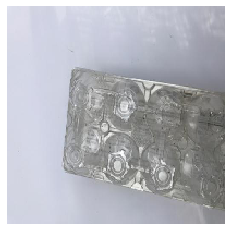

white-glass  with  21.68  % accuracy
 Non - Biodegradable


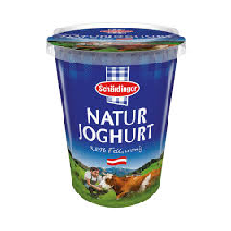

plastic  with  95.22  % accuracy
 Non - Biodegradable


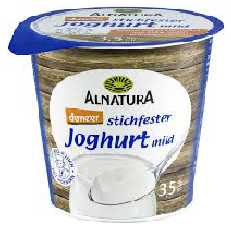

plastic  with  95.49  % accuracy
 Non - Biodegradable


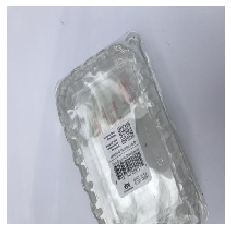

plastic  with  8.48  % accuracy
 Non - Biodegradable


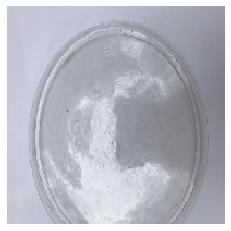

white-glass  with  91.36  % accuracy
 Non - Biodegradable


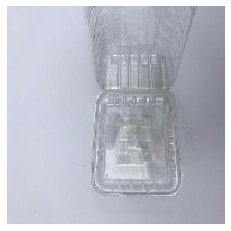

white-glass  with  90.81  % accuracy
 Non - Biodegradable


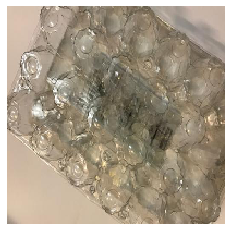

metal  with  76.52  % accuracy
 Non - Biodegradable


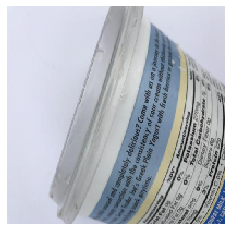

paper  with  67.86  % accuracy
 Biodegradable


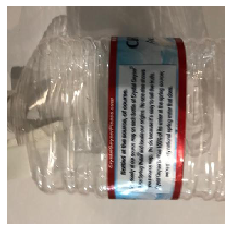

plastic  with  18.64  % accuracy
 Non - Biodegradable


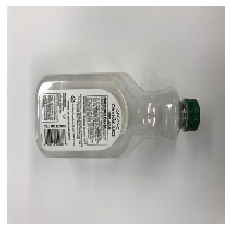

metal  with  70.95  % accuracy
 Non - Biodegradable


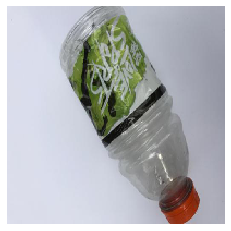

metal  with  11.63  % accuracy
 Non - Biodegradable


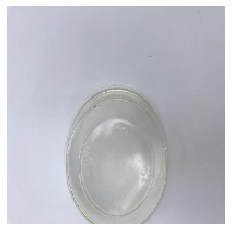

metal  with  85.16  % accuracy
 Non - Biodegradable


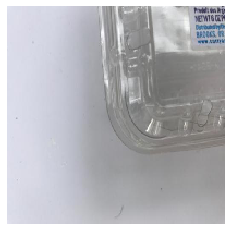

white-glass  with  95.69  % accuracy
 Non - Biodegradable


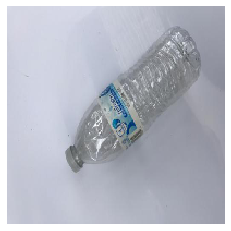

plastic  with  74.1  % accuracy
 Non - Biodegradable


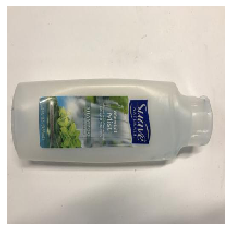

plastic  with  78.9  % accuracy
 Non - Biodegradable


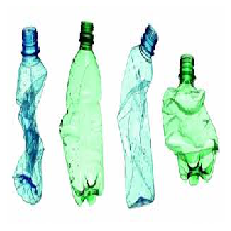

plastic  with  82.05  % accuracy
 Non - Biodegradable


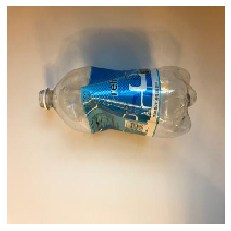

plastic  with  17.14  % accuracy
 Non - Biodegradable


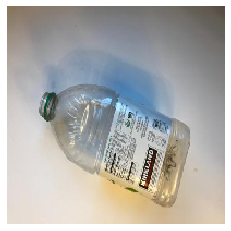

plastic  with  93.18  % accuracy
 Non - Biodegradable


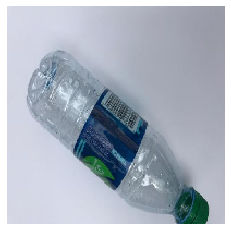

plastic  with  94.69  % accuracy
 Non - Biodegradable


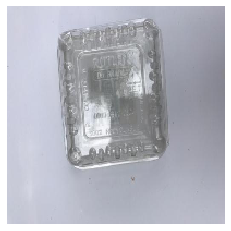

metal  with  84.7  % accuracy
 Non - Biodegradable


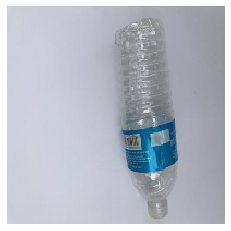

plastic  with  83.94  % accuracy
 Non - Biodegradable


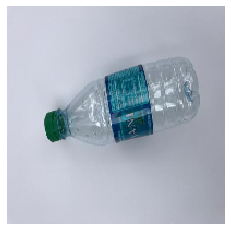

plastic  with  87.12  % accuracy
 Non - Biodegradable


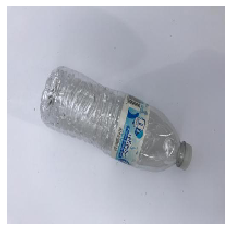

plastic  with  69.82  % accuracy
 Non - Biodegradable


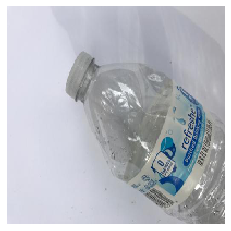

plastic  with  13.06  % accuracy
 Non - Biodegradable


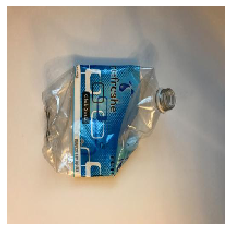

metal  with  80.0  % accuracy
 Non - Biodegradable


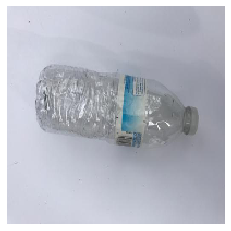

plastic  with  72.43  % accuracy
 Non - Biodegradable


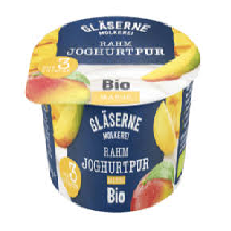

plastic  with  77.43  % accuracy
 Non - Biodegradable


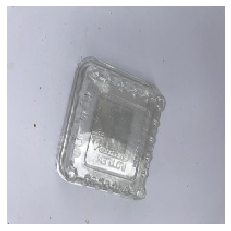

white-glass  with  91.58  % accuracy
 Non - Biodegradable


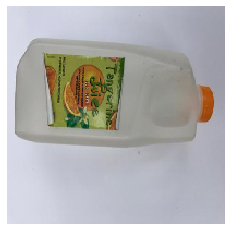

plastic  with  29.58  % accuracy
 Non - Biodegradable


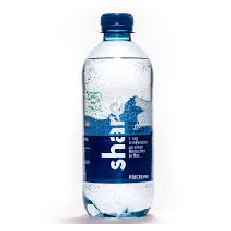

plastic  with  100.0  % accuracy
 Non - Biodegradable


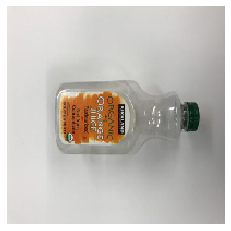

plastic  with  47.04  % accuracy
 Non - Biodegradable


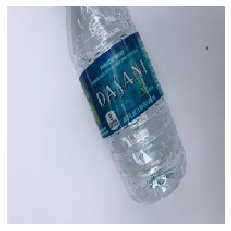

plastic  with  78.04  % accuracy
 Non - Biodegradable


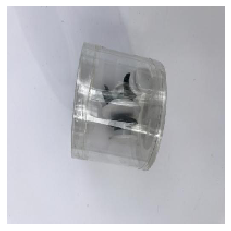

plastic  with  65.2  % accuracy
 Non - Biodegradable


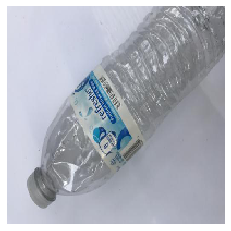

metal  with  52.94  % accuracy
 Non - Biodegradable


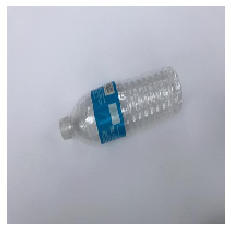

plastic  with  90.18  % accuracy
 Non - Biodegradable


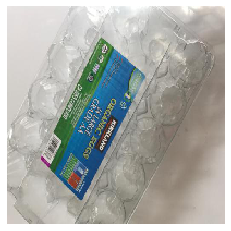

plastic  with  45.98  % accuracy
 Non - Biodegradable


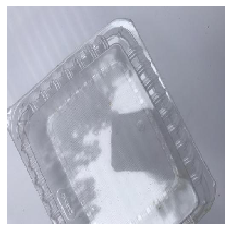

metal  with  43.03  % accuracy
 Non - Biodegradable


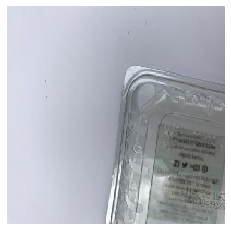

metal  with  93.97  % accuracy
 Non - Biodegradable


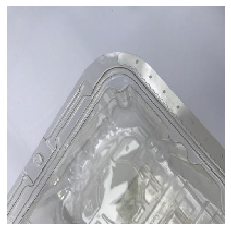

metal  with  94.53  % accuracy
 Non - Biodegradable


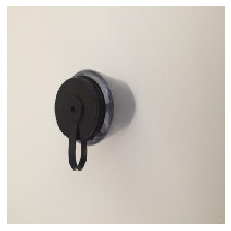

compost  with  26.98  % accuracy
 Biodegradable


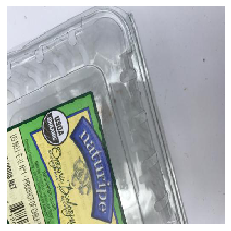

paper  with  49.24  % accuracy
 Biodegradable


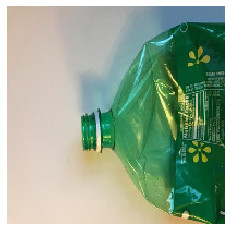

plastic  with  13.62  % accuracy
 Non - Biodegradable


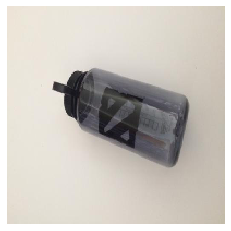

plastic  with  70.82  % accuracy
 Non - Biodegradable


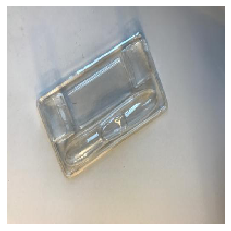

metal  with  76.64  % accuracy
 Non - Biodegradable


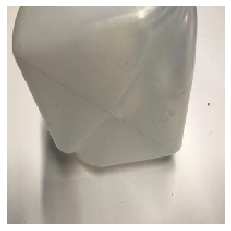

compost  with  5.39  % accuracy
 Biodegradable


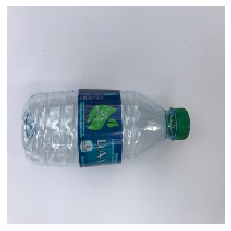

plastic  with  98.09  % accuracy
 Non - Biodegradable


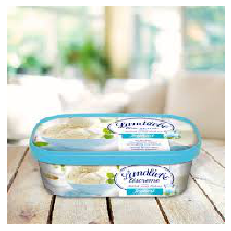

compost  with  8.42  % accuracy
 Biodegradable


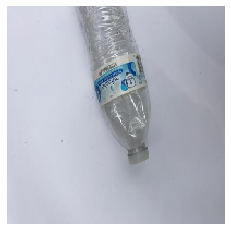

white-glass  with  17.09  % accuracy
 Non - Biodegradable


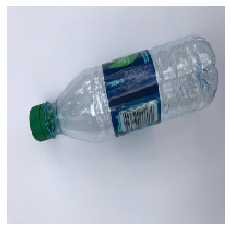

plastic  with  95.05  % accuracy
 Non - Biodegradable


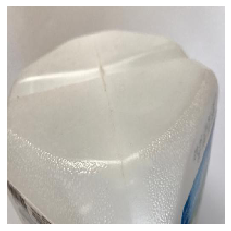

compost  with  40.67  % accuracy
 Biodegradable


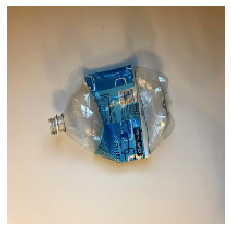

metal  with  53.54  % accuracy
 Non - Biodegradable


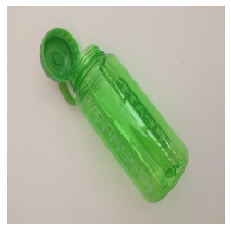

plastic  with  95.02  % accuracy
 Non - Biodegradable


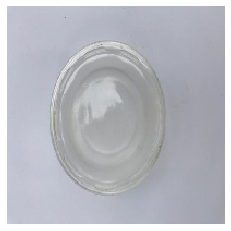

metal  with  95.92  % accuracy
 Non - Biodegradable


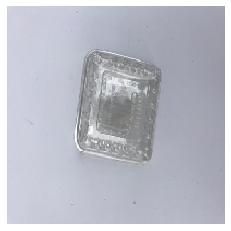

white-glass  with  97.99  % accuracy
 Non - Biodegradable


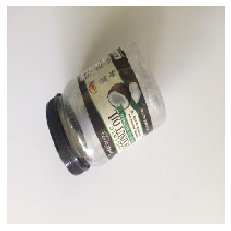

metal  with  94.64  % accuracy
 Non - Biodegradable


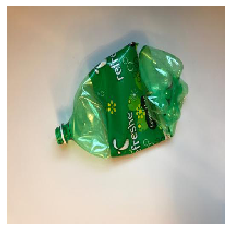

plastic  with  71.57  % accuracy
 Non - Biodegradable


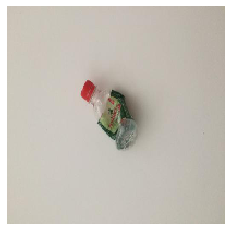

plastic  with  42.15  % accuracy
 Non - Biodegradable


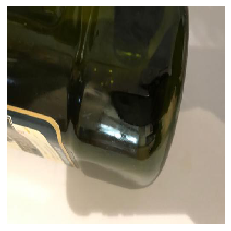

white-glass  with  83.04  % accuracy
 Non - Biodegradable


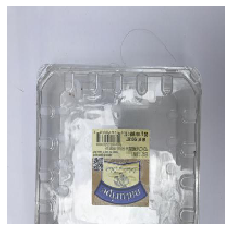

plastic  with  66.73  % accuracy
 Non - Biodegradable


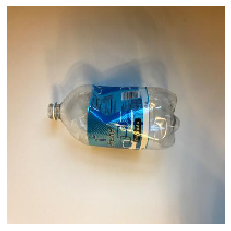

plastic  with  70.44  % accuracy
 Non - Biodegradable


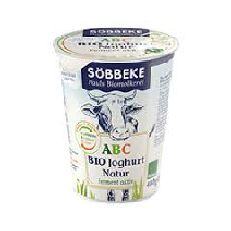

plastic  with  41.26  % accuracy
 Non - Biodegradable


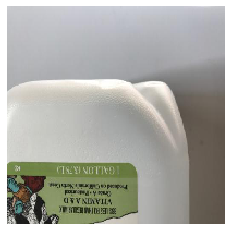

compost  with  4.42  % accuracy
 Biodegradable


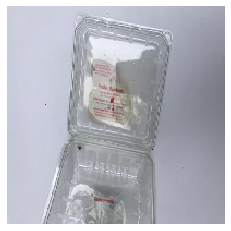

metal  with  94.07  % accuracy
 Non - Biodegradable


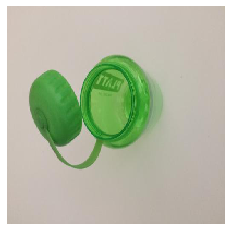

plastic  with  79.74  % accuracy
 Non - Biodegradable


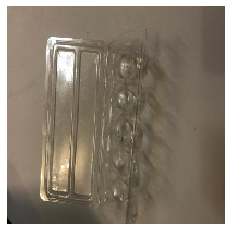

white-glass  with  99.2  % accuracy
 Non - Biodegradable


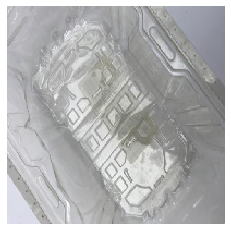

white-glass  with  26.29  % accuracy
 Non - Biodegradable


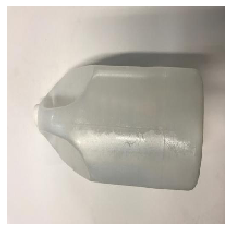

metal  with  96.97  % accuracy
 Non - Biodegradable


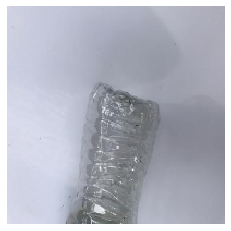

white-glass  with  69.57  % accuracy
 Non - Biodegradable


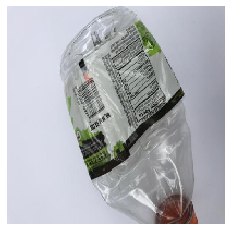

plastic  with  13.68  % accuracy
 Non - Biodegradable


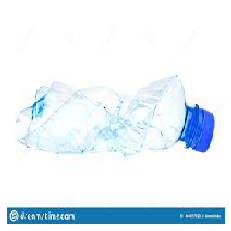

plastic  with  98.05  % accuracy
 Non - Biodegradable


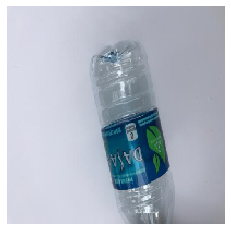

plastic  with  96.68  % accuracy
 Non - Biodegradable


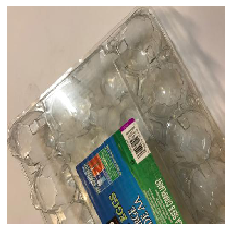

paper  with  67.05  % accuracy
 Biodegradable


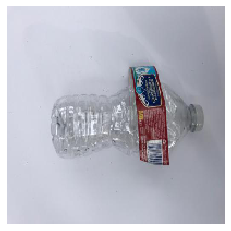

white-glass  with  70.7  % accuracy
 Non - Biodegradable


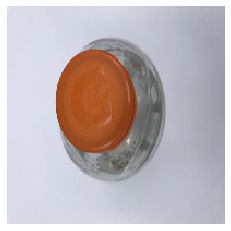

metal  with  36.4  % accuracy
 Non - Biodegradable


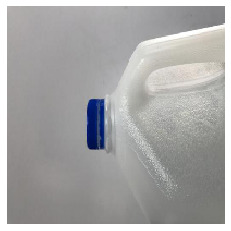

white-glass  with  35.49  % accuracy
 Non - Biodegradable


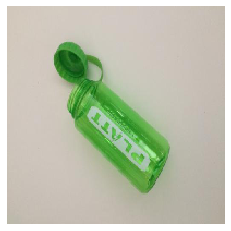

plastic  with  99.26  % accuracy
 Non - Biodegradable


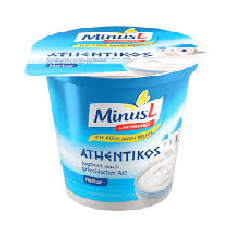

plastic  with  99.57  % accuracy
 Non - Biodegradable


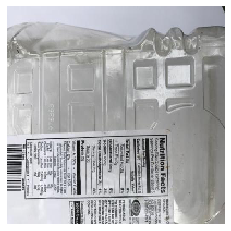

paper  with  92.02  % accuracy
 Biodegradable


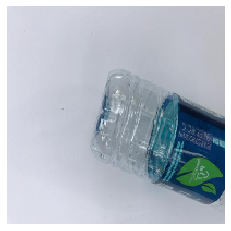

plastic  with  35.03  % accuracy
 Non - Biodegradable


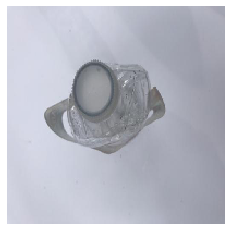

metal  with  74.27  % accuracy
 Non - Biodegradable


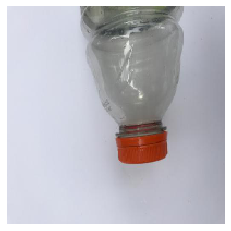

white-glass  with  76.1  % accuracy
 Non - Biodegradable


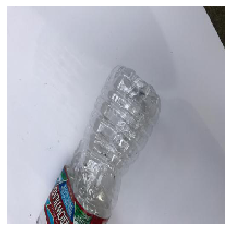

metal  with  38.76  % accuracy
 Non - Biodegradable


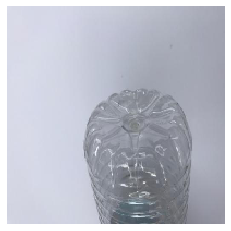

metal  with  90.85  % accuracy
 Non - Biodegradable


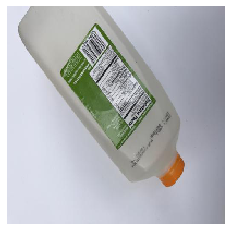

metal  with  26.2  % accuracy
 Non - Biodegradable


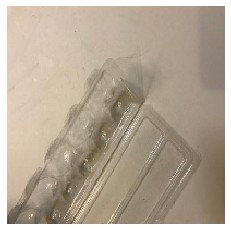

white-glass  with  47.08  % accuracy
 Non - Biodegradable


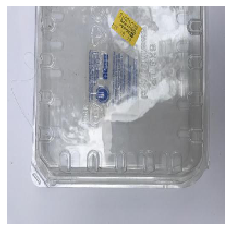

white-glass  with  22.26  % accuracy
 Non - Biodegradable


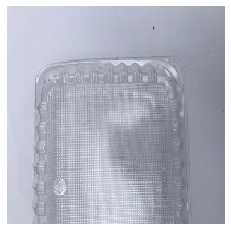

metal  with  56.66  % accuracy
 Non - Biodegradable


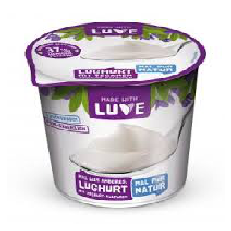

plastic  with  99.29  % accuracy
 Non - Biodegradable


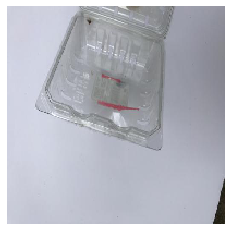

plastic  with  45.64  % accuracy
 Non - Biodegradable


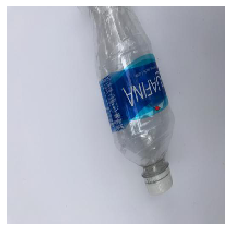

plastic  with  93.59  % accuracy
 Non - Biodegradable


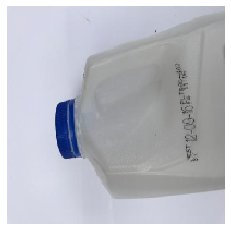

plastic  with  11.48  % accuracy
 Non - Biodegradable


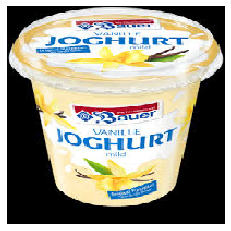

plastic  with  99.99  % accuracy
 Non - Biodegradable


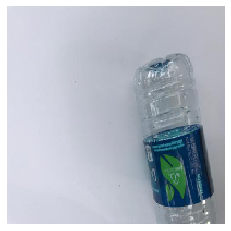

plastic  with  57.67  % accuracy
 Non - Biodegradable


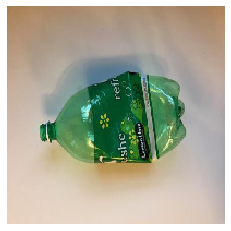

plastic  with  62.43  % accuracy
 Non - Biodegradable


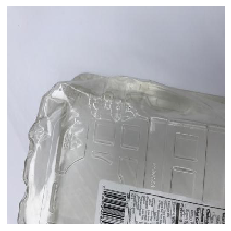

plastic  with  12.85  % accuracy
 Non - Biodegradable


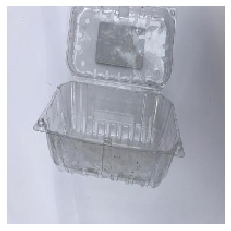

metal  with  81.05  % accuracy
 Non - Biodegradable


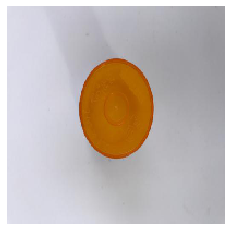

plastic  with  96.09  % accuracy
 Non - Biodegradable


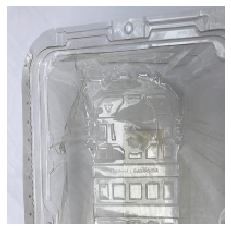

white-glass  with  60.24  % accuracy
 Non - Biodegradable


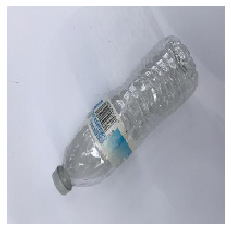

plastic  with  68.69  % accuracy
 Non - Biodegradable


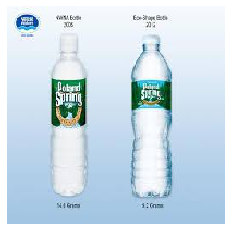

plastic  with  99.06  % accuracy
 Non - Biodegradable


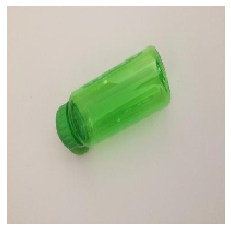

plastic  with  98.6  % accuracy
 Non - Biodegradable


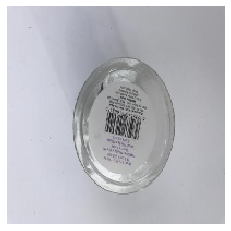

metal  with  81.68  % accuracy
 Non - Biodegradable


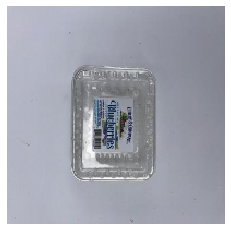

plastic  with  98.72  % accuracy
 Non - Biodegradable


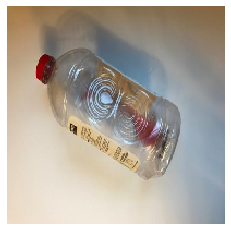

plastic  with  28.14  % accuracy
 Non - Biodegradable


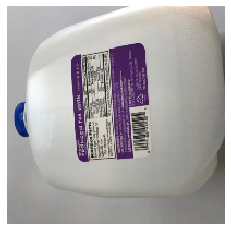

plastic  with  86.58  % accuracy
 Non - Biodegradable


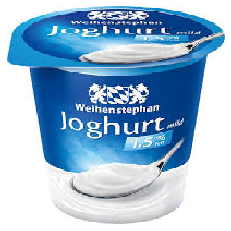

plastic  with  99.94  % accuracy
 Non - Biodegradable


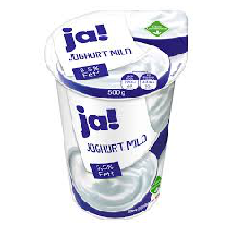

plastic  with  98.98  % accuracy
 Non - Biodegradable


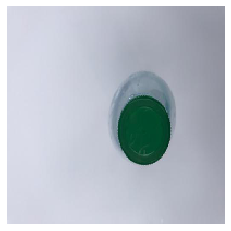

plastic  with  97.96  % accuracy
 Non - Biodegradable


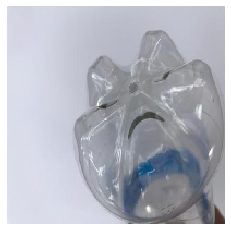

metal  with  44.01  % accuracy
 Non - Biodegradable


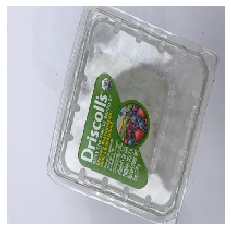

plastic  with  14.74  % accuracy
 Non - Biodegradable


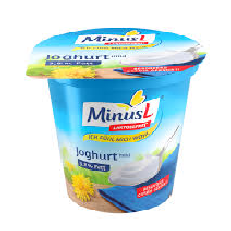

plastic  with  99.82  % accuracy
 Non - Biodegradable


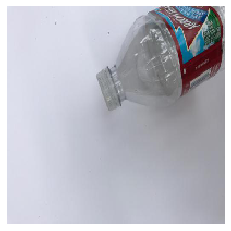

white-glass  with  97.56  % accuracy
 Non - Biodegradable


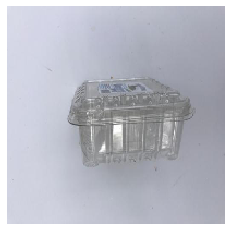

white-glass  with  75.06  % accuracy
 Non - Biodegradable


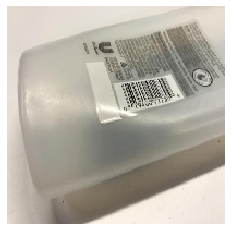

metal  with  62.19  % accuracy
 Non - Biodegradable


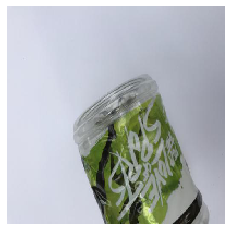

metal  with  98.43  % accuracy
 Non - Biodegradable


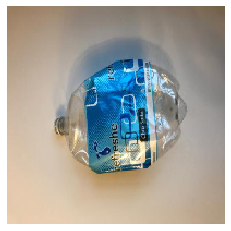

plastic  with  59.03  % accuracy
 Non - Biodegradable


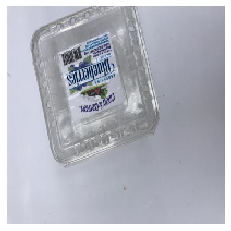

plastic  with  50.84  % accuracy
 Non - Biodegradable


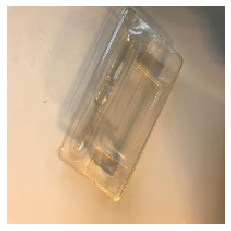

paper  with  47.29  % accuracy
 Biodegradable


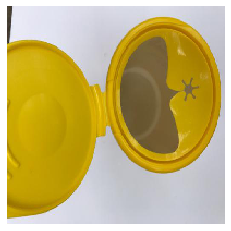

plastic  with  9.09  % accuracy
 Non - Biodegradable


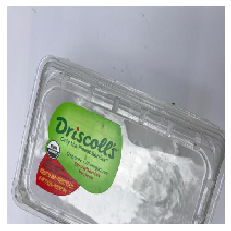

metal  with  53.61  % accuracy
 Non - Biodegradable


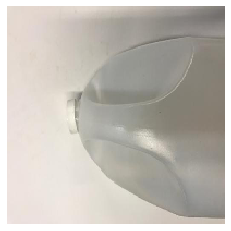

metal  with  81.32  % accuracy
 Non - Biodegradable


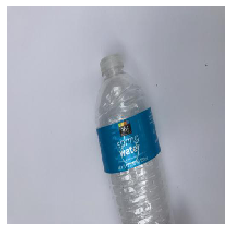

plastic  with  97.47  % accuracy
 Non - Biodegradable


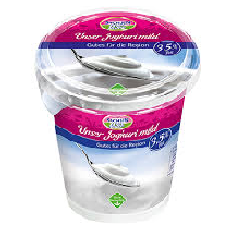

plastic  with  89.88  % accuracy
 Non - Biodegradable


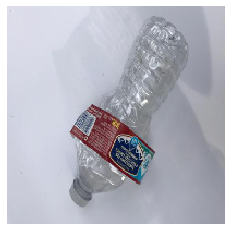

plastic  with  10.46  % accuracy
 Non - Biodegradable


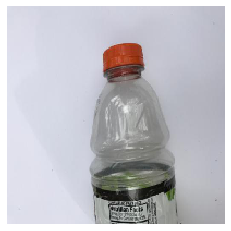

white-glass  with  99.92  % accuracy
 Non - Biodegradable


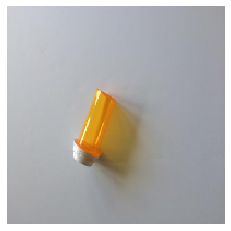

metal  with  55.69  % accuracy
 Non - Biodegradable


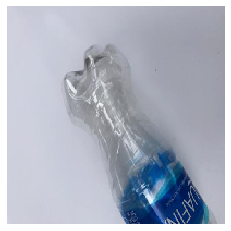

metal  with  40.7  % accuracy
 Non - Biodegradable


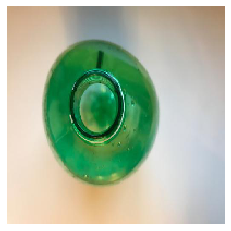

compost  with  52.55  % accuracy
 Biodegradable


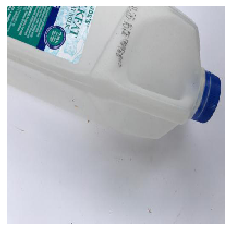

paper  with  4.25  % accuracy
 Biodegradable


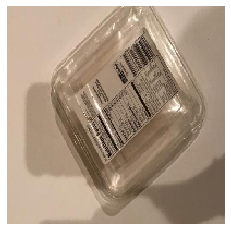

white-glass  with  78.76  % accuracy
 Non - Biodegradable


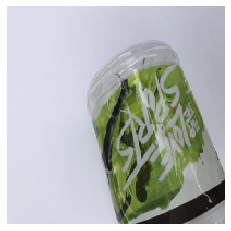

metal  with  94.46  % accuracy
 Non - Biodegradable


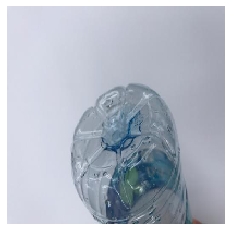

metal  with  23.84  % accuracy
 Non - Biodegradable


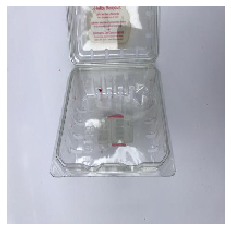

plastic  with  55.51  % accuracy
 Non - Biodegradable


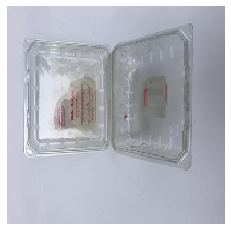

metal  with  71.58  % accuracy
 Non - Biodegradable


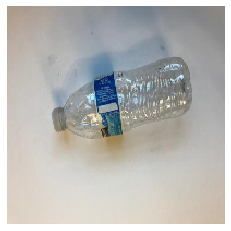

metal  with  14.36  % accuracy
 Non - Biodegradable


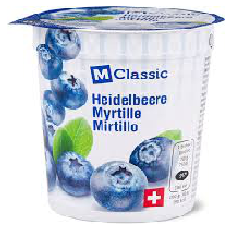

plastic  with  9.64  % accuracy
 Non - Biodegradable


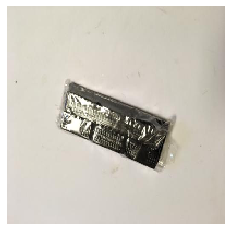

plastic  with  91.13  % accuracy
 Non - Biodegradable


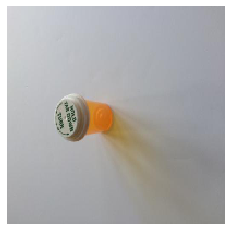

plastic  with  47.92  % accuracy
 Non - Biodegradable


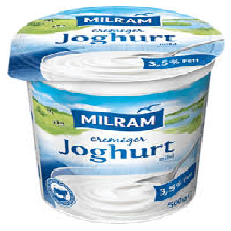

plastic  with  98.67  % accuracy
 Non - Biodegradable


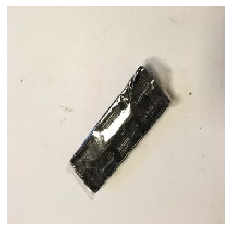

metal  with  91.17  % accuracy
 Non - Biodegradable


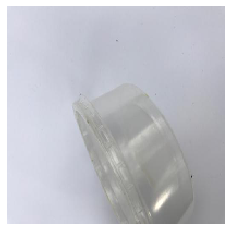

white-glass  with  51.5  % accuracy
 Non - Biodegradable


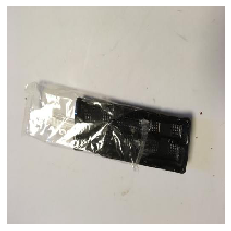

paper  with  74.77  % accuracy
 Biodegradable


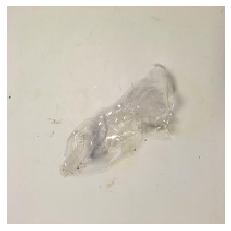

white-glass  with  85.06  % accuracy
 Non - Biodegradable


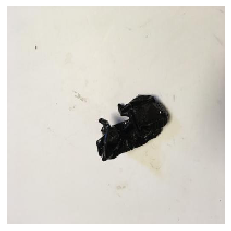

compost  with  98.6  % accuracy
 Biodegradable


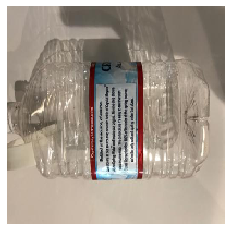

plastic  with  71.76  % accuracy
 Non - Biodegradable


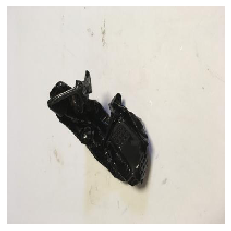

compost  with  63.54  % accuracy
 Biodegradable


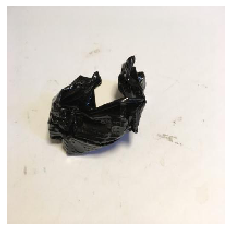

compost  with  34.75  % accuracy
 Biodegradable


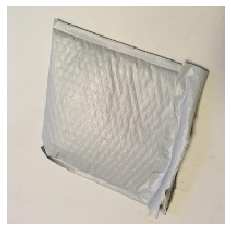

metal  with  20.27  % accuracy
 Non - Biodegradable


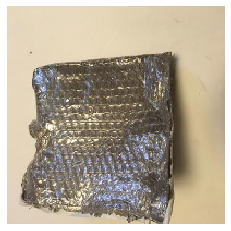

metal  with  1.24  % accuracy
 Non - Biodegradable


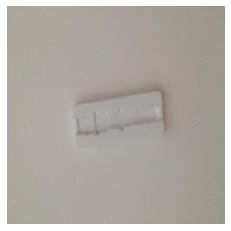

white-glass  with  88.04  % accuracy
 Non - Biodegradable


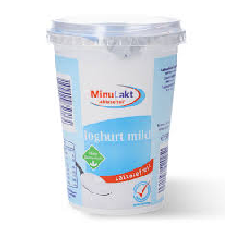

plastic  with  95.36  % accuracy
 Non - Biodegradable


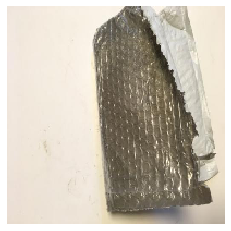

metal  with  7.97  % accuracy
 Non - Biodegradable


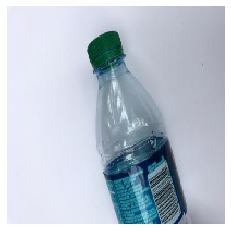

plastic  with  97.05  % accuracy
 Non - Biodegradable


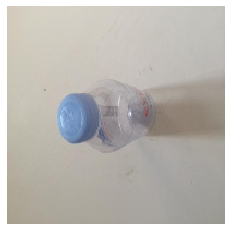

compost  with  76.21  % accuracy
 Biodegradable


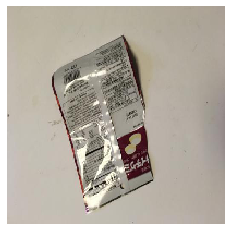

plastic  with  55.32  % accuracy
 Non - Biodegradable


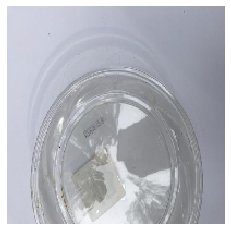

metal  with  97.64  % accuracy
 Non - Biodegradable


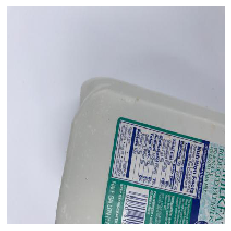

plastic  with  42.95  % accuracy
 Non - Biodegradable


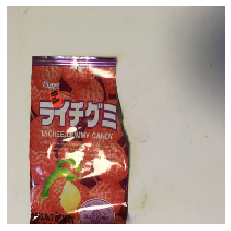

metal  with  7.32  % accuracy
 Non - Biodegradable


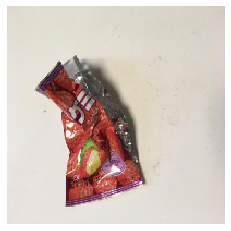

plastic  with  35.31  % accuracy
 Non - Biodegradable


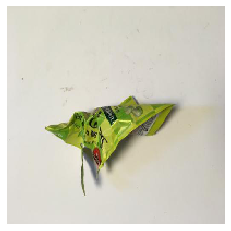

paper  with  5.98  % accuracy
 Biodegradable


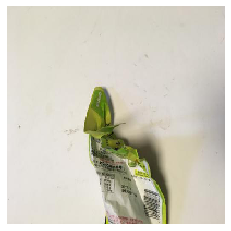

plastic  with  11.69  % accuracy
 Non - Biodegradable


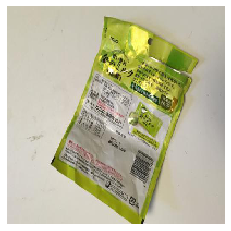

paper  with  68.51  % accuracy
 Biodegradable


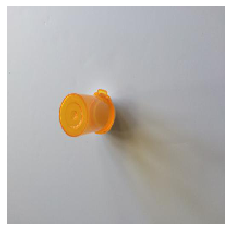

compost  with  96.42  % accuracy
 Biodegradable


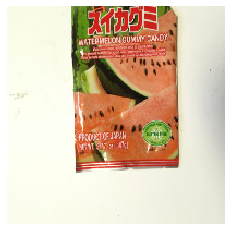

plastic  with  57.6  % accuracy
 Non - Biodegradable


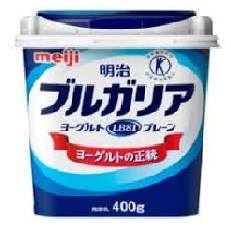

plastic  with  92.54  % accuracy
 Non - Biodegradable


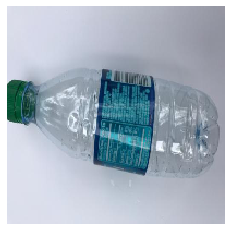

plastic  with  82.48  % accuracy
 Non - Biodegradable


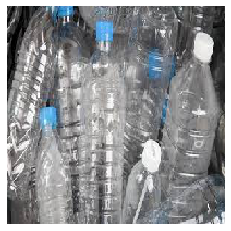

compost  with  2.95  % accuracy
 Biodegradable


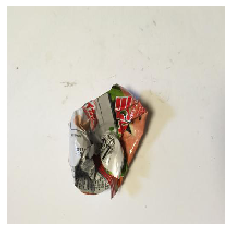

metal  with  9.79  % accuracy
 Non - Biodegradable


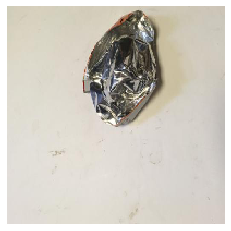

white-glass  with  37.68  % accuracy
 Non - Biodegradable


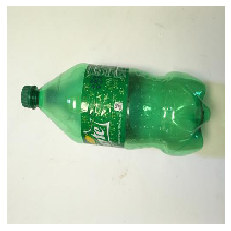

plastic  with  91.9  % accuracy
 Non - Biodegradable


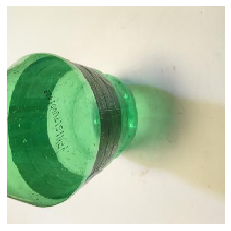

compost  with  20.29  % accuracy
 Biodegradable


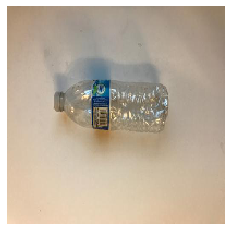

plastic  with  68.08  % accuracy
 Non - Biodegradable


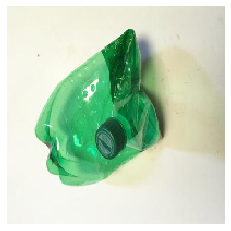

plastic  with  34.87  % accuracy
 Non - Biodegradable


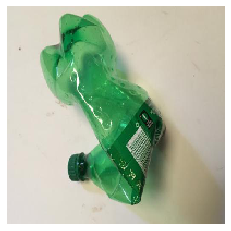

plastic  with  1.22  % accuracy
 Non - Biodegradable


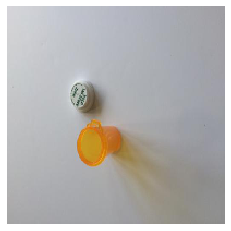

compost  with  98.0  % accuracy
 Biodegradable


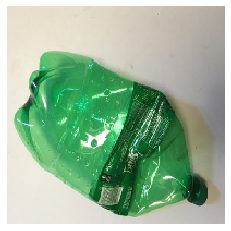

plastic  with  2.38  % accuracy
 Non - Biodegradable


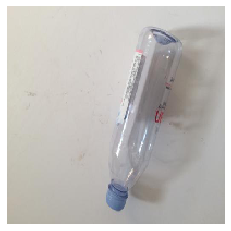

white-glass  with  85.42  % accuracy
 Non - Biodegradable


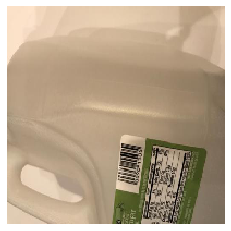

white-glass  with  3.18  % accuracy
 Non - Biodegradable


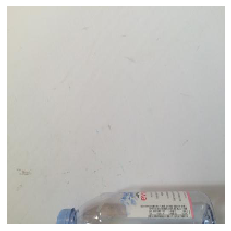

white-glass  with  46.4  % accuracy
 Non - Biodegradable


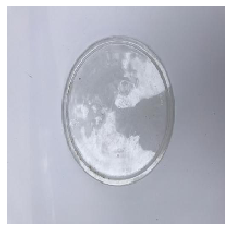

white-glass  with  68.77  % accuracy
 Non - Biodegradable


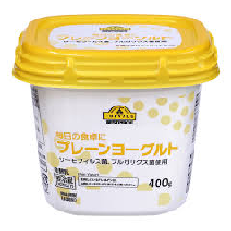

plastic  with  99.12  % accuracy
 Non - Biodegradable


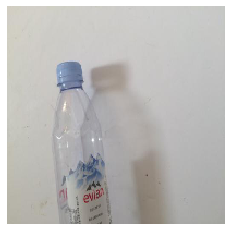

plastic  with  57.38  % accuracy
 Non - Biodegradable


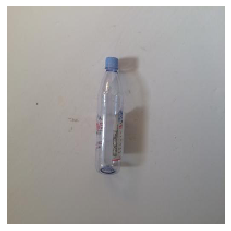

white-glass  with  94.94  % accuracy
 Non - Biodegradable


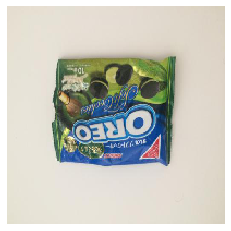

plastic  with  41.02  % accuracy
 Non - Biodegradable


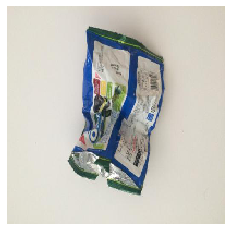

plastic  with  0.88  % accuracy
 Non - Biodegradable


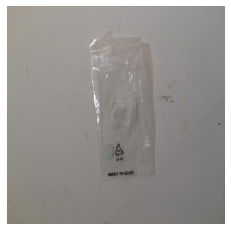

white-glass  with  66.8  % accuracy
 Non - Biodegradable


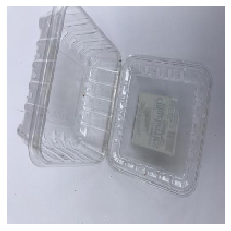

metal  with  53.63  % accuracy
 Non - Biodegradable


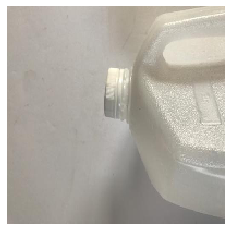

white-glass  with  64.5  % accuracy
 Non - Biodegradable


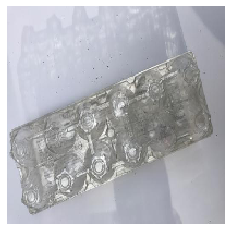

metal  with  12.68  % accuracy
 Non - Biodegradable


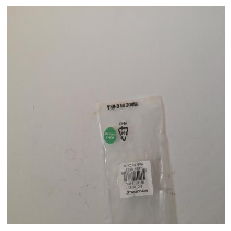

plastic  with  86.6  % accuracy
 Non - Biodegradable


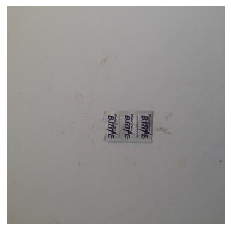

plastic  with  77.96  % accuracy
 Non - Biodegradable


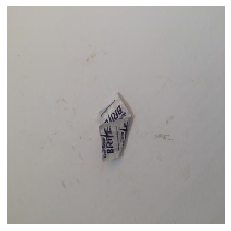

plastic  with  89.17  % accuracy
 Non - Biodegradable


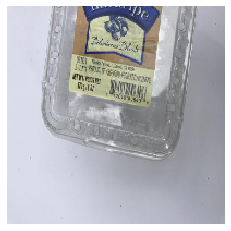

metal  with  5.59  % accuracy
 Non - Biodegradable


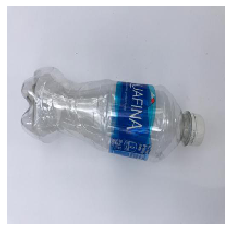

plastic  with  68.54  % accuracy
 Non - Biodegradable


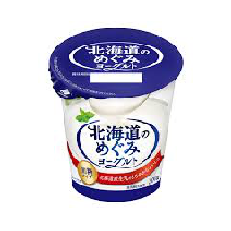

plastic  with  98.81  % accuracy
 Non - Biodegradable


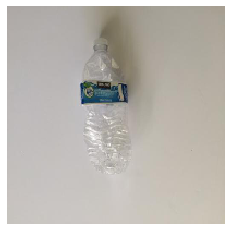

plastic  with  92.55  % accuracy
 Non - Biodegradable


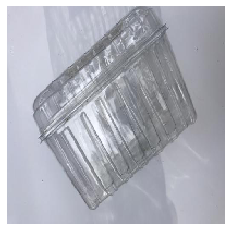

metal  with  27.51  % accuracy
 Non - Biodegradable


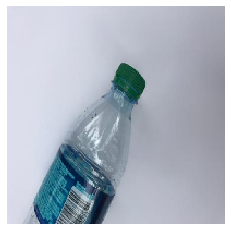

plastic  with  59.4  % accuracy
 Non - Biodegradable


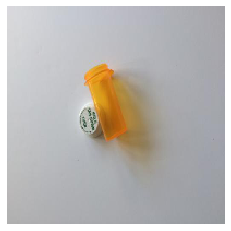

metal  with  27.74  % accuracy
 Non - Biodegradable


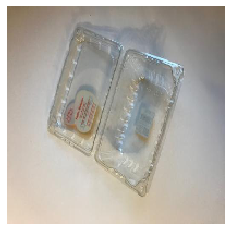

metal  with  15.26  % accuracy
 Non - Biodegradable


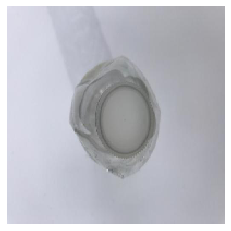

metal  with  91.62  % accuracy
 Non - Biodegradable


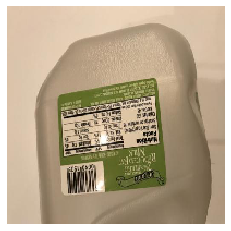

plastic  with  90.98  % accuracy
 Non - Biodegradable


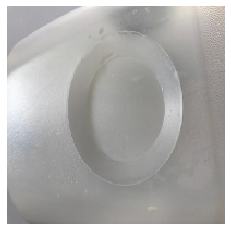

metal  with  55.06  % accuracy
 Non - Biodegradable


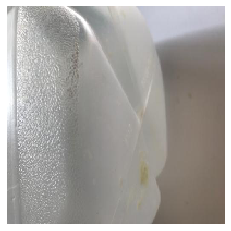

white-glass  with  29.3  % accuracy
 Non - Biodegradable


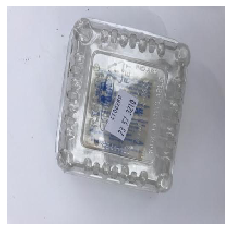

plastic  with  11.61  % accuracy
 Non - Biodegradable


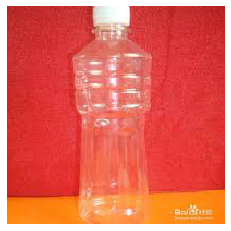

plastic  with  83.35  % accuracy
 Non - Biodegradable


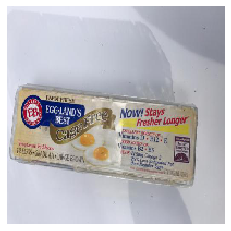

plastic  with  74.24  % accuracy
 Non - Biodegradable


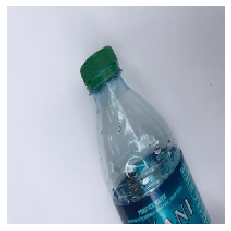

white-glass  with  93.15  % accuracy
 Non - Biodegradable


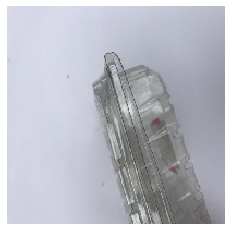

metal  with  91.68  % accuracy
 Non - Biodegradable


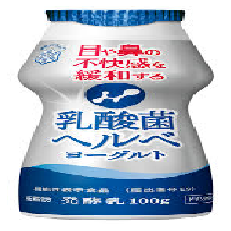

plastic  with  3.27  % accuracy
 Non - Biodegradable


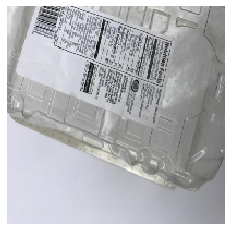

paper  with  96.18  % accuracy
 Biodegradable


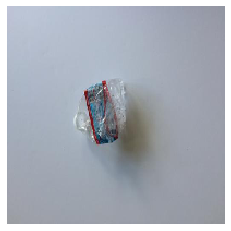

plastic  with  41.91  % accuracy
 Non - Biodegradable


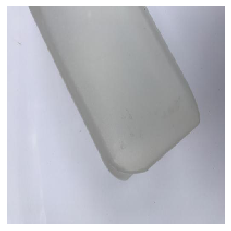

paper  with  34.47  % accuracy
 Biodegradable


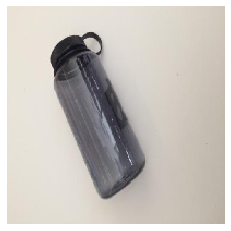

plastic  with  64.03  % accuracy
 Non - Biodegradable


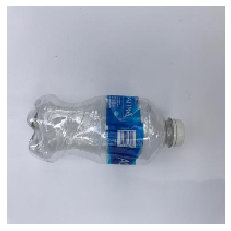

plastic  with  55.53  % accuracy
 Non - Biodegradable


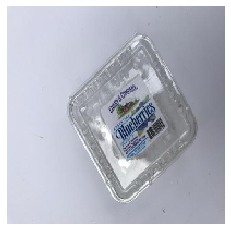

plastic  with  65.28  % accuracy
 Non - Biodegradable


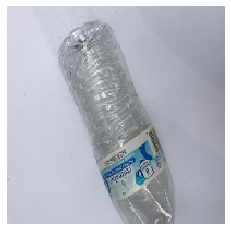

plastic  with  54.67  % accuracy
 Non - Biodegradable


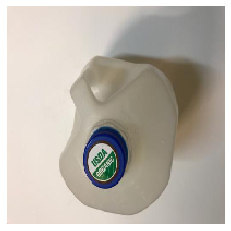

metal  with  34.48  % accuracy
 Non - Biodegradable


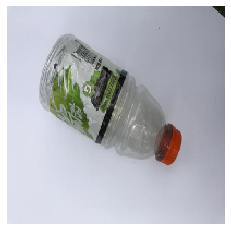

plastic  with  31.23  % accuracy
 Non - Biodegradable


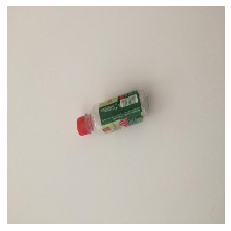

plastic  with  78.4  % accuracy
 Non - Biodegradable


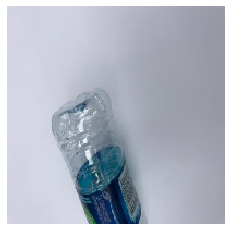

plastic  with  34.37  % accuracy
 Non - Biodegradable


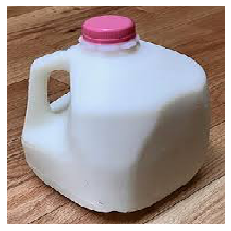

plastic  with  74.65  % accuracy
 Non - Biodegradable


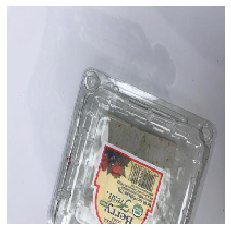

plastic  with  50.86  % accuracy
 Non - Biodegradable


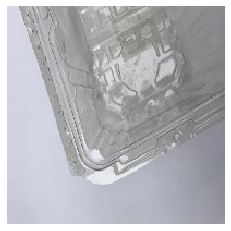

white-glass  with  63.97  % accuracy
 Non - Biodegradable


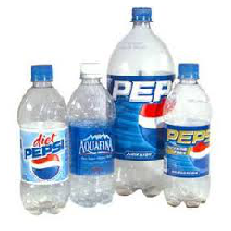

plastic  with  23.41  % accuracy
 Non - Biodegradable


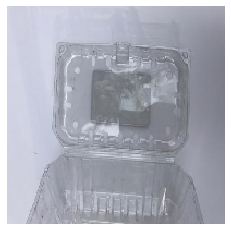

white-glass  with  79.23  % accuracy
 Non - Biodegradable


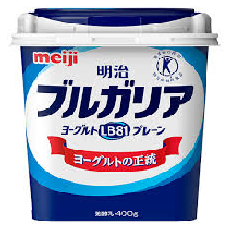

plastic  with  85.91  % accuracy
 Non - Biodegradable


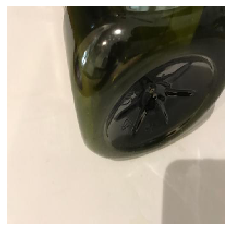

metal  with  69.51  % accuracy
 Non - Biodegradable


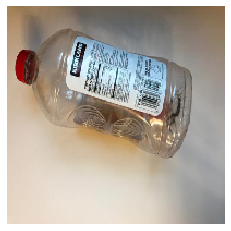

white-glass  with  4.31  % accuracy
 Non - Biodegradable


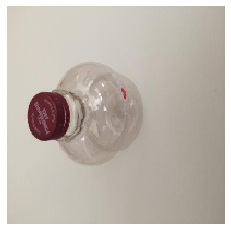

compost  with  53.5  % accuracy
 Biodegradable


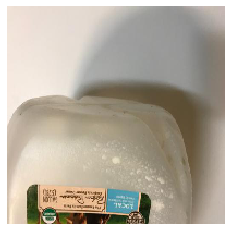

compost  with  11.75  % accuracy
 Biodegradable


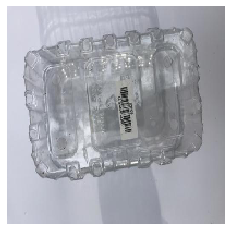

metal  with  42.42  % accuracy
 Non - Biodegradable


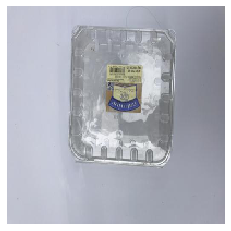

plastic  with  53.0  % accuracy
 Non - Biodegradable


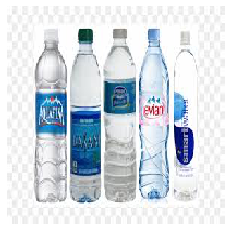

plastic  with  99.87  % accuracy
 Non - Biodegradable


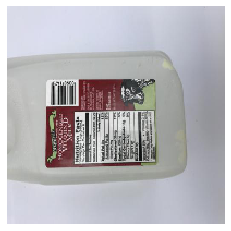

metal  with  82.41  % accuracy
 Non - Biodegradable


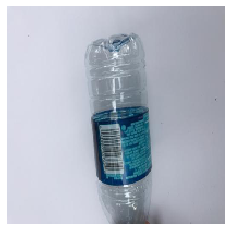

white-glass  with  98.23  % accuracy
 Non - Biodegradable


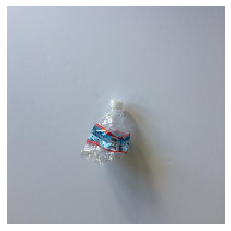

compost  with  79.98  % accuracy
 Biodegradable


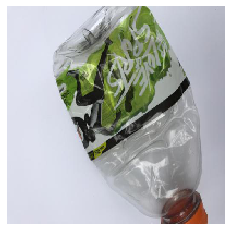

metal  with  0.62  % accuracy
 Non - Biodegradable


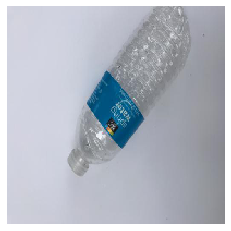

plastic  with  98.29  % accuracy
 Non - Biodegradable


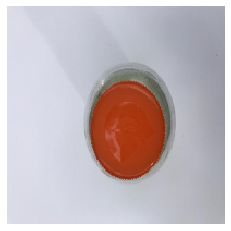

metal  with  96.86  % accuracy
 Non - Biodegradable


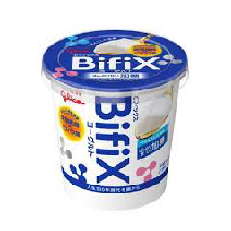

plastic  with  94.44  % accuracy
 Non - Biodegradable


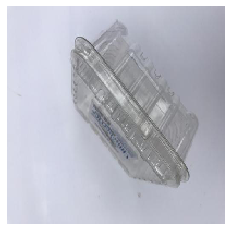

white-glass  with  82.2  % accuracy
 Non - Biodegradable


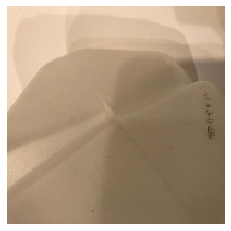

compost  with  80.44  % accuracy
 Biodegradable


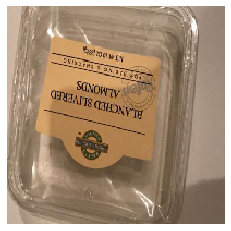

paper  with  69.9  % accuracy
 Biodegradable


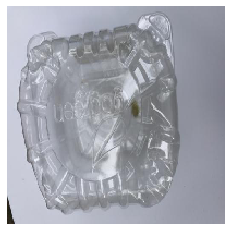

metal  with  23.7  % accuracy
 Non - Biodegradable


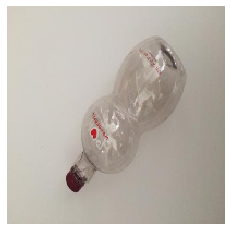

compost  with  16.31  % accuracy
 Biodegradable


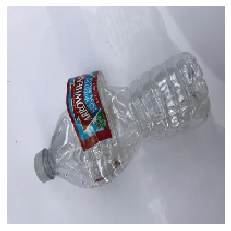

metal  with  18.74  % accuracy
 Non - Biodegradable


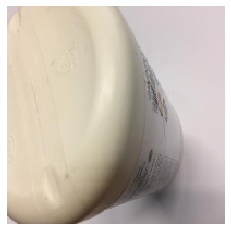

compost  with  56.64  % accuracy
 Biodegradable


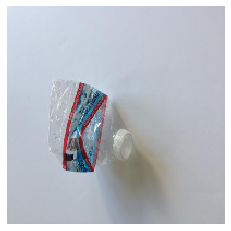

plastic  with  42.09  % accuracy
 Non - Biodegradable


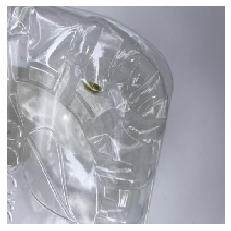

metal  with  42.25  % accuracy
 Non - Biodegradable


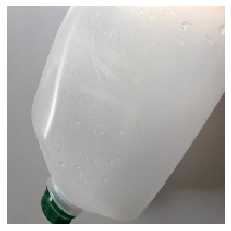

plastic  with  25.92  % accuracy
 Non - Biodegradable


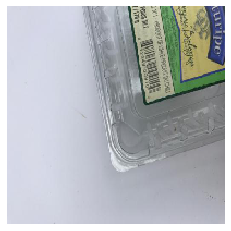

white-glass  with  32.08  % accuracy
 Non - Biodegradable


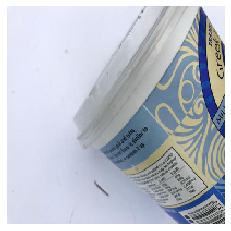

plastic  with  11.87  % accuracy
 Non - Biodegradable


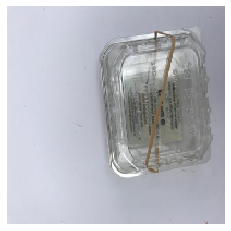

white-glass  with  91.85  % accuracy
 Non - Biodegradable


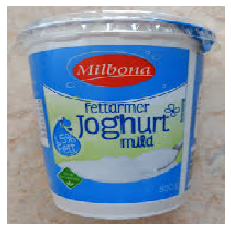

plastic  with  99.25  % accuracy
 Non - Biodegradable


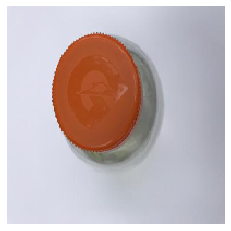

plastic  with  79.5  % accuracy
 Non - Biodegradable


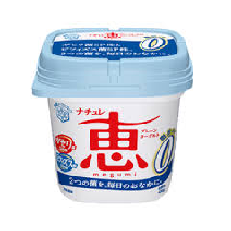

plastic  with  99.98  % accuracy
 Non - Biodegradable


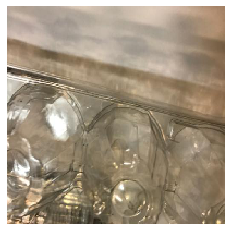

compost  with  14.51  % accuracy
 Biodegradable


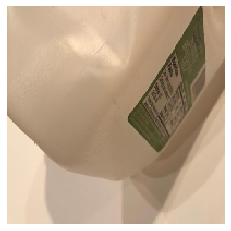

paper  with  6.17  % accuracy
 Biodegradable


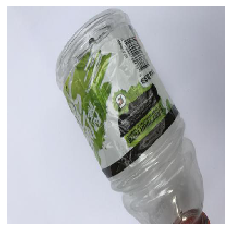

white-glass  with  46.94  % accuracy
 Non - Biodegradable


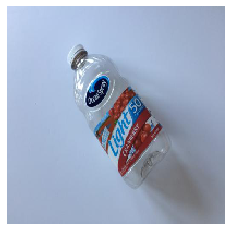

plastic  with  69.66  % accuracy
 Non - Biodegradable


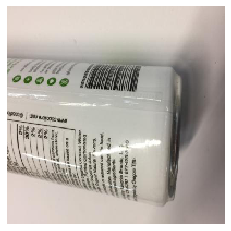

paper  with  11.07  % accuracy
 Biodegradable


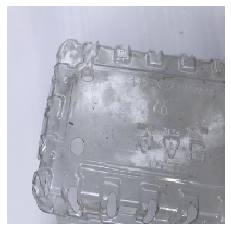

white-glass  with  74.85  % accuracy
 Non - Biodegradable


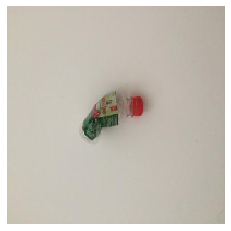

plastic  with  25.51  % accuracy
 Non - Biodegradable


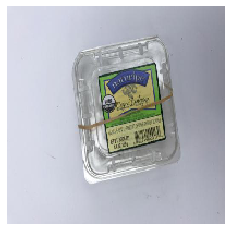

metal  with  93.04  % accuracy
 Non - Biodegradable


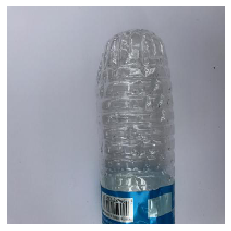

plastic  with  77.09  % accuracy
 Non - Biodegradable


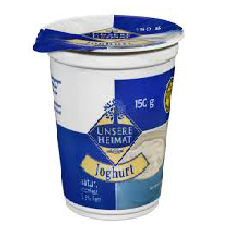

plastic  with  99.53  % accuracy
 Non - Biodegradable


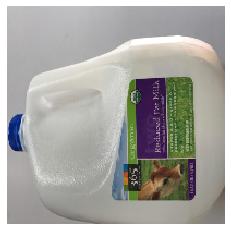

plastic  with  14.39  % accuracy
 Non - Biodegradable


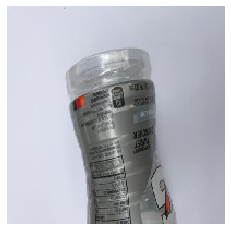

metal  with  76.39  % accuracy
 Non - Biodegradable


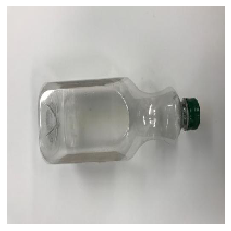

white-glass  with  87.85  % accuracy
 Non - Biodegradable


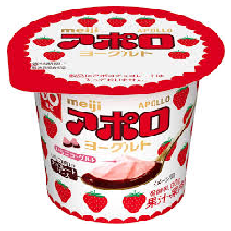

plastic  with  41.32  % accuracy
 Non - Biodegradable


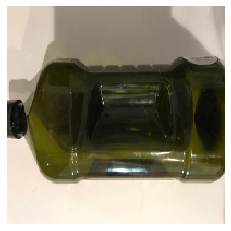

white-glass  with  76.8  % accuracy
 Non - Biodegradable


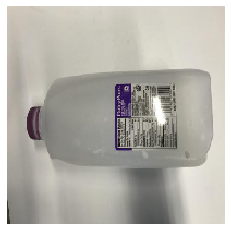

plastic  with  50.39  % accuracy
 Non - Biodegradable


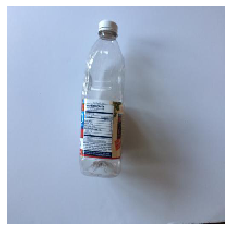

plastic  with  99.83  % accuracy
 Non - Biodegradable


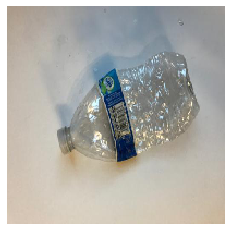

metal  with  9.99  % accuracy
 Non - Biodegradable


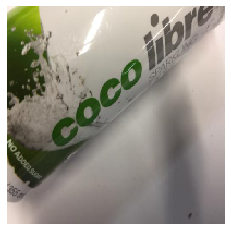

paper  with  3.59  % accuracy
 Biodegradable


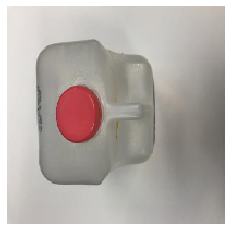

plastic  with  49.78  % accuracy
 Non - Biodegradable


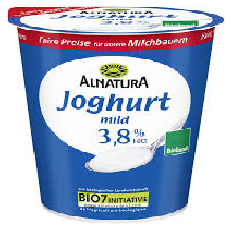

plastic  with  99.56  % accuracy
 Non - Biodegradable


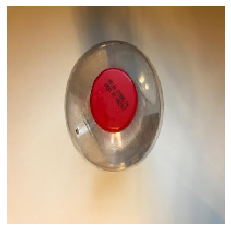

compost  with  26.55  % accuracy
 Biodegradable


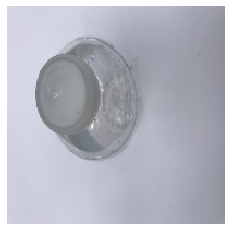

metal  with  75.1  % accuracy
 Non - Biodegradable


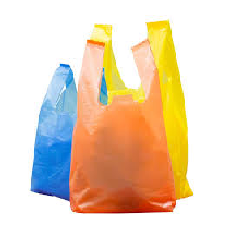

plastic  with  97.2  % accuracy
 Non - Biodegradable


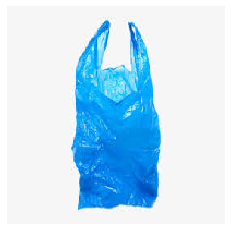

plastic  with  99.99  % accuracy
 Non - Biodegradable


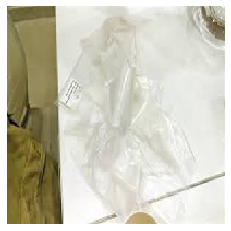

paper  with  18.7  % accuracy
 Biodegradable


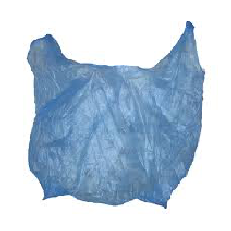

plastic  with  73.71  % accuracy
 Non - Biodegradable


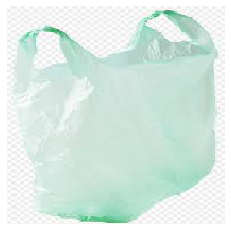

compost  with  66.27  % accuracy
 Biodegradable


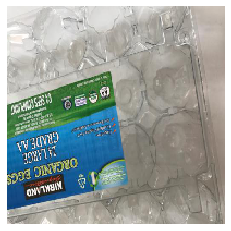

paper  with  97.0  % accuracy
 Biodegradable


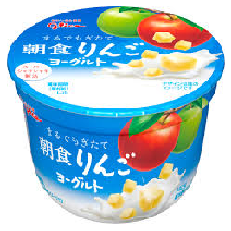

plastic  with  99.8  % accuracy
 Non - Biodegradable


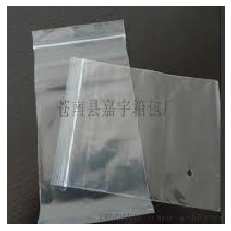

paper  with  94.19  % accuracy
 Biodegradable


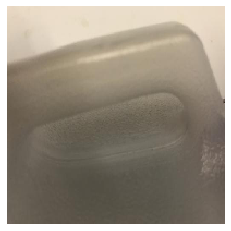

white-glass  with  52.19  % accuracy
 Non - Biodegradable


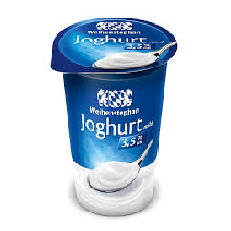

plastic  with  99.58  % accuracy
 Non - Biodegradable


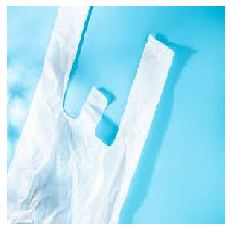

plastic  with  66.12  % accuracy
 Non - Biodegradable


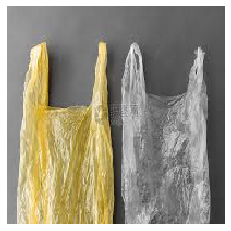

plastic  with  57.33  % accuracy
 Non - Biodegradable


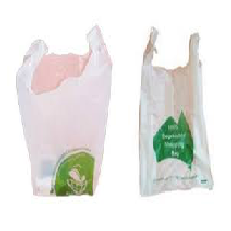

plastic  with  45.09  % accuracy
 Non - Biodegradable


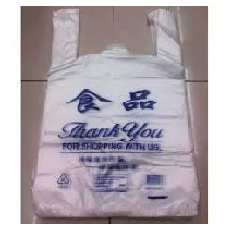

paper  with  89.24  % accuracy
 Biodegradable


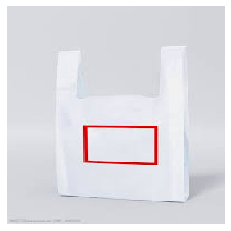

plastic  with  92.97  % accuracy
 Non - Biodegradable


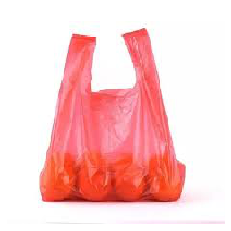

plastic  with  49.14  % accuracy
 Non - Biodegradable


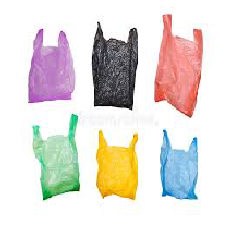

plastic  with  17.84  % accuracy
 Non - Biodegradable


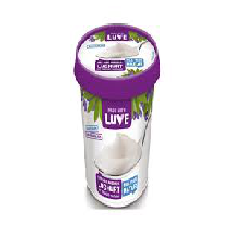

plastic  with  96.65  % accuracy
 Non - Biodegradable


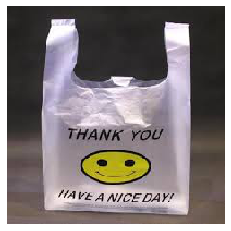

plastic  with  65.9  % accuracy
 Non - Biodegradable


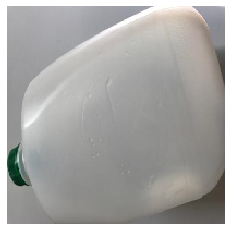

compost  with  26.97  % accuracy
 Biodegradable


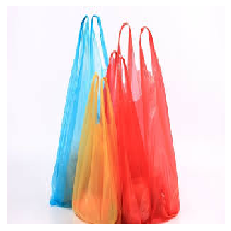

plastic  with  98.56  % accuracy
 Non - Biodegradable


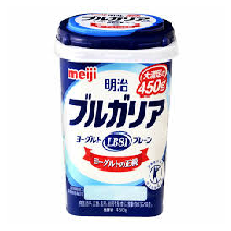

plastic  with  98.85  % accuracy
 Non - Biodegradable


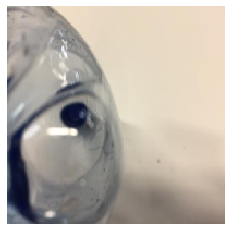

metal  with  9.3  % accuracy
 Non - Biodegradable


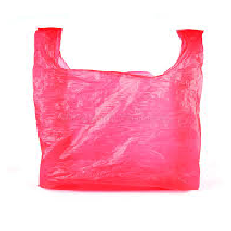

plastic  with  1.39  % accuracy
 Non - Biodegradable


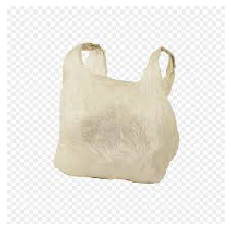

metal  with  2.68  % accuracy
 Non - Biodegradable


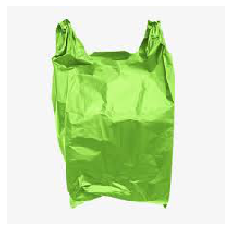

plastic  with  81.26  % accuracy
 Non - Biodegradable


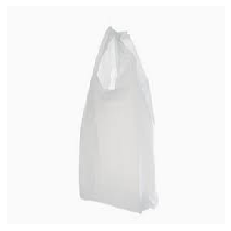

white-glass  with  71.65  % accuracy
 Non - Biodegradable


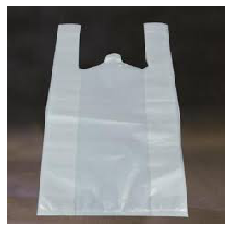

plastic  with  67.06  % accuracy
 Non - Biodegradable


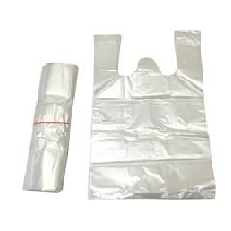

white-glass  with  24.05  % accuracy
 Non - Biodegradable


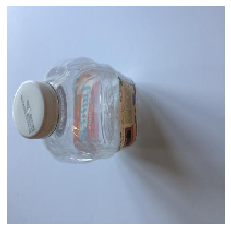

white-glass  with  37.69  % accuracy
 Non - Biodegradable


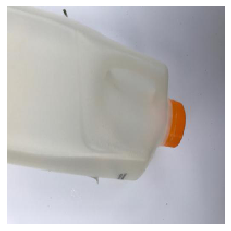

compost  with  24.37  % accuracy
 Biodegradable


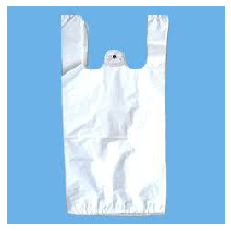

plastic  with  99.23  % accuracy
 Non - Biodegradable


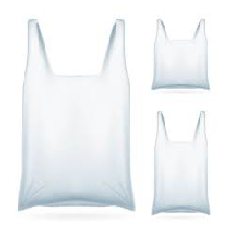

white-glass  with  98.34  % accuracy
 Non - Biodegradable


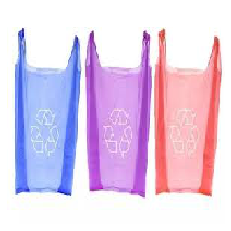

metal  with  59.41  % accuracy
 Non - Biodegradable


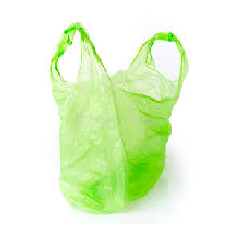

plastic  with  15.72  % accuracy
 Non - Biodegradable


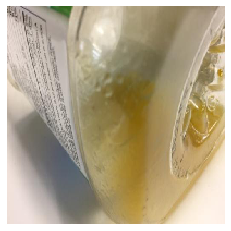

white-glass  with  22.24  % accuracy
 Non - Biodegradable


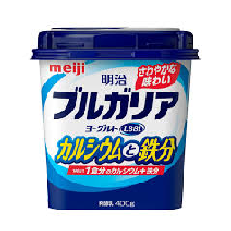

plastic  with  95.04  % accuracy
 Non - Biodegradable


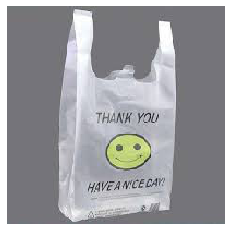

plastic  with  99.58  % accuracy
 Non - Biodegradable


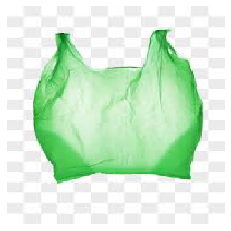

plastic  with  25.61  % accuracy
 Non - Biodegradable


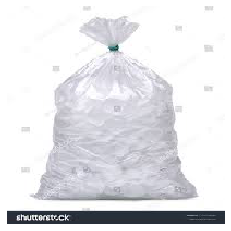

plastic  with  92.78  % accuracy
 Non - Biodegradable


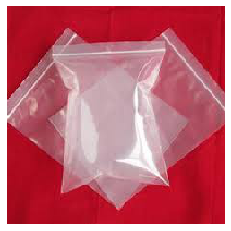

paper  with  59.37  % accuracy
 Biodegradable


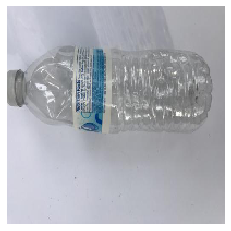

white-glass  with  77.13  % accuracy
 Non - Biodegradable


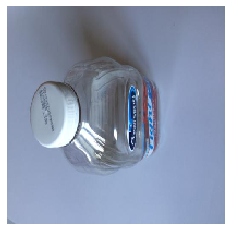

metal  with  27.96  % accuracy
 Non - Biodegradable


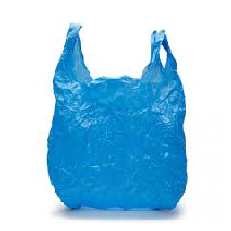

plastic  with  100.0  % accuracy
 Non - Biodegradable


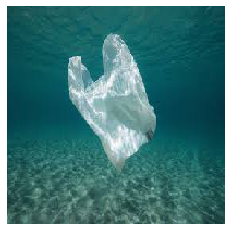

plastic  with  43.41  % accuracy
 Non - Biodegradable


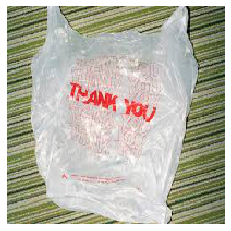

plastic  with  89.57  % accuracy
 Non - Biodegradable


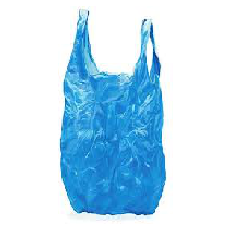

plastic  with  99.99  % accuracy
 Non - Biodegradable


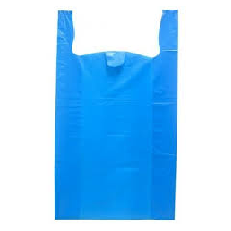

plastic  with  99.82  % accuracy
 Non - Biodegradable


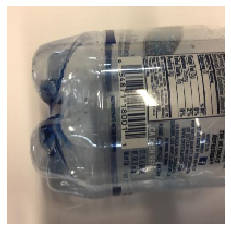

plastic  with  18.71  % accuracy
 Non - Biodegradable


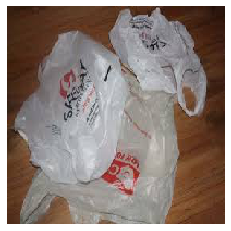

compost  with  63.65  % accuracy
 Biodegradable


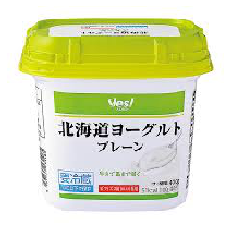

plastic  with  99.5  % accuracy
 Non - Biodegradable


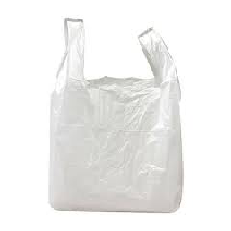

plastic  with  74.59  % accuracy
 Non - Biodegradable


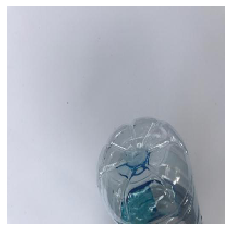

white-glass  with  88.11  % accuracy
 Non - Biodegradable


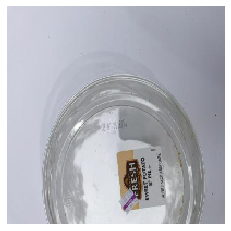

metal  with  77.75  % accuracy
 Non - Biodegradable


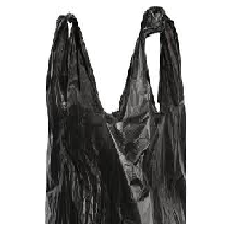

plastic  with  58.09  % accuracy
 Non - Biodegradable


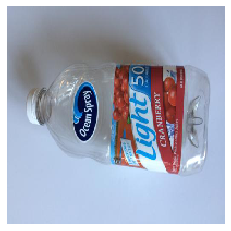

plastic  with  2.71  % accuracy
 Non - Biodegradable


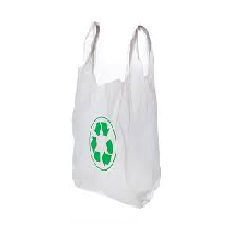

plastic  with  93.25  % accuracy
 Non - Biodegradable


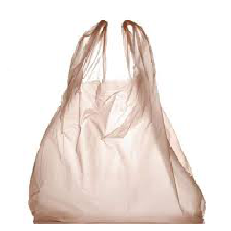

plastic  with  3.24  % accuracy
 Non - Biodegradable


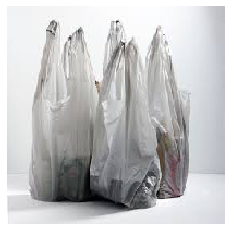

white-glass  with  94.94  % accuracy
 Non - Biodegradable


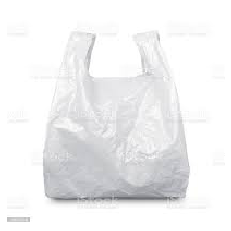

white-glass  with  74.78  % accuracy
 Non - Biodegradable


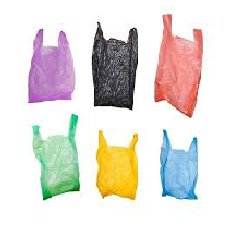

plastic  with  18.45  % accuracy
 Non - Biodegradable


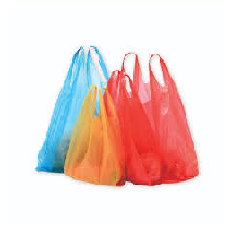

plastic  with  49.8  % accuracy
 Non - Biodegradable


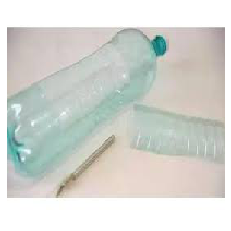

plastic  with  14.61  % accuracy
 Non - Biodegradable


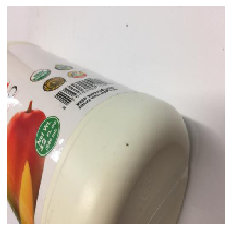

metal  with  1.82  % accuracy
 Non - Biodegradable


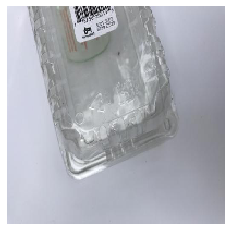

paper  with  42.53  % accuracy
 Biodegradable


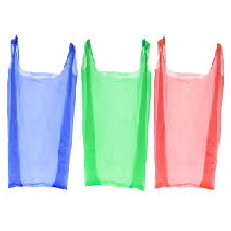

plastic  with  77.83  % accuracy
 Non - Biodegradable


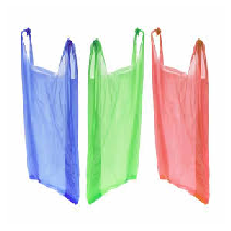

plastic  with  97.83  % accuracy
 Non - Biodegradable


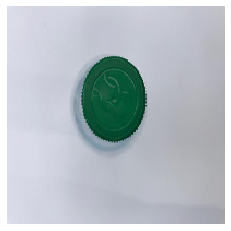

plastic  with  97.39  % accuracy
 Non - Biodegradable


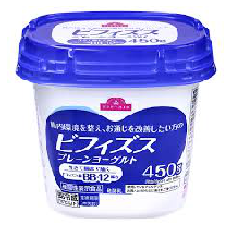

plastic  with  99.87  % accuracy
 Non - Biodegradable


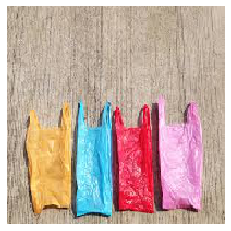

compost  with  7.53  % accuracy
 Biodegradable


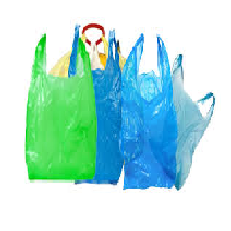

plastic  with  99.81  % accuracy
 Non - Biodegradable


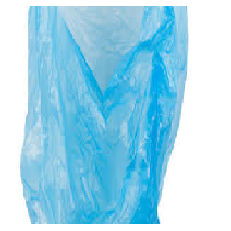

plastic  with  29.03  % accuracy
 Non - Biodegradable


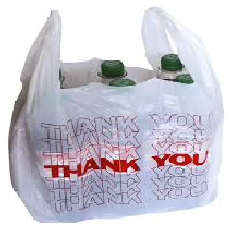

white-glass  with  1.02  % accuracy
 Non - Biodegradable


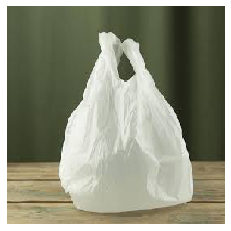

plastic  with  86.1  % accuracy
 Non - Biodegradable


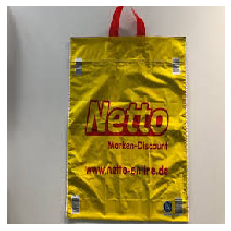

plastic  with  40.55  % accuracy
 Non - Biodegradable


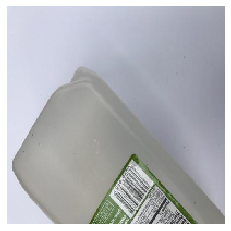

plastic  with  7.0  % accuracy
 Non - Biodegradable


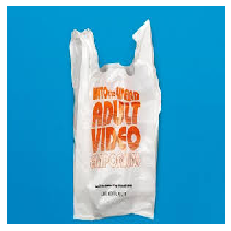

plastic  with  100.0  % accuracy
 Non - Biodegradable


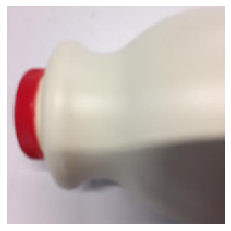

compost  with  82.54  % accuracy
 Biodegradable


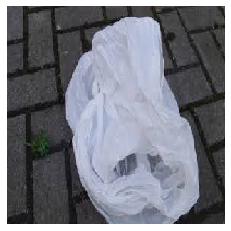

compost  with  13.7  % accuracy
 Biodegradable


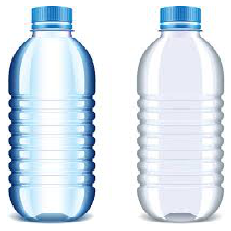

plastic  with  57.75  % accuracy
 Non - Biodegradable


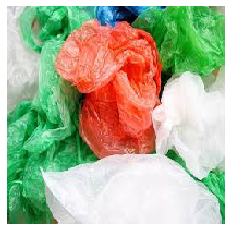

compost  with  4.47  % accuracy
 Biodegradable


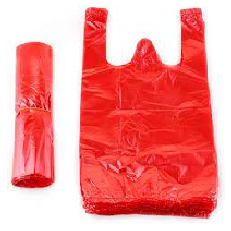

plastic  with  36.55  % accuracy
 Non - Biodegradable


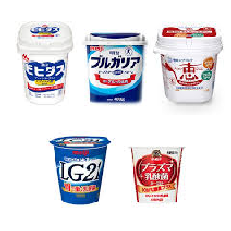

metal  with  53.9  % accuracy
 Non - Biodegradable


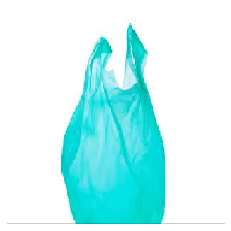

plastic  with  99.69  % accuracy
 Non - Biodegradable


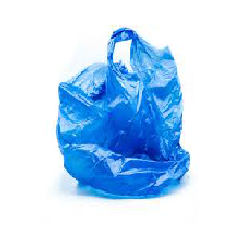

plastic  with  35.11  % accuracy
 Non - Biodegradable


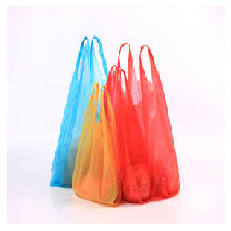

plastic  with  92.04  % accuracy
 Non - Biodegradable


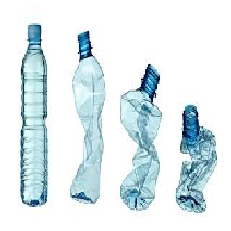

plastic  with  0.93  % accuracy
 Non - Biodegradable


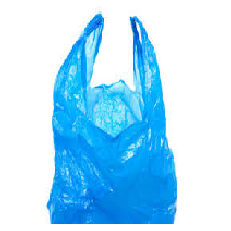

plastic  with  98.47  % accuracy
 Non - Biodegradable


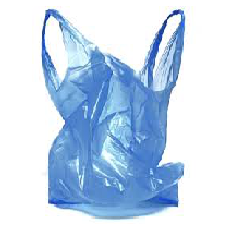

plastic  with  2.71  % accuracy
 Non - Biodegradable


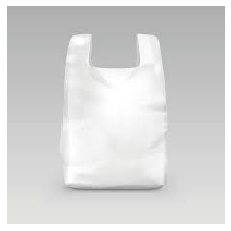

white-glass  with  99.28  % accuracy
 Non - Biodegradable


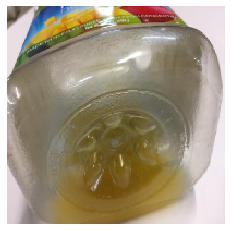

metal  with  4.5  % accuracy
 Non - Biodegradable


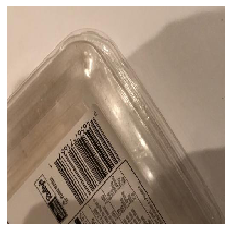

metal  with  60.99  % accuracy
 Non - Biodegradable


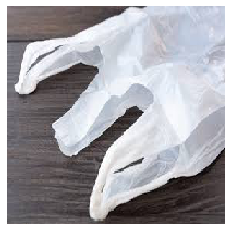

paper  with  11.79  % accuracy
 Biodegradable


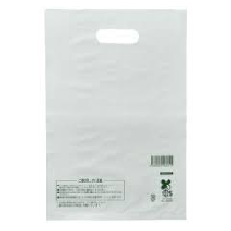

paper  with  75.31  % accuracy
 Biodegradable


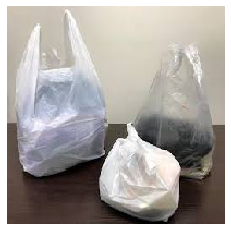

white-glass  with  61.69  % accuracy
 Non - Biodegradable


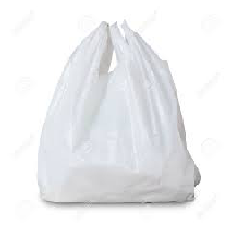

white-glass  with  72.32  % accuracy
 Non - Biodegradable


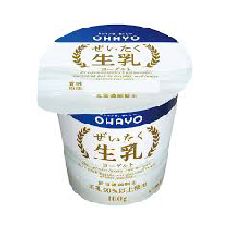

plastic  with  99.32  % accuracy
 Non - Biodegradable


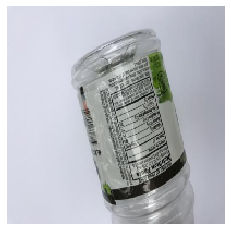

metal  with  62.09  % accuracy
 Non - Biodegradable


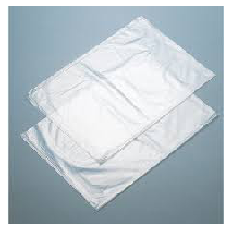

paper  with  55.68  % accuracy
 Biodegradable


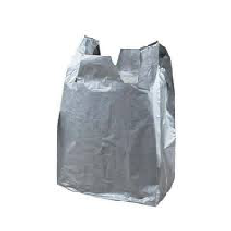

metal  with  31.76  % accuracy
 Non - Biodegradable


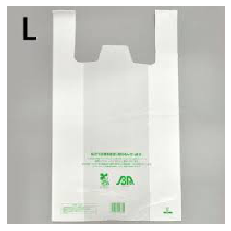

plastic  with  73.0  % accuracy
 Non - Biodegradable


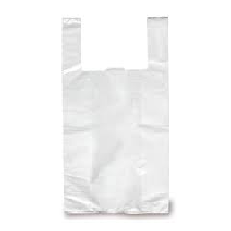

white-glass  with  91.65  % accuracy
 Non - Biodegradable


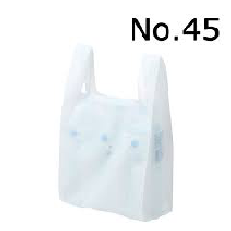

white-glass  with  61.61  % accuracy
 Non - Biodegradable


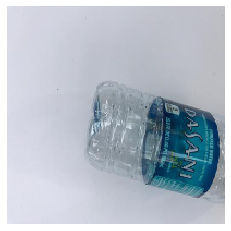

plastic  with  81.48  % accuracy
 Non - Biodegradable


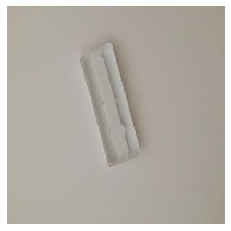

white-glass  with  54.25  % accuracy
 Non - Biodegradable


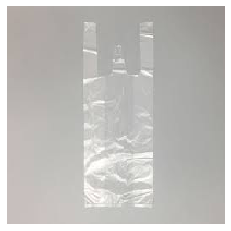

white-glass  with  99.38  % accuracy
 Non - Biodegradable


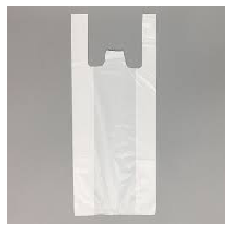

white-glass  with  88.38  % accuracy
 Non - Biodegradable


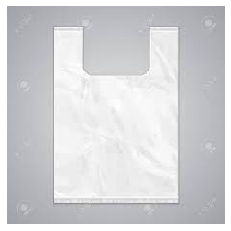

white-glass  with  93.53  % accuracy
 Non - Biodegradable


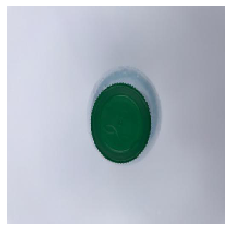

plastic  with  98.05  % accuracy
 Non - Biodegradable


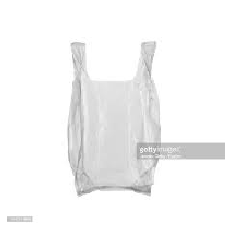

white-glass  with  74.75  % accuracy
 Non - Biodegradable


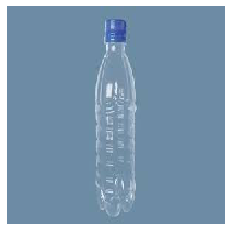

plastic  with  98.87  % accuracy
 Non - Biodegradable


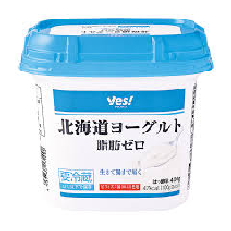

plastic  with  99.93  % accuracy
 Non - Biodegradable


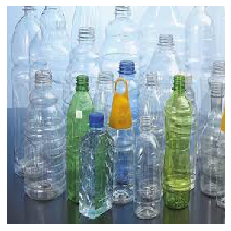

plastic  with  23.04  % accuracy
 Non - Biodegradable


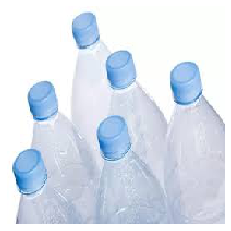

plastic  with  94.65  % accuracy
 Non - Biodegradable


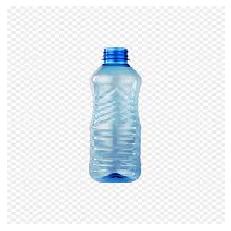

plastic  with  99.98  % accuracy
 Non - Biodegradable


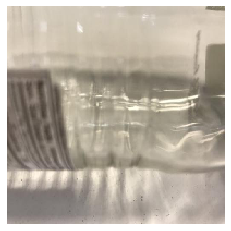

white-glass  with  67.33  % accuracy
 Non - Biodegradable


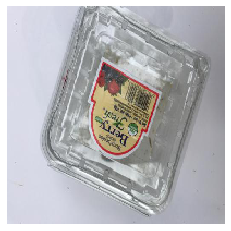

plastic  with  30.85  % accuracy
 Non - Biodegradable


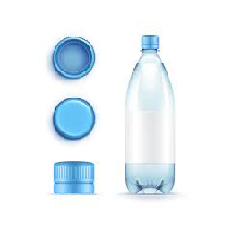

plastic  with  99.39  % accuracy
 Non - Biodegradable


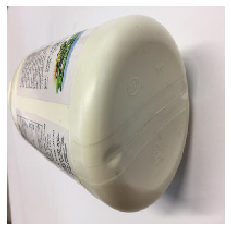

compost  with  45.59  % accuracy
 Biodegradable


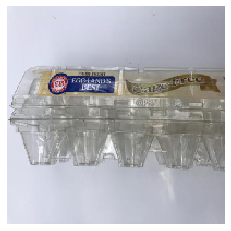

white-glass  with  53.07  % accuracy
 Non - Biodegradable


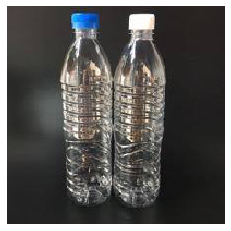

plastic  with  98.89  % accuracy
 Non - Biodegradable


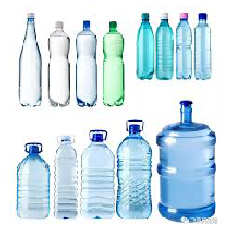

plastic  with  8.89  % accuracy
 Non - Biodegradable


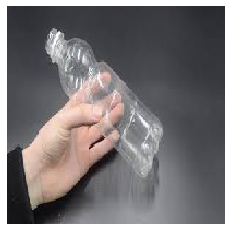

metal  with  5.08  % accuracy
 Non - Biodegradable


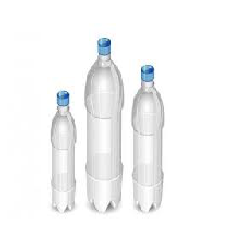

plastic  with  93.97  % accuracy
 Non - Biodegradable


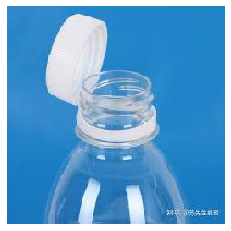

plastic  with  99.09  % accuracy
 Non - Biodegradable


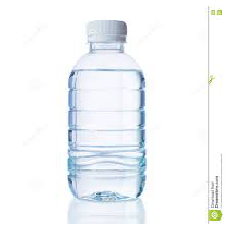

plastic  with  99.7  % accuracy
 Non - Biodegradable


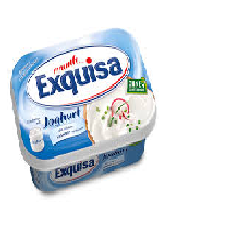

plastic  with  49.1  % accuracy
 Non - Biodegradable


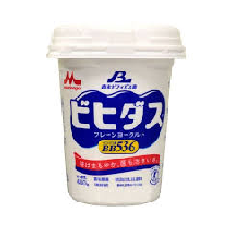

plastic  with  87.56  % accuracy
 Non - Biodegradable


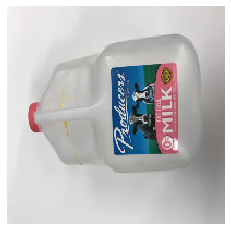

metal  with  26.18  % accuracy
 Non - Biodegradable


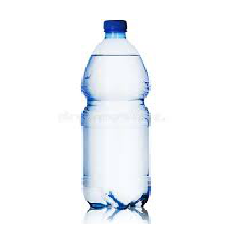

plastic  with  99.99  % accuracy
 Non - Biodegradable


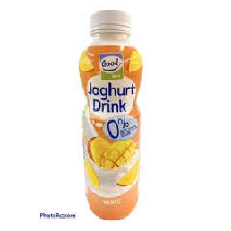

plastic  with  81.37  % accuracy
 Non - Biodegradable


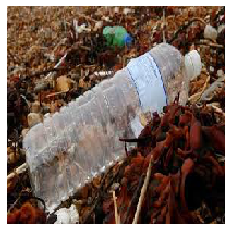

compost  with  48.62  % accuracy
 Biodegradable


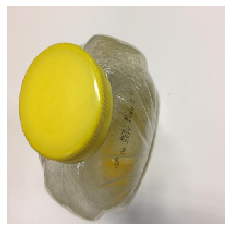

compost  with  81.04  % accuracy
 Biodegradable


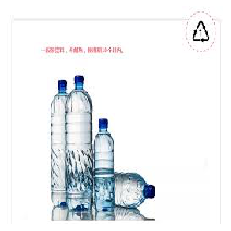

plastic  with  6.64  % accuracy
 Non - Biodegradable


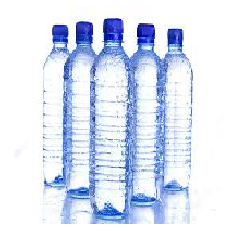

plastic  with  90.85  % accuracy
 Non - Biodegradable


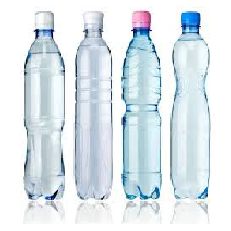

plastic  with  99.52  % accuracy
 Non - Biodegradable


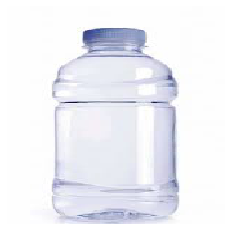

plastic  with  99.43  % accuracy
 Non - Biodegradable


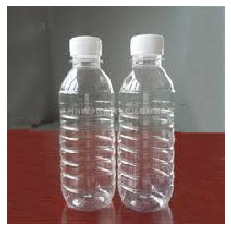

plastic  with  38.78  % accuracy
 Non - Biodegradable


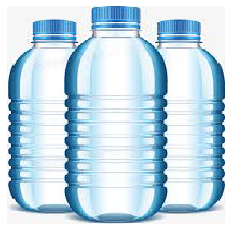

plastic  with  99.86  % accuracy
 Non - Biodegradable


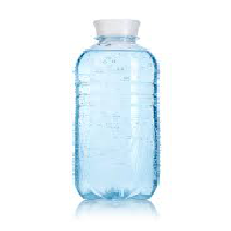

plastic  with  98.63  % accuracy
 Non - Biodegradable


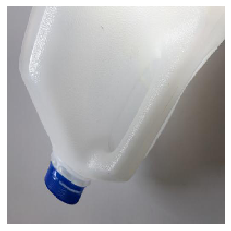

white-glass  with  12.97  % accuracy
 Non - Biodegradable


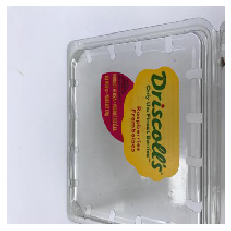

plastic  with  2.34  % accuracy
 Non - Biodegradable


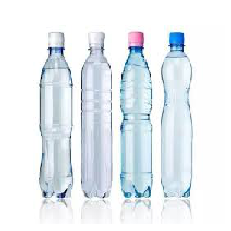

plastic  with  98.61  % accuracy
 Non - Biodegradable


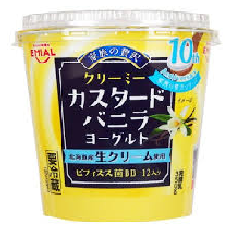

plastic  with  6.17  % accuracy
 Non - Biodegradable


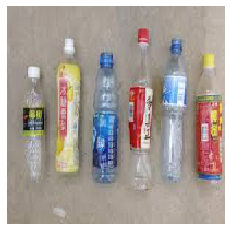

plastic  with  99.11  % accuracy
 Non - Biodegradable


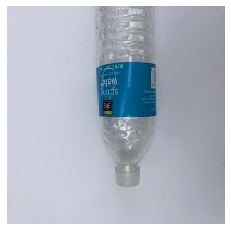

plastic  with  90.74  % accuracy
 Non - Biodegradable


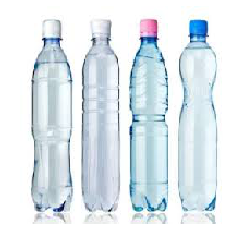

plastic  with  99.72  % accuracy
 Non - Biodegradable


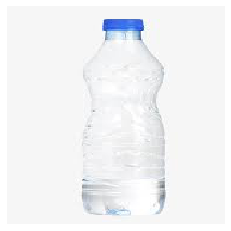

plastic  with  98.83  % accuracy
 Non - Biodegradable


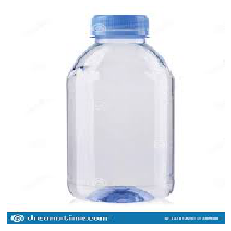

plastic  with  98.9  % accuracy
 Non - Biodegradable


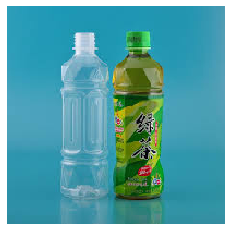

plastic  with  100.0  % accuracy
 Non - Biodegradable


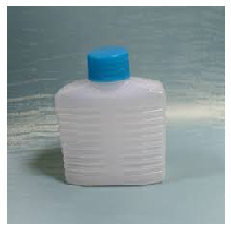

plastic  with  66.68  % accuracy
 Non - Biodegradable


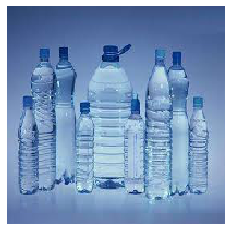

plastic  with  99.72  % accuracy
 Non - Biodegradable


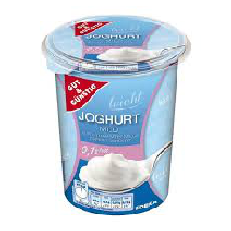

plastic  with  96.4  % accuracy
 Non - Biodegradable


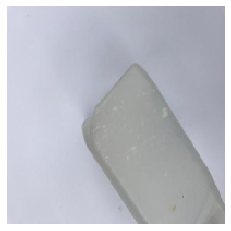

metal  with  61.47  % accuracy
 Non - Biodegradable


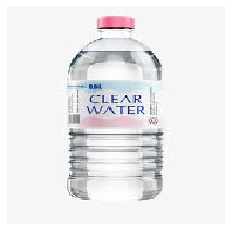

plastic  with  99.75  % accuracy
 Non - Biodegradable


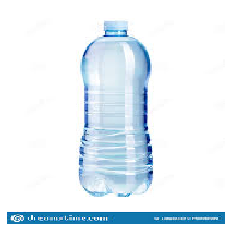

plastic  with  99.4  % accuracy
 Non - Biodegradable


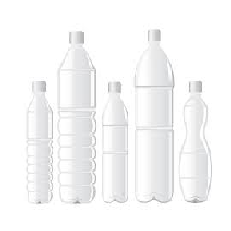

white-glass  with  91.35  % accuracy
 Non - Biodegradable


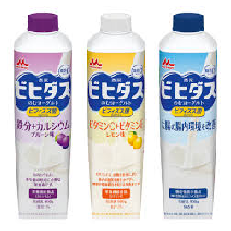

plastic  with  89.58  % accuracy
 Non - Biodegradable


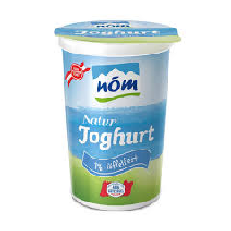

plastic  with  99.35  % accuracy
 Non - Biodegradable


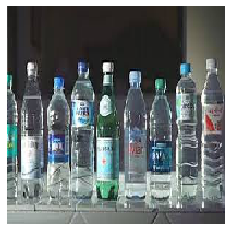

plastic  with  66.65  % accuracy
 Non - Biodegradable


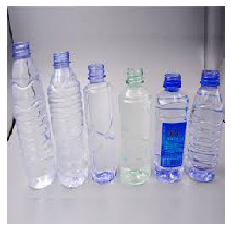

plastic  with  40.71  % accuracy
 Non - Biodegradable


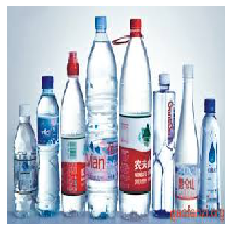

plastic  with  98.22  % accuracy
 Non - Biodegradable


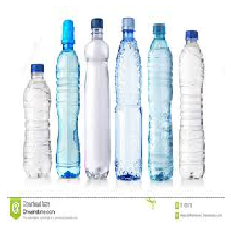

plastic  with  99.89  % accuracy
 Non - Biodegradable


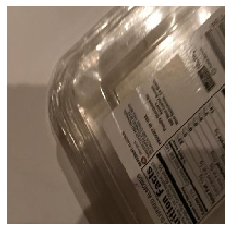

white-glass  with  21.0  % accuracy
 Non - Biodegradable


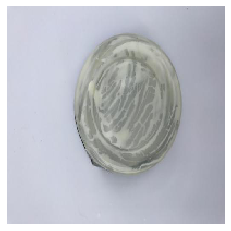

white-glass  with  77.01  % accuracy
 Non - Biodegradable


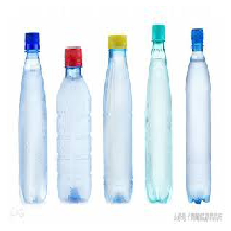

plastic  with  97.61  % accuracy
 Non - Biodegradable


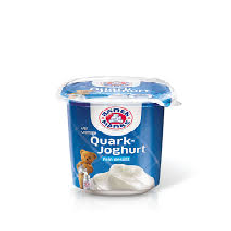

plastic  with  99.81  % accuracy
 Non - Biodegradable


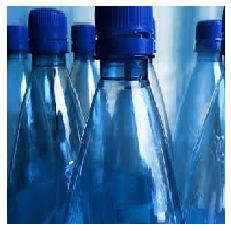

white-glass  with  31.22  % accuracy
 Non - Biodegradable


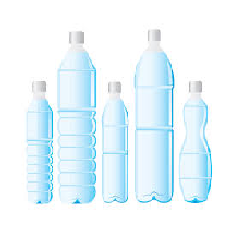

plastic  with  99.5  % accuracy
 Non - Biodegradable


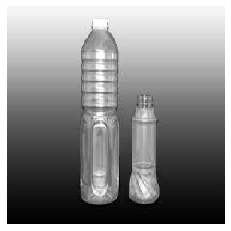

white-glass  with  99.6  % accuracy
 Non - Biodegradable


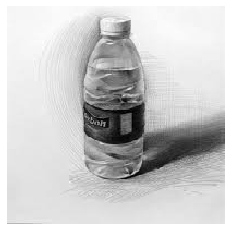

plastic  with  97.34  % accuracy
 Non - Biodegradable


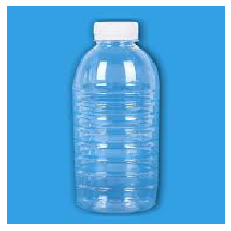

plastic  with  99.99  % accuracy
 Non - Biodegradable


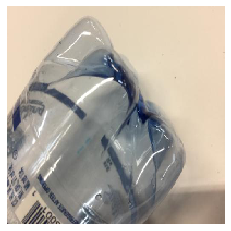

plastic  with  1.64  % accuracy
 Non - Biodegradable


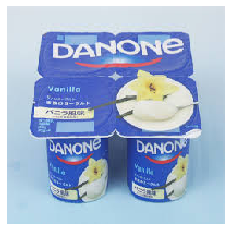

plastic  with  91.38  % accuracy
 Non - Biodegradable


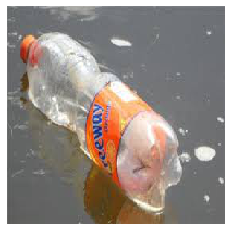

compost  with  8.19  % accuracy
 Biodegradable


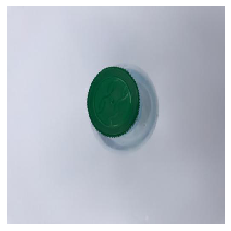

plastic  with  98.8  % accuracy
 Non - Biodegradable


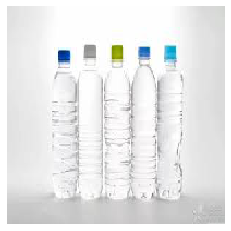

white-glass  with  56.19  % accuracy
 Non - Biodegradable


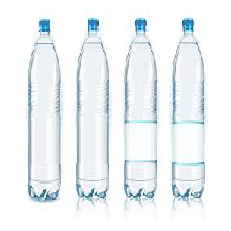

plastic  with  95.69  % accuracy
 Non - Biodegradable


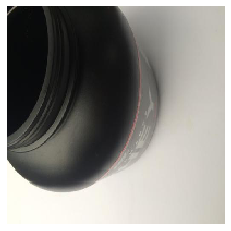

metal  with  58.14  % accuracy
 Non - Biodegradable


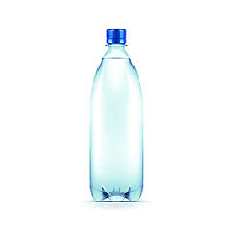

plastic  with  99.9  % accuracy
 Non - Biodegradable


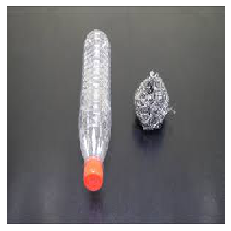

compost  with  27.58  % accuracy
 Biodegradable


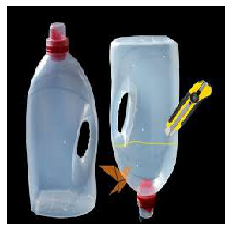

plastic  with  3.01  % accuracy
 Non - Biodegradable


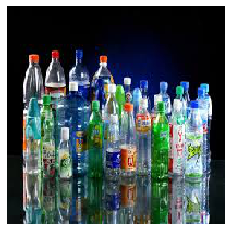

plastic  with  77.03  % accuracy
 Non - Biodegradable


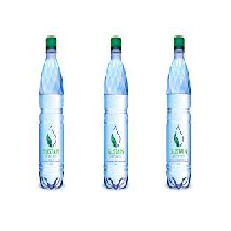

plastic  with  99.98  % accuracy
 Non - Biodegradable


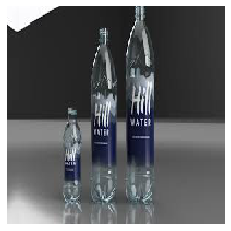

white-glass  with  55.29  % accuracy
 Non - Biodegradable


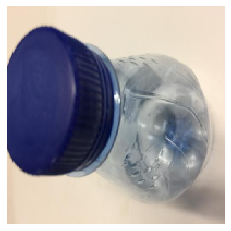

compost  with  31.39  % accuracy
 Biodegradable


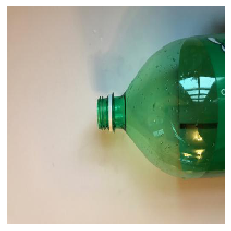

plastic  with  12.95  % accuracy
 Non - Biodegradable


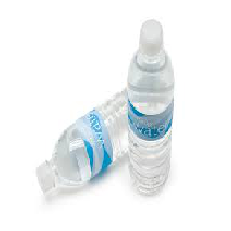

plastic  with  89.62  % accuracy
 Non - Biodegradable


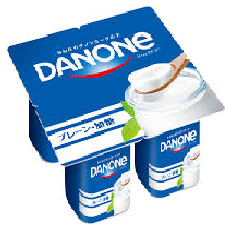

plastic  with  70.42  % accuracy
 Non - Biodegradable


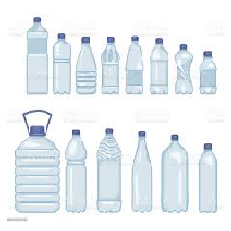

plastic  with  68.8  % accuracy
 Non - Biodegradable


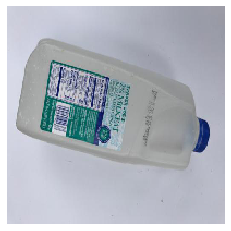

plastic  with  96.67  % accuracy
 Non - Biodegradable


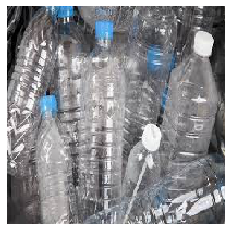

compost  with  2.52  % accuracy
 Biodegradable


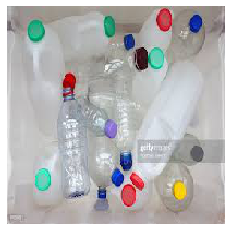

plastic  with  71.45  % accuracy
 Non - Biodegradable


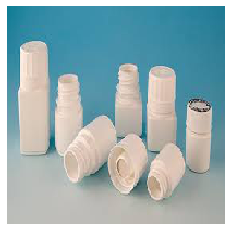

compost  with  55.76  % accuracy
 Biodegradable


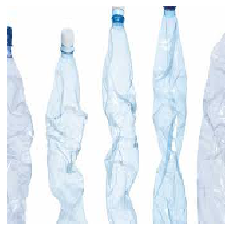

plastic  with  95.92  % accuracy
 Non - Biodegradable


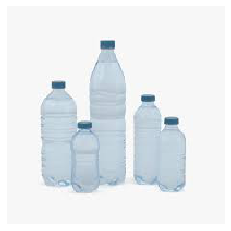

plastic  with  96.01  % accuracy
 Non - Biodegradable


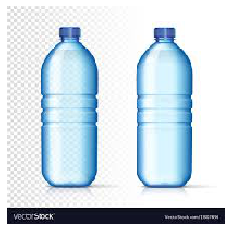

plastic  with  99.24  % accuracy
 Non - Biodegradable


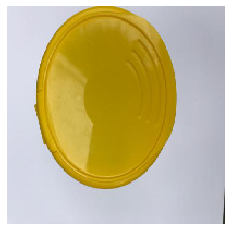

compost  with  35.57  % accuracy
 Biodegradable


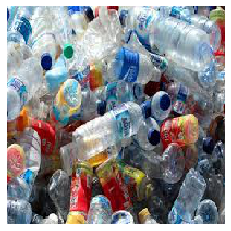

compost  with  82.81  % accuracy
 Biodegradable


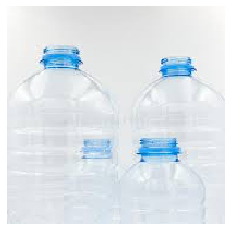

plastic  with  36.41  % accuracy
 Non - Biodegradable


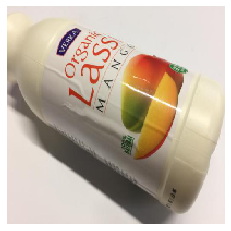

paper  with  12.0  % accuracy
 Biodegradable


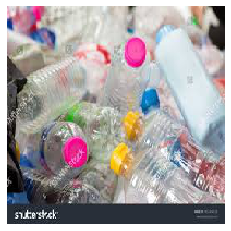

compost  with  45.15  % accuracy
 Biodegradable


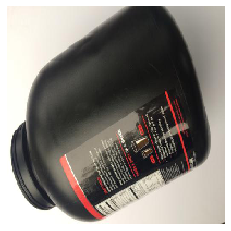

plastic  with  1.77  % accuracy
 Non - Biodegradable


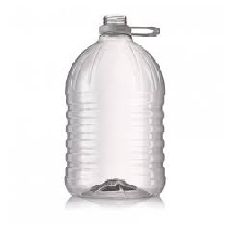

plastic  with  95.57  % accuracy
 Non - Biodegradable


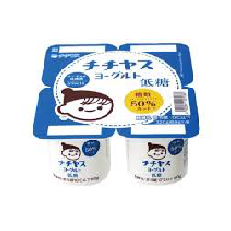

plastic  with  65.65  % accuracy
 Non - Biodegradable


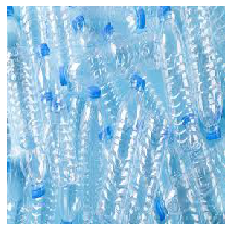

plastic  with  44.04  % accuracy
 Non - Biodegradable


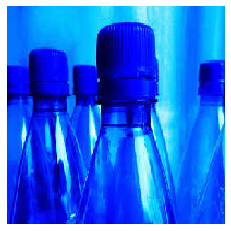

white-glass  with  9.13  % accuracy
 Non - Biodegradable


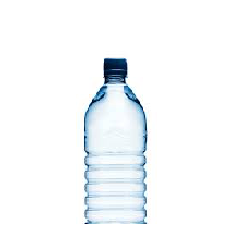

plastic  with  99.91  % accuracy
 Non - Biodegradable


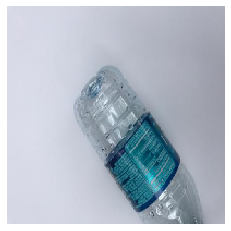

plastic  with  92.06  % accuracy
 Non - Biodegradable


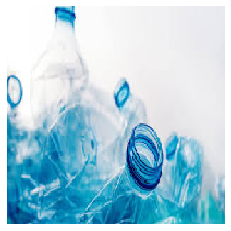

plastic  with  91.97  % accuracy
 Non - Biodegradable


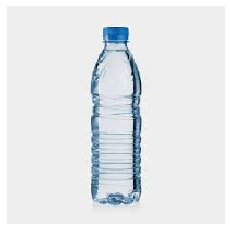

plastic  with  99.58  % accuracy
 Non - Biodegradable


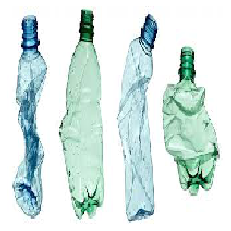

plastic  with  51.23  % accuracy
 Non - Biodegradable


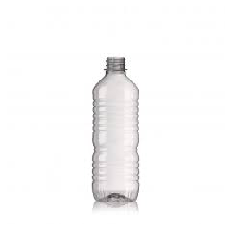

plastic  with  94.34  % accuracy
 Non - Biodegradable


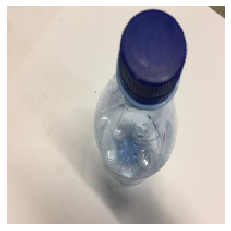

metal  with  13.78  % accuracy
 Non - Biodegradable


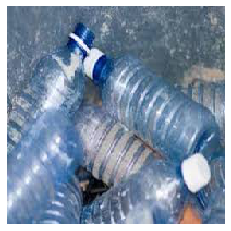

plastic  with  1.77  % accuracy
 Non - Biodegradable


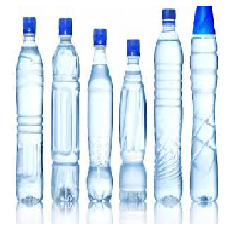

plastic  with  99.74  % accuracy
 Non - Biodegradable


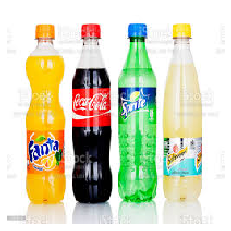

plastic  with  99.82  % accuracy
 Non - Biodegradable


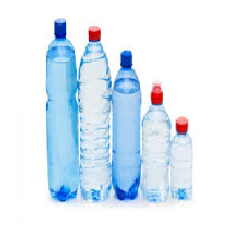

plastic  with  99.99  % accuracy
 Non - Biodegradable


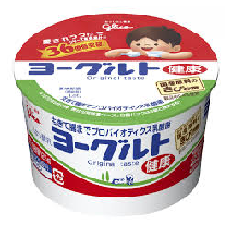

plastic  with  97.35  % accuracy
 Non - Biodegradable


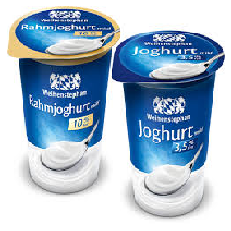

plastic  with  98.98  % accuracy
 Non - Biodegradable


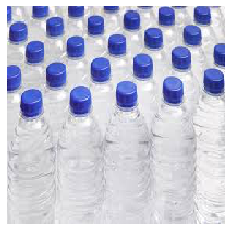

plastic  with  9.44  % accuracy
 Non - Biodegradable


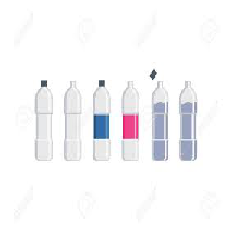

plastic  with  87.7  % accuracy
 Non - Biodegradable


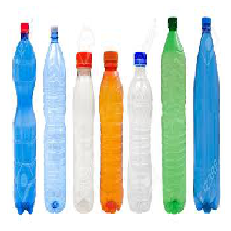

plastic  with  99.28  % accuracy
 Non - Biodegradable


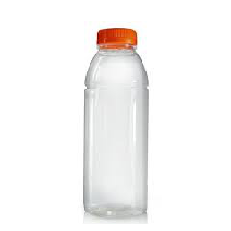

plastic  with  99.76  % accuracy
 Non - Biodegradable


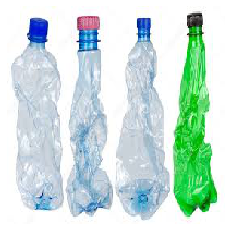

plastic  with  99.99  % accuracy
 Non - Biodegradable


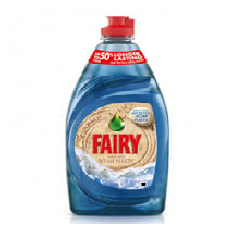

plastic  with  100.0  % accuracy
 Non - Biodegradable


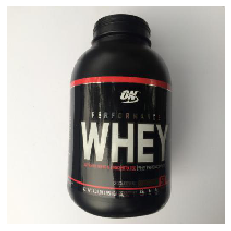

plastic  with  99.54  % accuracy
 Non - Biodegradable


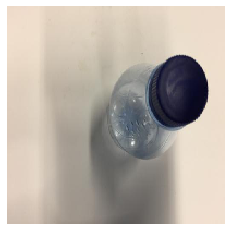

plastic  with  79.97  % accuracy
 Non - Biodegradable


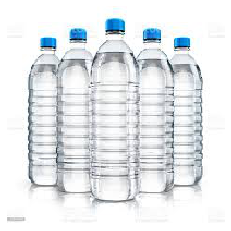

plastic  with  71.41  % accuracy
 Non - Biodegradable


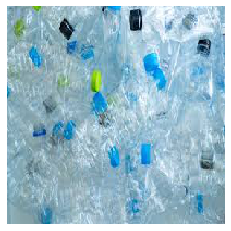

compost  with  58.43  % accuracy
 Biodegradable


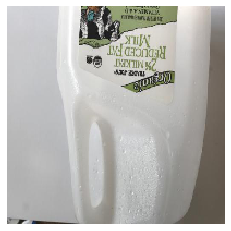

paper  with  11.23  % accuracy
 Biodegradable


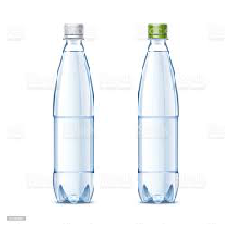

plastic  with  97.92  % accuracy
 Non - Biodegradable


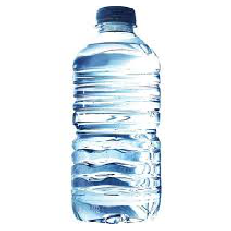

plastic  with  99.98  % accuracy
 Non - Biodegradable


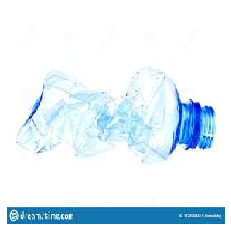

plastic  with  96.1  % accuracy
 Non - Biodegradable


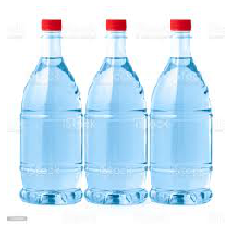

plastic  with  76.55  % accuracy
 Non - Biodegradable


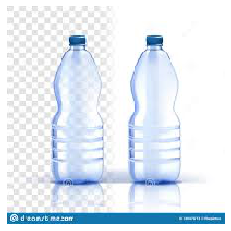

plastic  with  96.7  % accuracy
 Non - Biodegradable


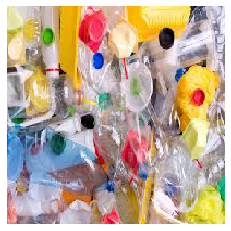

compost  with  41.66  % accuracy
 Biodegradable


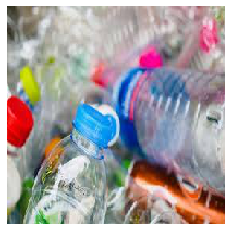

compost  with  18.58  % accuracy
 Biodegradable


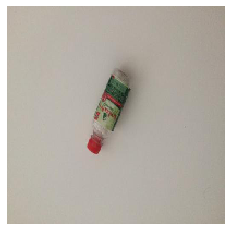

plastic  with  61.27  % accuracy
 Non - Biodegradable


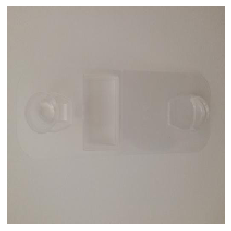

white-glass  with  80.8  % accuracy
 Non - Biodegradable


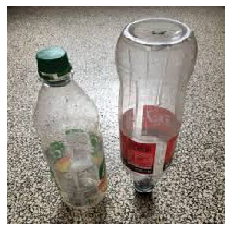

white-glass  with  64.44  % accuracy
 Non - Biodegradable


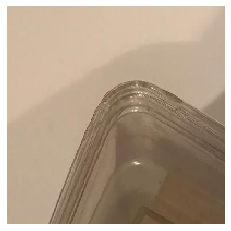

metal  with  60.65  % accuracy
 Non - Biodegradable


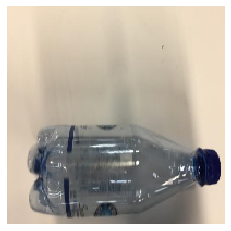

plastic  with  59.25  % accuracy
 Non - Biodegradable


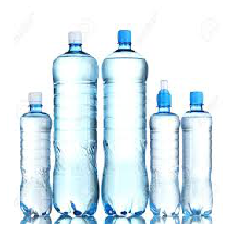

plastic  with  99.17  % accuracy
 Non - Biodegradable


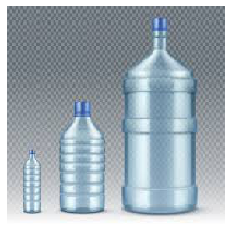

metal  with  15.69  % accuracy
 Non - Biodegradable


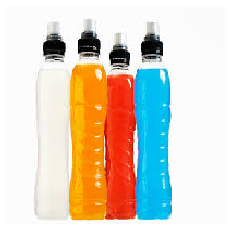

plastic  with  99.57  % accuracy
 Non - Biodegradable


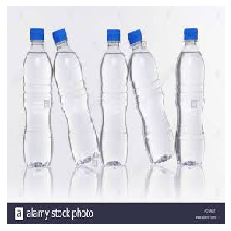

plastic  with  59.29  % accuracy
 Non - Biodegradable


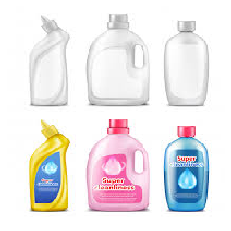

plastic  with  0.94  % accuracy
 Non - Biodegradable


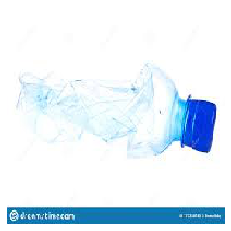

plastic  with  78.98  % accuracy
 Non - Biodegradable


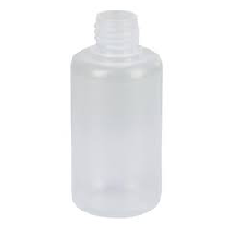

metal  with  91.07  % accuracy
 Non - Biodegradable


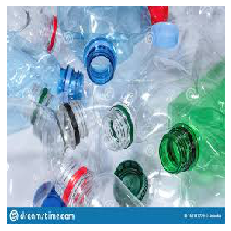

compost  with  17.33  % accuracy
 Biodegradable


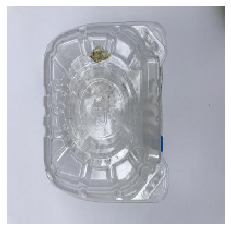

metal  with  93.5  % accuracy
 Non - Biodegradable


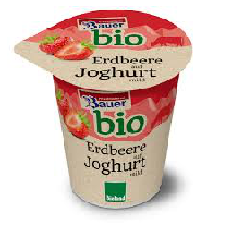

plastic  with  93.89  % accuracy
 Non - Biodegradable


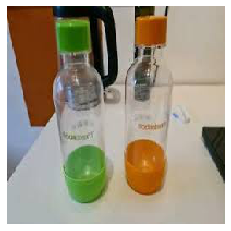

plastic  with  4.55  % accuracy
 Non - Biodegradable


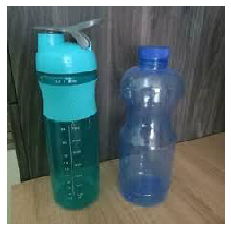

plastic  with  27.79  % accuracy
 Non - Biodegradable


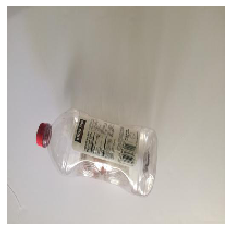

plastic  with  83.48  % accuracy
 Non - Biodegradable


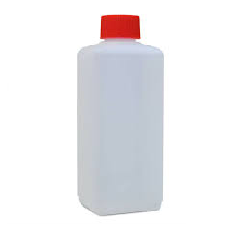

plastic  with  92.88  % accuracy
 Non - Biodegradable


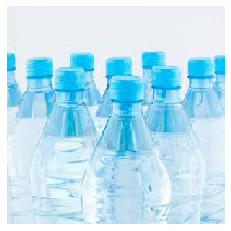

plastic  with  76.36  % accuracy
 Non - Biodegradable


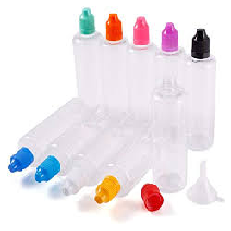

plastic  with  9.02  % accuracy
 Non - Biodegradable


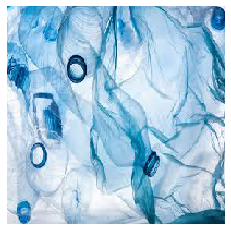

metal  with  0.1  % accuracy
 Non - Biodegradable


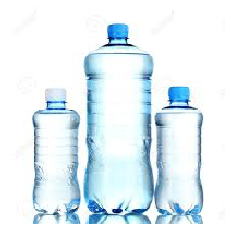

plastic  with  99.23  % accuracy
 Non - Biodegradable


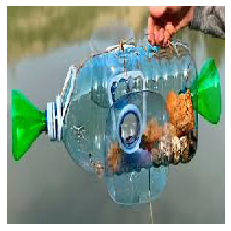

compost  with  1.66  % accuracy
 Biodegradable


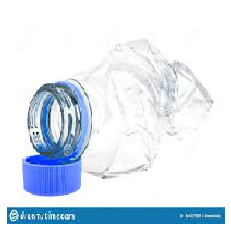

plastic  with  25.13  % accuracy
 Non - Biodegradable


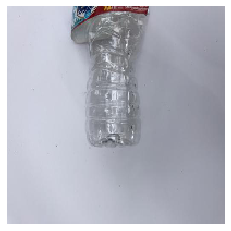

metal  with  13.55  % accuracy
 Non - Biodegradable


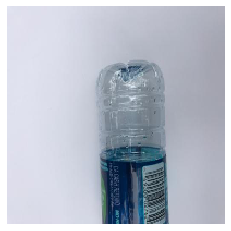

metal  with  64.87  % accuracy
 Non - Biodegradable


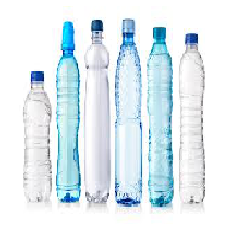

plastic  with  99.95  % accuracy
 Non - Biodegradable


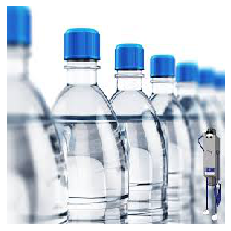

white-glass  with  4.84  % accuracy
 Non - Biodegradable


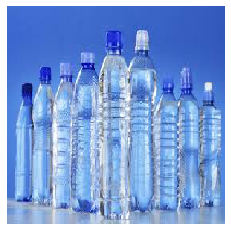

plastic  with  99.74  % accuracy
 Non - Biodegradable


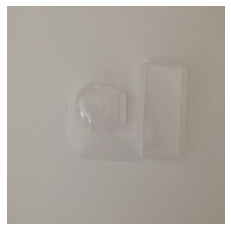

white-glass  with  86.98  % accuracy
 Non - Biodegradable


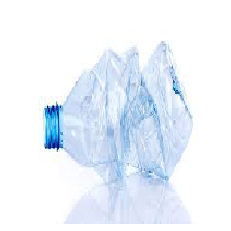

plastic  with  68.26  % accuracy
 Non - Biodegradable


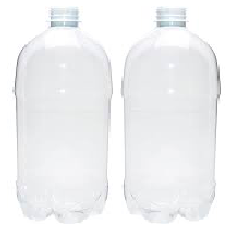

white-glass  with  96.13  % accuracy
 Non - Biodegradable


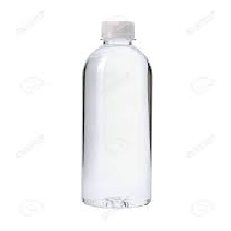

white-glass  with  99.49  % accuracy
 Non - Biodegradable


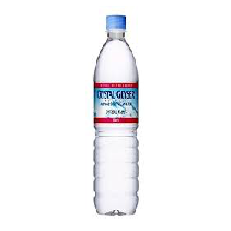

plastic  with  99.72  % accuracy
 Non - Biodegradable


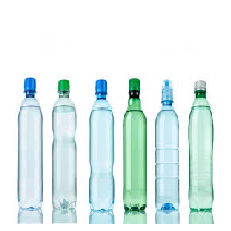

plastic  with  43.58  % accuracy
 Non - Biodegradable


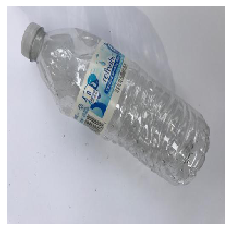

plastic  with  53.32  % accuracy
 Non - Biodegradable


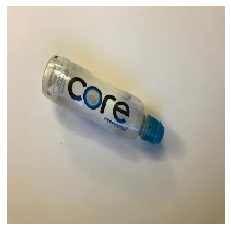

plastic  with  48.04  % accuracy
 Non - Biodegradable


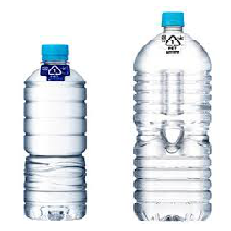

plastic  with  7.7  % accuracy
 Non - Biodegradable


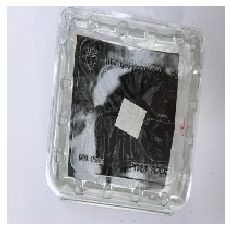

white-glass  with  17.68  % accuracy
 Non - Biodegradable


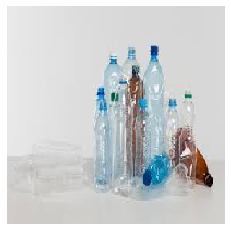

plastic  with  81.6  % accuracy
 Non - Biodegradable


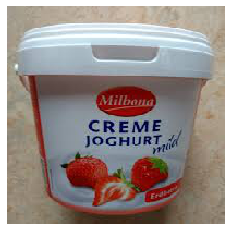

plastic  with  71.78  % accuracy
 Non - Biodegradable


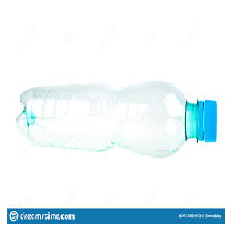

plastic  with  89.05  % accuracy
 Non - Biodegradable


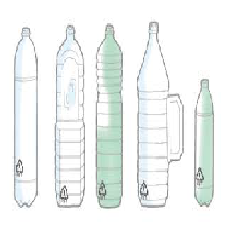

plastic  with  72.98  % accuracy
 Non - Biodegradable


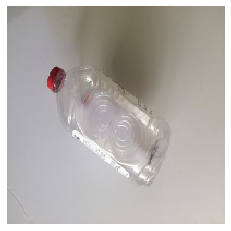

plastic  with  73.66  % accuracy
 Non - Biodegradable


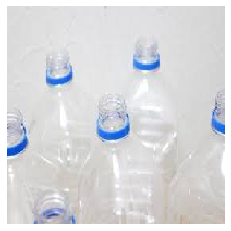

plastic  with  92.1  % accuracy
 Non - Biodegradable


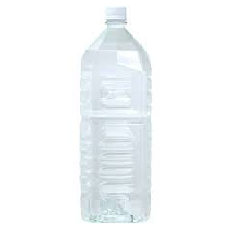

plastic  with  98.89  % accuracy
 Non - Biodegradable


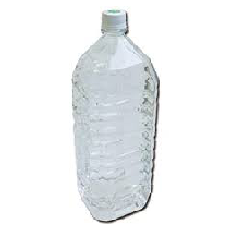

plastic  with  97.86  % accuracy
 Non - Biodegradable


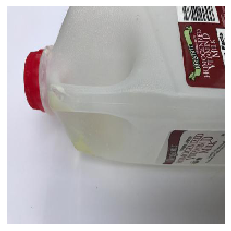

paper  with  5.61  % accuracy
 Biodegradable


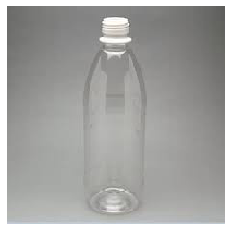

white-glass  with  98.87  % accuracy
 Non - Biodegradable


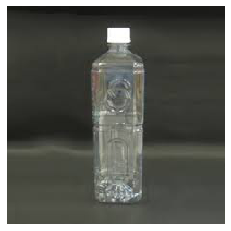

plastic  with  98.5  % accuracy
 Non - Biodegradable


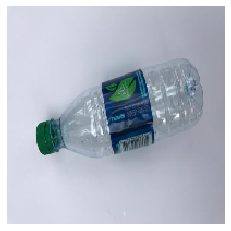

plastic  with  97.37  % accuracy
 Non - Biodegradable


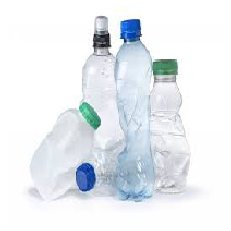

plastic  with  69.95  % accuracy
 Non - Biodegradable


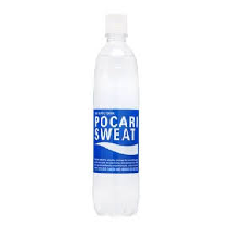

plastic  with  99.24  % accuracy
 Non - Biodegradable


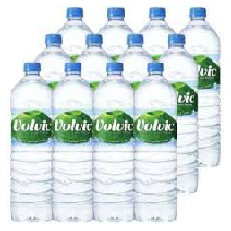

plastic  with  45.07  % accuracy
 Non - Biodegradable


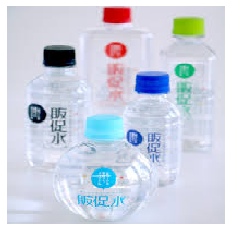

plastic  with  56.64  % accuracy
 Non - Biodegradable


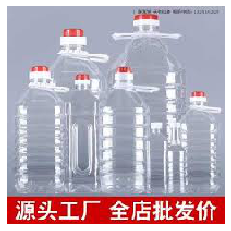

plastic  with  30.22  % accuracy
 Non - Biodegradable


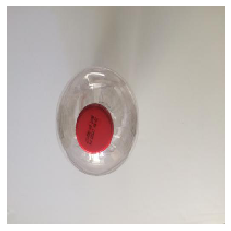

metal  with  81.89  % accuracy
 Non - Biodegradable


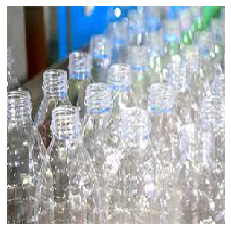

compost  with  95.51  % accuracy
 Biodegradable


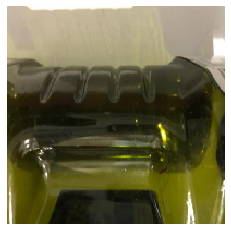

white-glass  with  11.49  % accuracy
 Non - Biodegradable


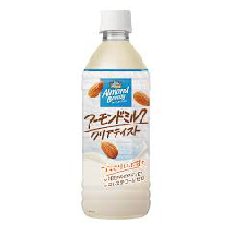

plastic  with  100.0  % accuracy
 Non - Biodegradable


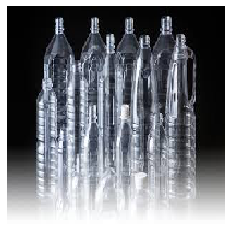

plastic  with  37.21  % accuracy
 Non - Biodegradable


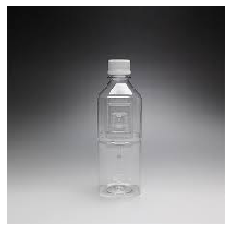

white-glass  with  97.91  % accuracy
 Non - Biodegradable


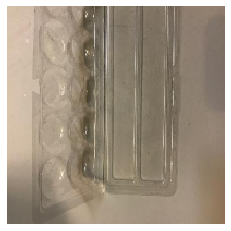

white-glass  with  85.07  % accuracy
 Non - Biodegradable


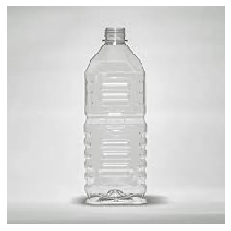

plastic  with  99.57  % accuracy
 Non - Biodegradable


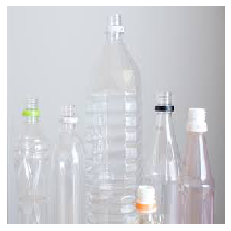

plastic  with  80.97  % accuracy
 Non - Biodegradable


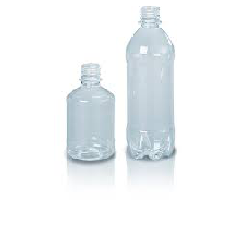

metal  with  79.56  % accuracy
 Non - Biodegradable


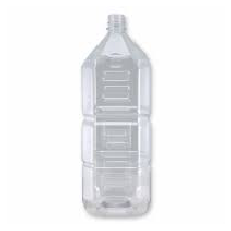

plastic  with  99.55  % accuracy
 Non - Biodegradable


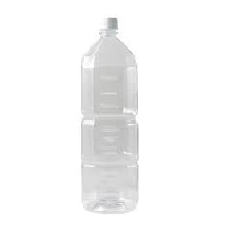

plastic  with  97.3  % accuracy
 Non - Biodegradable


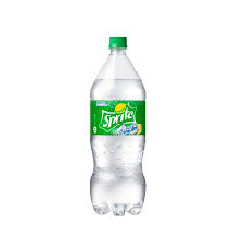

plastic  with  99.99  % accuracy
 Non - Biodegradable


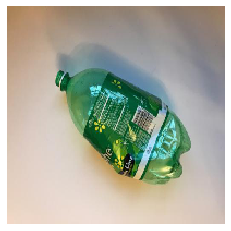

plastic  with  90.9  % accuracy
 Non - Biodegradable


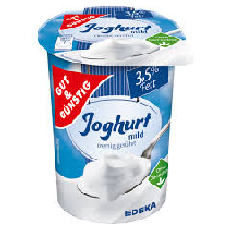

plastic  with  99.59  % accuracy
 Non - Biodegradable


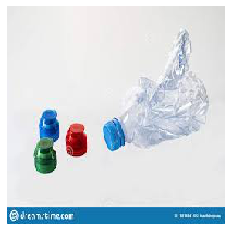

plastic  with  85.03  % accuracy
 Non - Biodegradable


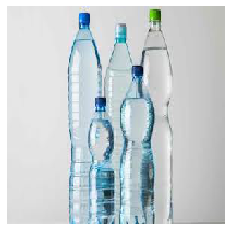

plastic  with  99.25  % accuracy
 Non - Biodegradable


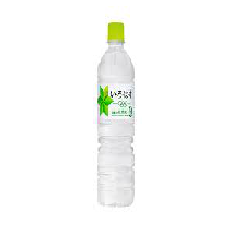

plastic  with  99.99  % accuracy
 Non - Biodegradable


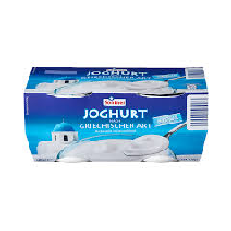

plastic  with  86.92  % accuracy
 Non - Biodegradable


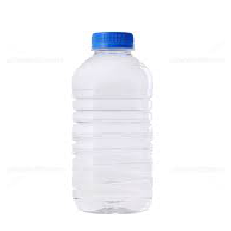

plastic  with  99.73  % accuracy
 Non - Biodegradable


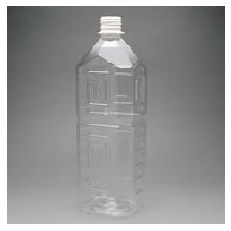

plastic  with  99.12  % accuracy
 Non - Biodegradable


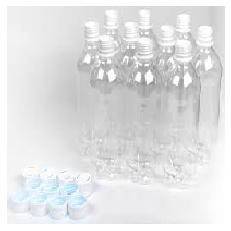

white-glass  with  64.47  % accuracy
 Non - Biodegradable


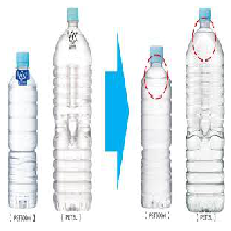

plastic  with  87.28  % accuracy
 Non - Biodegradable


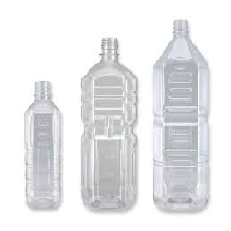

plastic  with  97.18  % accuracy
 Non - Biodegradable


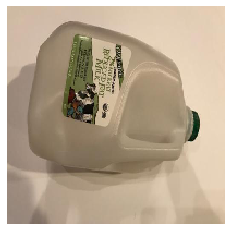

metal  with  44.23  % accuracy
 Non - Biodegradable


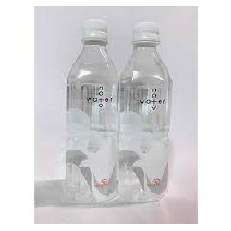

plastic  with  94.44  % accuracy
 Non - Biodegradable


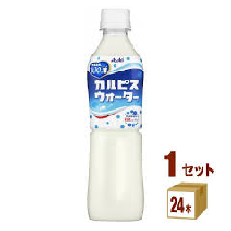

plastic  with  94.9  % accuracy
 Non - Biodegradable


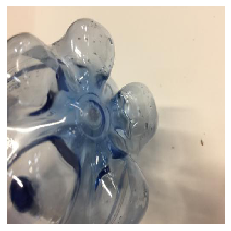

compost  with  92.65  % accuracy
 Biodegradable


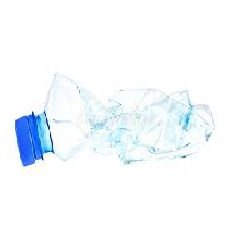

plastic  with  93.27  % accuracy
 Non - Biodegradable


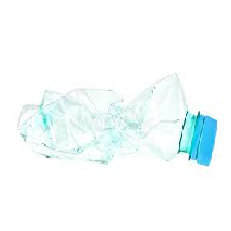

white-glass  with  62.55  % accuracy
 Non - Biodegradable


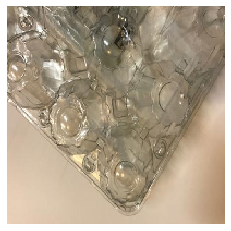

white-glass  with  4.86  % accuracy
 Non - Biodegradable


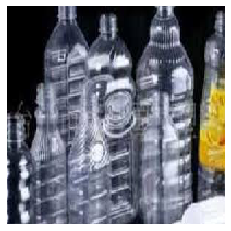

paper  with  9.38  % accuracy
 Biodegradable


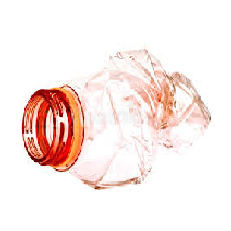

white-glass  with  2.67  % accuracy
 Non - Biodegradable


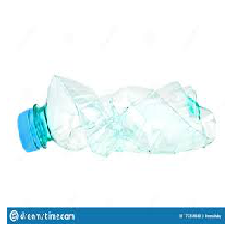

plastic  with  98.64  % accuracy
 Non - Biodegradable


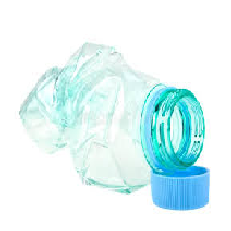

white-glass  with  30.74  % accuracy
 Non - Biodegradable


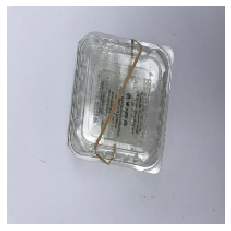

metal  with  81.67  % accuracy
 Non - Biodegradable


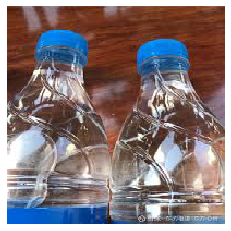

compost  with  0.0  % accuracy
 Biodegradable


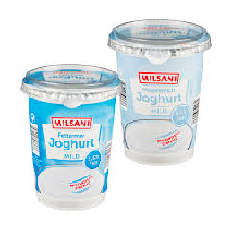

metal  with  86.88  % accuracy
 Non - Biodegradable


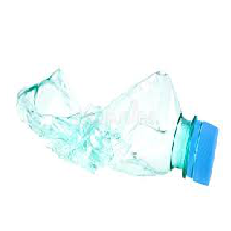

plastic  with  28.14  % accuracy
 Non - Biodegradable


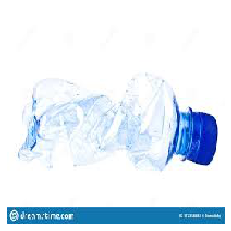

plastic  with  99.03  % accuracy
 Non - Biodegradable


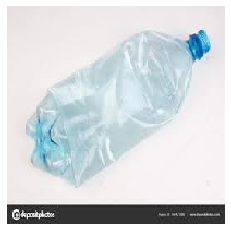

plastic  with  58.81  % accuracy
 Non - Biodegradable


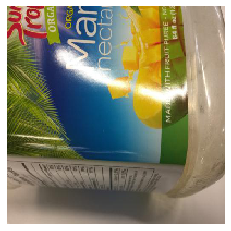

paper  with  46.31  % accuracy
 Biodegradable


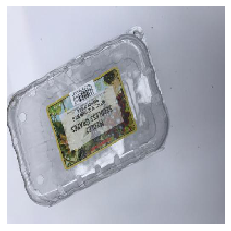

metal  with  55.52  % accuracy
 Non - Biodegradable


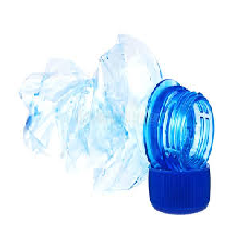

plastic  with  89.88  % accuracy
 Non - Biodegradable


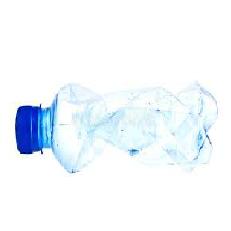

plastic  with  98.85  % accuracy
 Non - Biodegradable


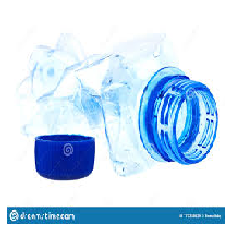

plastic  with  51.47  % accuracy
 Non - Biodegradable


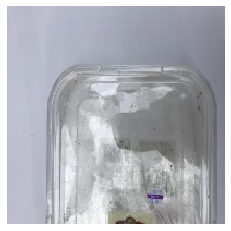

white-glass  with  47.86  % accuracy
 Non - Biodegradable


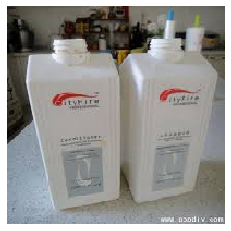

paper  with  15.89  % accuracy
 Biodegradable


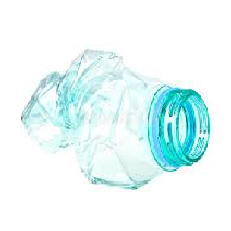

plastic  with  13.39  % accuracy
 Non - Biodegradable


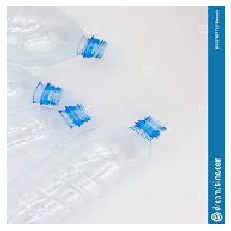

plastic  with  78.02  % accuracy
 Non - Biodegradable


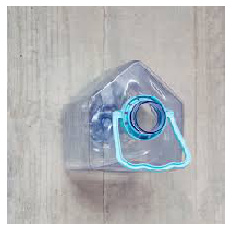

plastic  with  26.07  % accuracy
 Non - Biodegradable


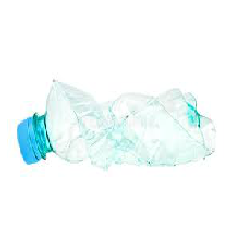

plastic  with  95.68  % accuracy
 Non - Biodegradable


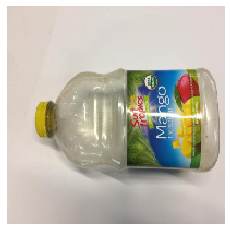

metal  with  10.12  % accuracy
 Non - Biodegradable


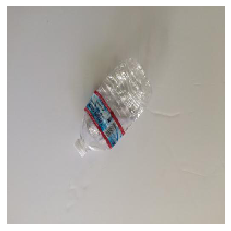

plastic  with  91.08  % accuracy
 Non - Biodegradable


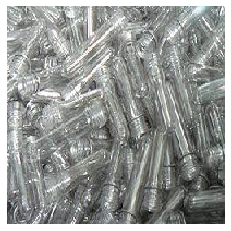

compost  with  20.62  % accuracy
 Biodegradable


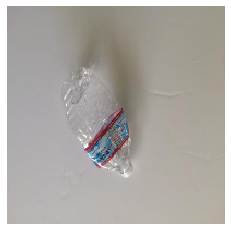

plastic  with  83.24  % accuracy
 Non - Biodegradable


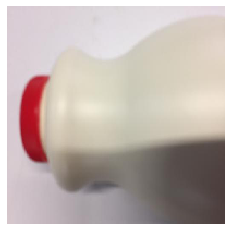

compost  with  83.65  % accuracy
 Biodegradable


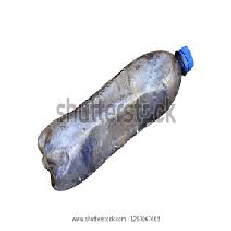

compost  with  6.98  % accuracy
 Biodegradable


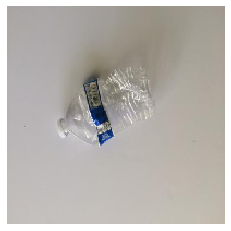

plastic  with  89.85  % accuracy
 Non - Biodegradable


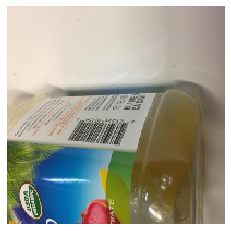

metal  with  46.91  % accuracy
 Non - Biodegradable


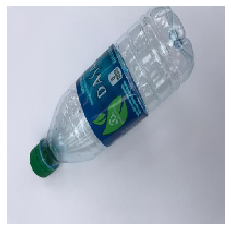

plastic  with  88.55  % accuracy
 Non - Biodegradable


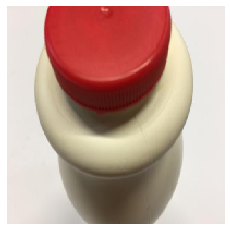

metal  with  34.9  % accuracy
 Non - Biodegradable


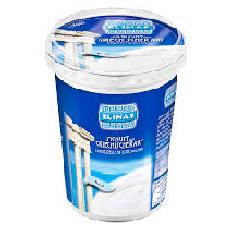

plastic  with  99.99  % accuracy
 Non - Biodegradable


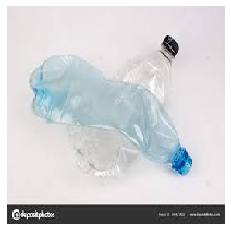

plastic  with  21.99  % accuracy
 Non - Biodegradable


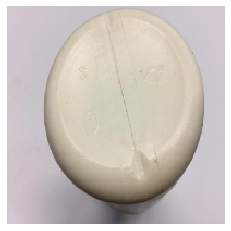

compost  with  68.8  % accuracy
 Biodegradable


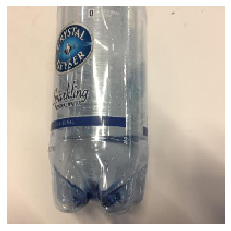

plastic  with  70.29  % accuracy
 Non - Biodegradable


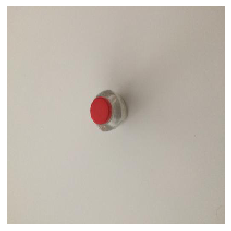

compost  with  51.05  % accuracy
 Biodegradable


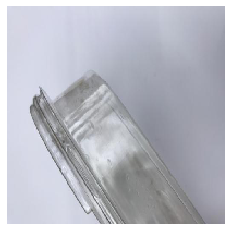

plastic  with  51.55  % accuracy
 Non - Biodegradable


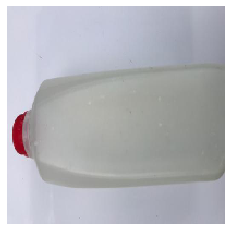

metal  with  16.84  % accuracy
 Non - Biodegradable


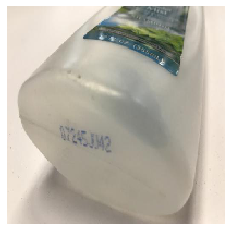

white-glass  with  7.64  % accuracy
 Non - Biodegradable


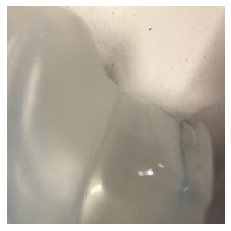

compost  with  77.94  % accuracy
 Biodegradable


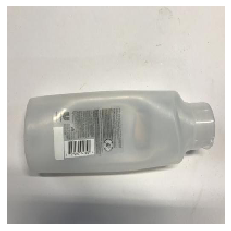

metal  with  94.08  % accuracy
 Non - Biodegradable


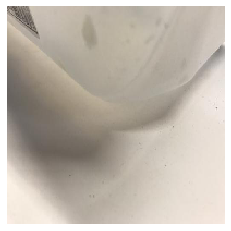

white-glass  with  79.06  % accuracy
 Non - Biodegradable


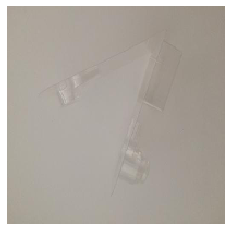

white-glass  with  86.91  % accuracy
 Non - Biodegradable


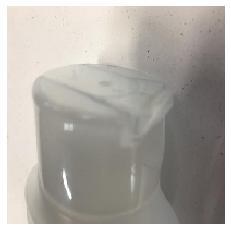

white-glass  with  82.19  % accuracy
 Non - Biodegradable


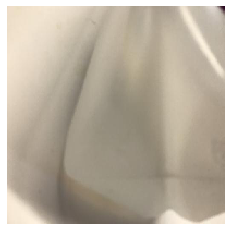

compost  with  83.18  % accuracy
 Biodegradable


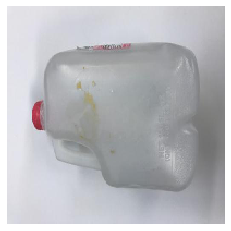

white-glass  with  56.93  % accuracy
 Non - Biodegradable


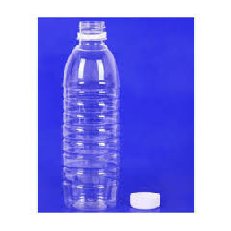

plastic  with  99.59  % accuracy
 Non - Biodegradable


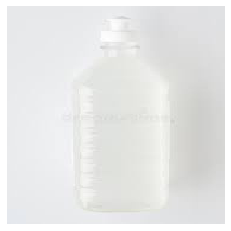

white-glass  with  86.04  % accuracy
 Non - Biodegradable


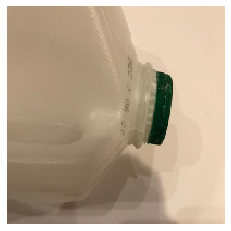

compost  with  21.44  % accuracy
 Biodegradable


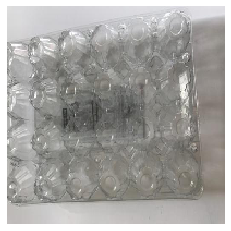

metal  with  52.97  % accuracy
 Non - Biodegradable


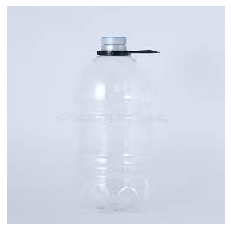

white-glass  with  96.8  % accuracy
 Non - Biodegradable


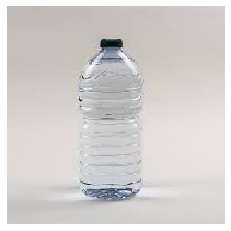

plastic  with  99.55  % accuracy
 Non - Biodegradable


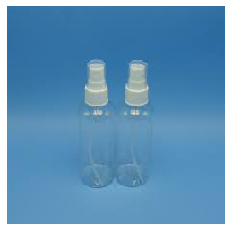

plastic  with  97.76  % accuracy
 Non - Biodegradable


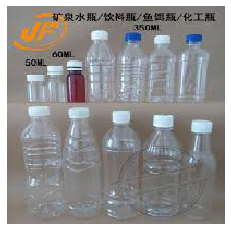

paper  with  13.44  % accuracy
 Biodegradable


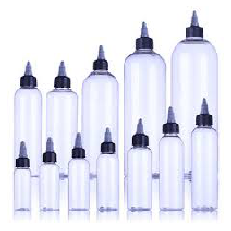

plastic  with  93.41  % accuracy
 Non - Biodegradable


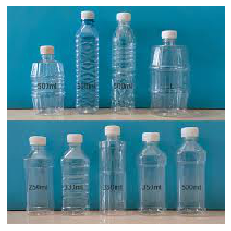

plastic  with  97.92  % accuracy
 Non - Biodegradable


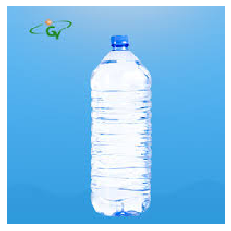

plastic  with  100.0  % accuracy
 Non - Biodegradable


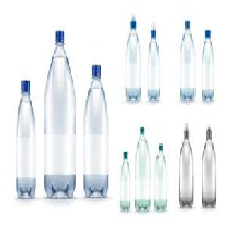

plastic  with  95.77  % accuracy
 Non - Biodegradable


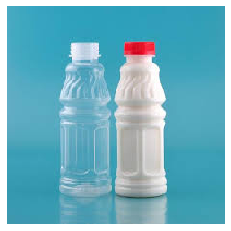

plastic  with  100.0  % accuracy
 Non - Biodegradable


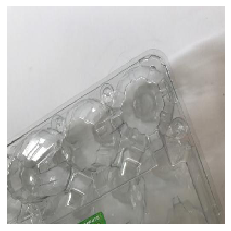

white-glass  with  66.03  % accuracy
 Non - Biodegradable


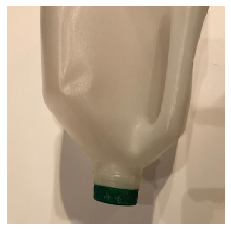

white-glass  with  89.91  % accuracy
 Non - Biodegradable


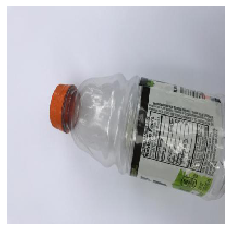

plastic  with  97.16  % accuracy
 Non - Biodegradable


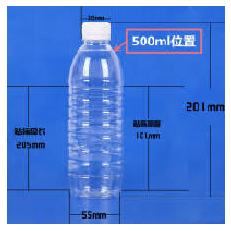

plastic  with  99.91  % accuracy
 Non - Biodegradable


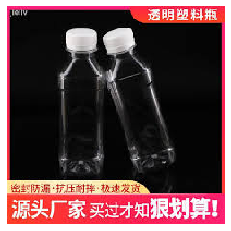

plastic  with  26.94  % accuracy
 Non - Biodegradable


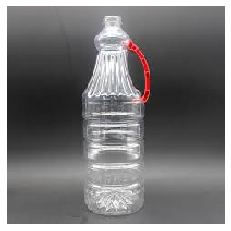

plastic  with  99.98  % accuracy
 Non - Biodegradable


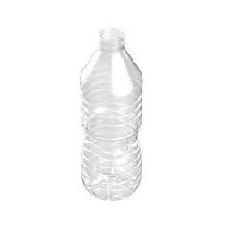

plastic  with  96.27  % accuracy
 Non - Biodegradable


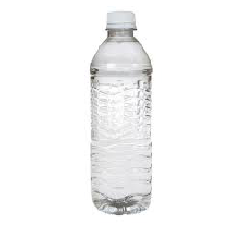

plastic  with  99.92  % accuracy
 Non - Biodegradable


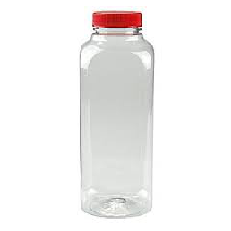

white-glass  with  99.95  % accuracy
 Non - Biodegradable


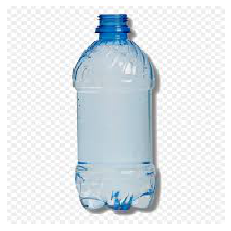

plastic  with  99.96  % accuracy
 Non - Biodegradable


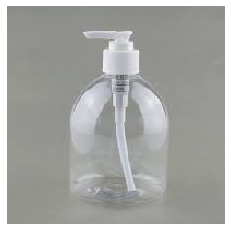

white-glass  with  90.97  % accuracy
 Non - Biodegradable


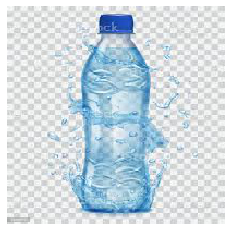

plastic  with  84.44  % accuracy
 Non - Biodegradable


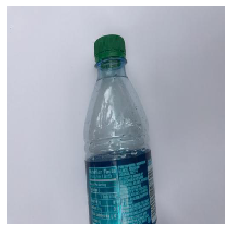

plastic  with  99.91  % accuracy
 Non - Biodegradable


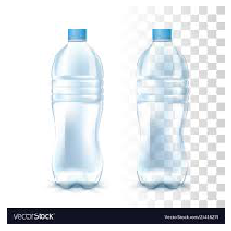

plastic  with  95.15  % accuracy
 Non - Biodegradable


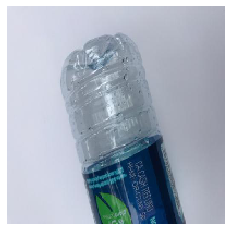

plastic  with  54.96  % accuracy
 Non - Biodegradable


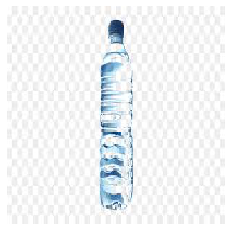

plastic  with  86.67  % accuracy
 Non - Biodegradable


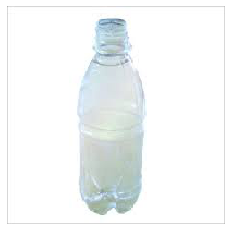

plastic  with  98.52  % accuracy
 Non - Biodegradable


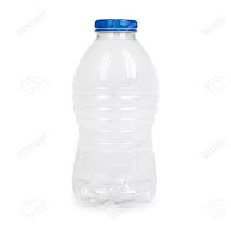

plastic  with  99.83  % accuracy
 Non - Biodegradable


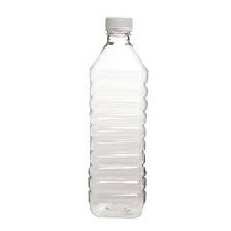

white-glass  with  98.41  % accuracy
 Non - Biodegradable


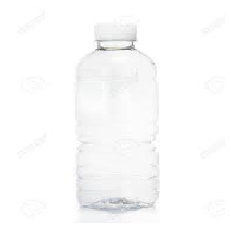

white-glass  with  99.58  % accuracy
 Non - Biodegradable


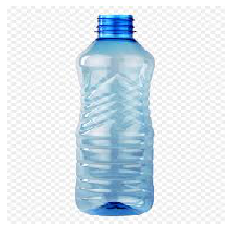

plastic  with  100.0  % accuracy
 Non - Biodegradable


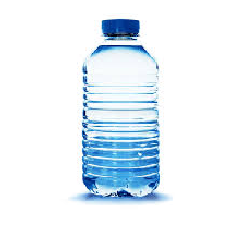

plastic  with  99.98  % accuracy
 Non - Biodegradable


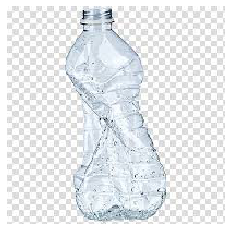

paper  with  47.36  % accuracy
 Biodegradable


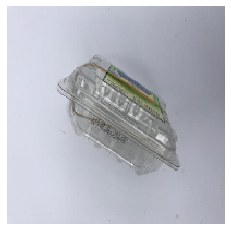

metal  with  56.8  % accuracy
 Non - Biodegradable


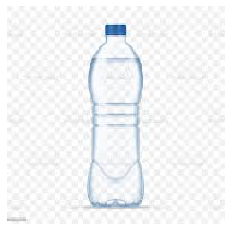

plastic  with  95.35  % accuracy
 Non - Biodegradable


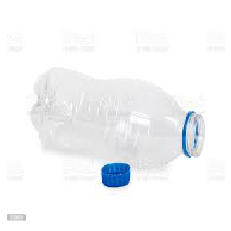

plastic  with  85.91  % accuracy
 Non - Biodegradable


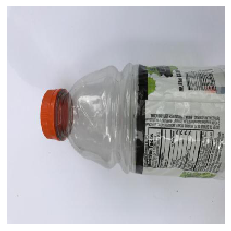

plastic  with  82.86  % accuracy
 Non - Biodegradable


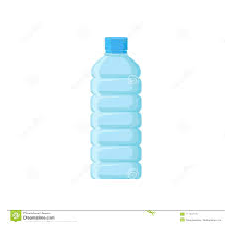

plastic  with  100.0  % accuracy
 Non - Biodegradable


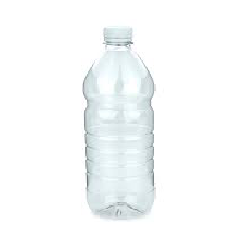

plastic  with  94.55  % accuracy
 Non - Biodegradable


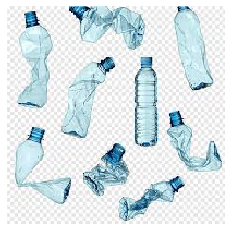

plastic  with  1.85  % accuracy
 Non - Biodegradable


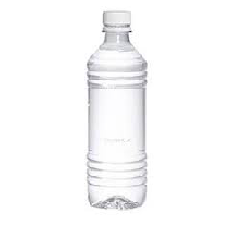

plastic  with  99.62  % accuracy
 Non - Biodegradable


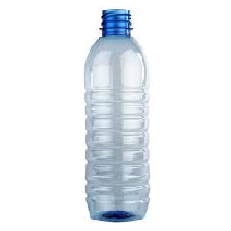

plastic  with  99.99  % accuracy
 Non - Biodegradable


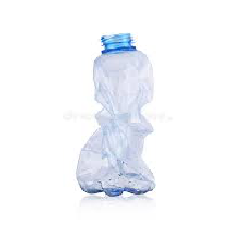

plastic  with  96.89  % accuracy
 Non - Biodegradable


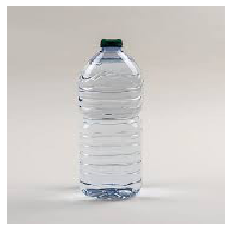

plastic  with  99.54  % accuracy
 Non - Biodegradable


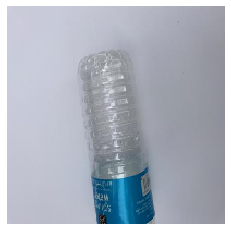

white-glass  with  99.48  % accuracy
 Non - Biodegradable


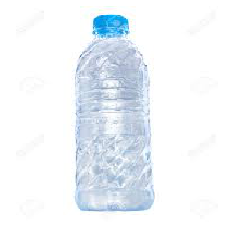

plastic  with  99.93  % accuracy
 Non - Biodegradable


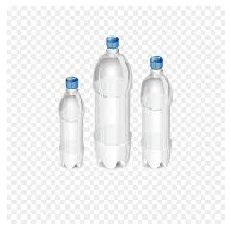

plastic  with  40.88  % accuracy
 Non - Biodegradable


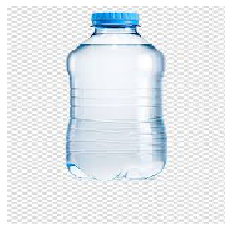

plastic  with  97.4  % accuracy
 Non - Biodegradable


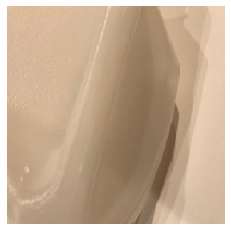

white-glass  with  36.79  % accuracy
 Non - Biodegradable


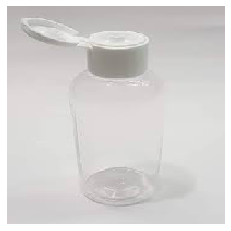

white-glass  with  99.8  % accuracy
 Non - Biodegradable


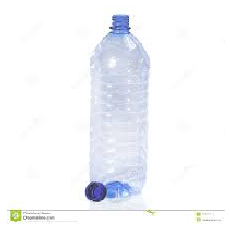

plastic  with  99.81  % accuracy
 Non - Biodegradable


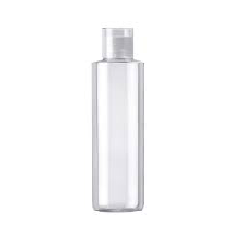

white-glass  with  99.76  % accuracy
 Non - Biodegradable


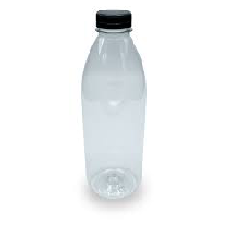

plastic  with  98.44  % accuracy
 Non - Biodegradable


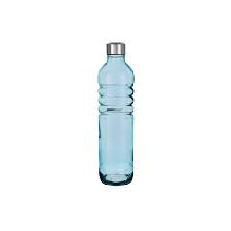

plastic  with  99.56  % accuracy
 Non - Biodegradable


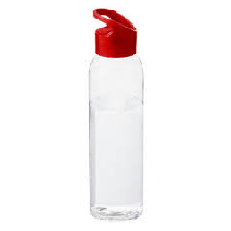

white-glass  with  99.54  % accuracy
 Non - Biodegradable


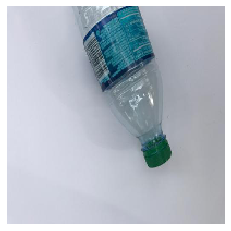

plastic  with  81.95  % accuracy
 Non - Biodegradable


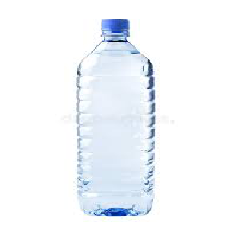

plastic  with  99.69  % accuracy
 Non - Biodegradable


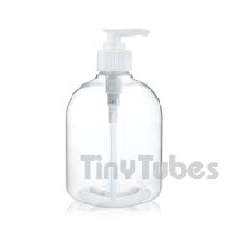

white-glass  with  99.63  % accuracy
 Non - Biodegradable


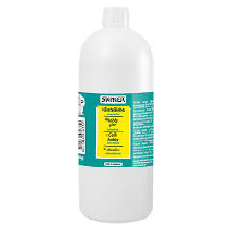

plastic  with  99.23  % accuracy
 Non - Biodegradable


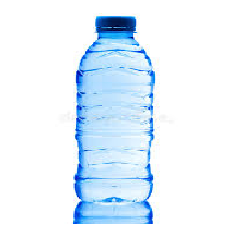

plastic  with  99.97  % accuracy
 Non - Biodegradable


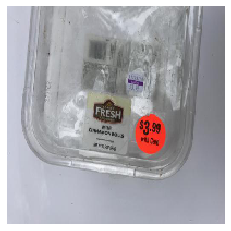

plastic  with  2.62  % accuracy
 Non - Biodegradable


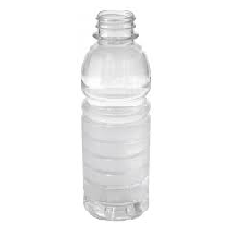

plastic  with  99.72  % accuracy
 Non - Biodegradable


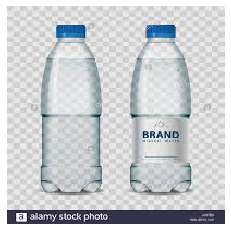

plastic  with  76.11  % accuracy
 Non - Biodegradable


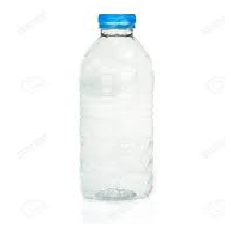

plastic  with  99.87  % accuracy
 Non - Biodegradable


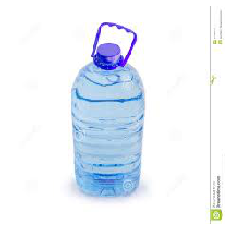

plastic  with  99.94  % accuracy
 Non - Biodegradable


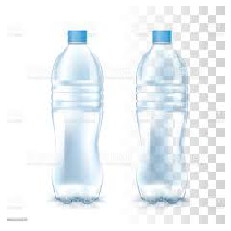

plastic  with  94.68  % accuracy
 Non - Biodegradable


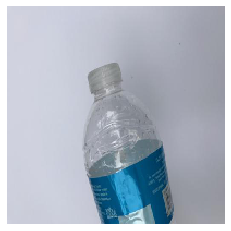

white-glass  with  88.96  % accuracy
 Non - Biodegradable


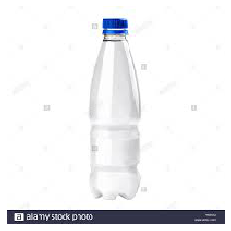

plastic  with  99.32  % accuracy
 Non - Biodegradable


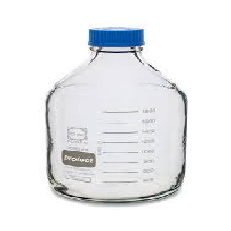

white-glass  with  98.96  % accuracy
 Non - Biodegradable


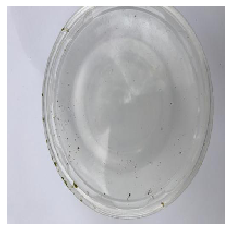

white-glass  with  77.13  % accuracy
 Non - Biodegradable


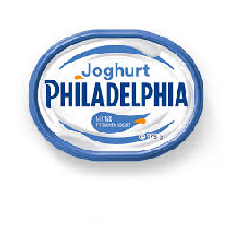

plastic  with  17.1  % accuracy
 Non - Biodegradable


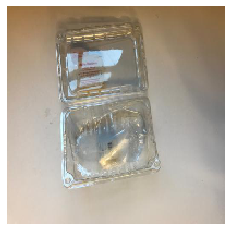

plastic  with  48.86  % accuracy
 Non - Biodegradable


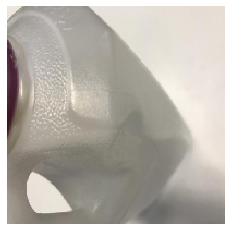

white-glass  with  9.99  % accuracy
 Non - Biodegradable


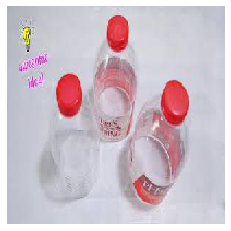

plastic  with  83.09  % accuracy
 Non - Biodegradable


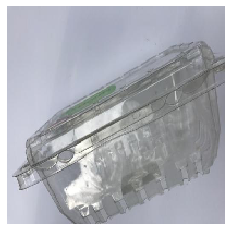

white-glass  with  28.42  % accuracy
 Non - Biodegradable


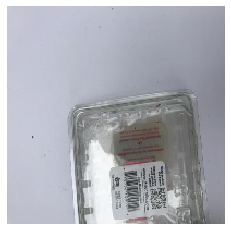

metal  with  49.27  % accuracy
 Non - Biodegradable


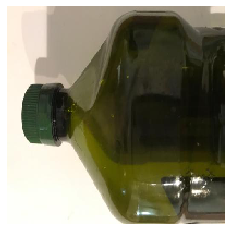

white-glass  with  6.6  % accuracy
 Non - Biodegradable


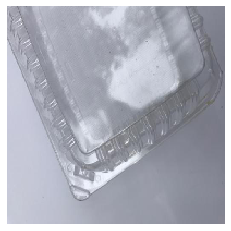

plastic  with  45.04  % accuracy
 Non - Biodegradable


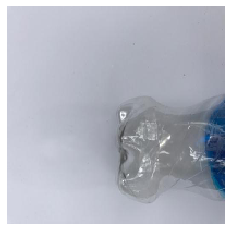

white-glass  with  93.24  % accuracy
 Non - Biodegradable


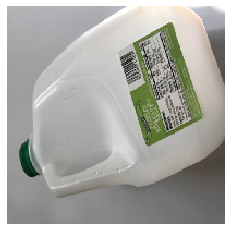

metal  with  48.89  % accuracy
 Non - Biodegradable


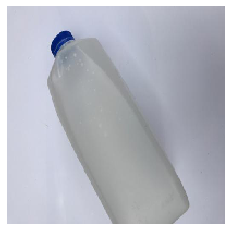

paper  with  6.55  % accuracy
 Biodegradable


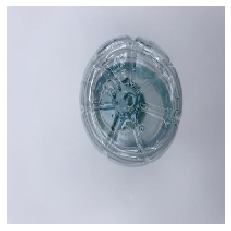

white-glass  with  76.89  % accuracy
 Non - Biodegradable


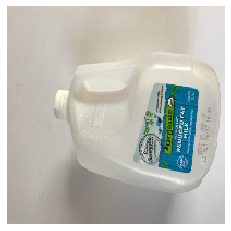

metal  with  63.59  % accuracy
 Non - Biodegradable


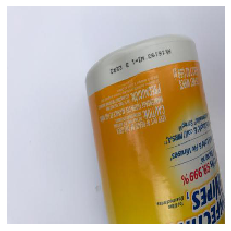

metal  with  99.09  % accuracy
 Non - Biodegradable


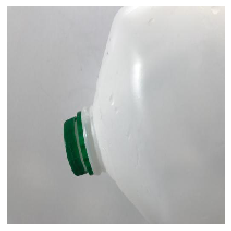

plastic  with  66.86  % accuracy
 Non - Biodegradable


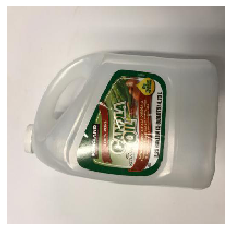

metal  with  98.86  % accuracy
 Non - Biodegradable


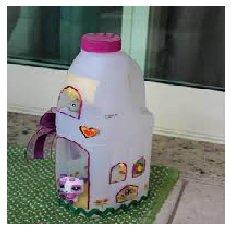

plastic  with  29.2  % accuracy
 Non - Biodegradable


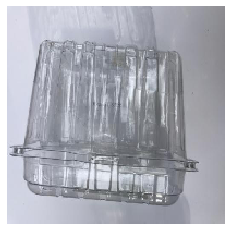

white-glass  with  61.05  % accuracy
 Non - Biodegradable


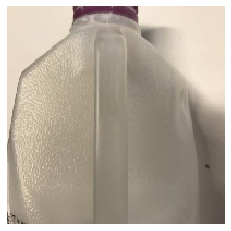

white-glass  with  6.72  % accuracy
 Non - Biodegradable


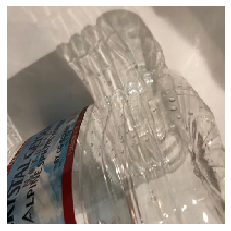

compost  with  5.89  % accuracy
 Biodegradable


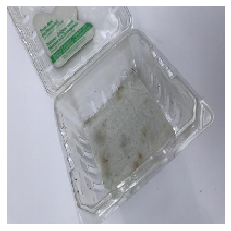

white-glass  with  68.41  % accuracy
 Non - Biodegradable


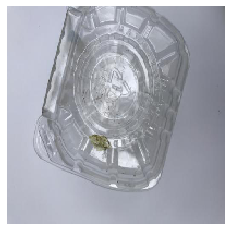

metal  with  85.76  % accuracy
 Non - Biodegradable


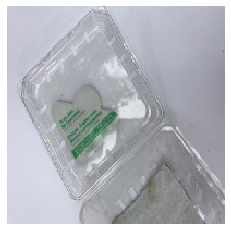

metal  with  26.87  % accuracy
 Non - Biodegradable


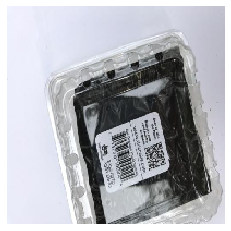

metal  with  21.91  % accuracy
 Non - Biodegradable


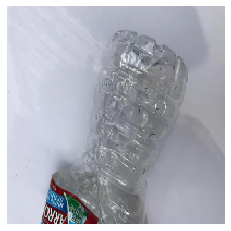

metal  with  76.53  % accuracy
 Non - Biodegradable


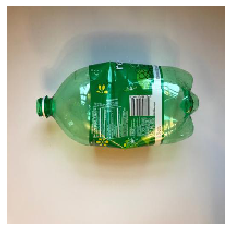

plastic  with  52.18  % accuracy
 Non - Biodegradable


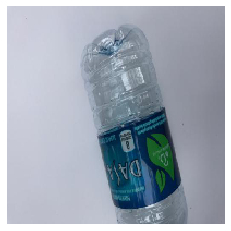

plastic  with  98.7  % accuracy
 Non - Biodegradable


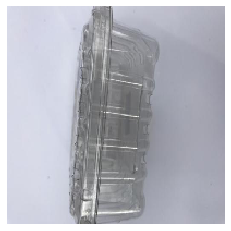

white-glass  with  92.79  % accuracy
 Non - Biodegradable


In [41]:
from tensorflow.keras.preprocessing import image
output_class = ['compost', 'metal', 'paper', 'plastic', 'white-glass']
dir_path = 'train1/plastic'
#def waste_prediction(new_image):
for i in os.listdir(dir_path):
    test_image = image.load_img(dir_path+'//'+i, target_size = (200,200))
    plt.axis("off")
    plt.imshow(test_image)
    plt.show()
 
    test_image = image.img_to_array(test_image) / 255
    test_image = np.expand_dims(test_image, axis=0)

    predicted_array = model.predict(test_image)
    predicted_value = output_class[np.argmax(predicted_array)]
    predicted_accuracy = round(np.max(predicted_array) * 100, 2)

    print(predicted_value, " with ", predicted_accuracy, " % accuracy")
    if predicted_value in ['compost', 'paper']:
        print(" Biodegradable")
    else:
        print(" Non - Biodegradable")

## Webcam Stuff

In [48]:
cap = cv2.VideoCapture(1)
cap.set(3,200) #Camera Parameter
cap.set(4,200)
#count=1
while True:
    success, web = cap.read()
    cv2.imshow("Web Cam",web)
    path = 'test1'
    k = cv2.waitKey(1)
    #if k%256 == 27:
     #   break
    if k%256 == 32:
        cv2.imwrite(os.path.join(path , 'imgT.jpg'),web)
        print('taken')
        break
cap.release()
cv2.destroyAllWindows()

error: OpenCV(4.3.0) C:\projects\opencv-python\opencv\modules\highgui\src\window.cpp:376: error: (-215:Assertion failed) size.width>0 && size.height>0 in function 'cv::imshow'


## Results

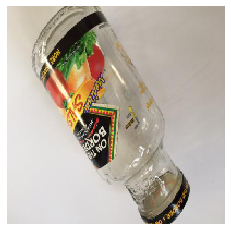

white-glass  with  5.09  % accuracy
 Non - Biodegradable


In [46]:
dir_path = 'train1'
waste_prediction('train1/white-glass/white-glass27.jpg')

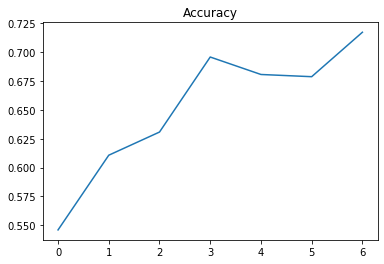

In [42]:
plt.title("Accuracy")
plt.plot(result.history["accuracy"])
plt.show()

In [43]:
keras_file = "WasteClassification.h5"
tf.keras.models.save_model(model,keras_file)

In [44]:
from tensorflow import lite
converter = lite.TFLiteConverter.from_keras_model(model)
tfmodel = converter.convert()
open('WasteClassification.tflite', 'wb').write(tfmodel)

INFO:tensorflow:Assets written to: C:\Users\GAURISHA\AppData\Local\Temp\tmp_rzk40gm\assets


59236204

In [ ]:
model.export('WasteClassification.tflite', 'imageLabels.txt')